In [1]:
#Read images
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
#import pillow
from PIL import Image

In [3]:
!pip install segmentation-models-pytorch

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 3.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.3/121.3 kB 6.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.7 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.6 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 8.1 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 29.6 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.5 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.4 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 82.7 MB/s eta 0:00:00:00:0100:01
  Created wheel for efficientnet-pytorch: filename=efficientnet_pytorch-0.7.1-py3-none-any.whl size=16424 sha256=4547a

In [2]:
import torch
import torch.nn as nn
import segmentation_models_pytorch as smp


In [3]:
# upload folder from drive
drive_folder_path = '/content/drive/MyDrive/counting_cells_data'
train_image_folder = '/kaggle/input/counting-cells/counting_cells_data/train_images'
train_label_folder = '/kaggle/input/counting-cells/counting_cells_data/train_labels'
val_image_folder = '/kaggle/input/counting-cells/counting_cells_data/val_images'
val_label_folder = '/kaggle/input/counting-cells/counting_cells_data/val_labels'

train_image_paths = [os.path.join(train_image_folder, fname) for fname in sorted(os.listdir(train_image_folder))]
train_label_paths = [os.path.join(train_label_folder, fname) for fname in sorted(os.listdir(train_label_folder))]
val_image_paths = [os.path.join(val_image_folder, fname) for fname in sorted(os.listdir(val_image_folder))]
val_label_paths = [os.path.join(val_label_folder, fname) for fname in sorted(os.listdir(val_label_folder))]

In [ ]:
import torch
from torch.utils.data import Dataset, DataLoader
import cv2
import numpy as np
import torchvision.transforms.functional as TF
import random
from torchvision import transforms
from scipy.ndimage import gaussian_filter
from PIL import Image
import matplotlib.pyplot as plt
import argparse
import os
from pathlib import Path


import random, numpy as np, torch
seed = 42
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False



def get_image_label_pairs(images_dir, labels_dir, ext='.png'):
    images_dir = Path(images_dir)
    labels_dir = Path(labels_dir)

    # build a map: prefix → label path, where prefix is e.g. '001'
    label_map = {
        p.stem[:3]: p
        for p in labels_dir.glob(f'*{ext}')
    }

    pairs = []
    for img_path in sorted(images_dir.glob(f'*{ext}')):
        prefix = img_path.stem[:3]        # '001'
        lbl_path = label_map.get(prefix)
        if lbl_path is None:
            raise FileNotFoundError(f"No label for image {img_path.name}")
        print(f"[PAIR DEBUG] {img_path.name}  ↔  {lbl_path.name}")
        pairs.append((str(img_path), str(lbl_path)))

    return pairs


class QuarterShuffle:
    def __init__(self, p=0.5):
        self.p = p

    def shuffle(self, img, idx=None):
        """
        Shuffle quarters of the image (optionally using a fixed idx).
        """
        if random.random() > self.p and idx is None:
            if isinstance(img, Image.Image):
                img = TF.to_tensor(img)
            return img, [0,1,2,3]  # Always return a tuple (tensor, identity_idx)


        if isinstance(img, Image.Image):
            img = TF.to_tensor(img)

        C, H, W = img.shape
        h_half, w_half = H // 2, W // 2

        UL = img[:, :h_half, :w_half].clone()
        UR = img[:, :h_half, w_half:].clone()
        LL = img[:, h_half:, :w_half].clone()
        LR = img[:, h_half:, w_half:].clone()

        quarters = [UL, UR, LL, LR]

        if idx is None:
            if random.random() > self.p:
                # No shuffle, return identity
                idx = [0, 1, 2, 3]
            else:
                idx = list(range(4))
                random.shuffle(idx)

        top = torch.cat([quarters[idx[0]], quarters[idx[1]]], dim=2)
        bottom = torch.cat([quarters[idx[2]], quarters[idx[3]]], dim=2)
        shuffled = torch.cat([top, bottom], dim=1)

        return shuffled, idx


class CellCountingDataset(Dataset):
    def __init__(self, image_paths, label_paths, mode='train', img_transform=None, gt = True, qt = True):
        self.image_paths = image_paths
        self.label_paths = label_paths
        self.mode = mode  # 'train' or 'val'
        self.gt = gt
        self.qt = qt

        # Set transforms
        self.img_transform = img_transform or self._get_img_transform()

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        # --- Load image and dot mask ---
        image = cv2.imread(self.image_paths[idx])
        #print(f"[DEBUG] Loading image: {self.image_paths[idx]}")
        #print(f"[DEBUG] Image shape: {image.shape}")
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = Image.fromarray(image)

        dot_mask = cv2.imread(self.label_paths[idx])
        density_map = self._generate_density_map(dot_mask)
        dot_mask = cv2.cvtColor(dot_mask, cv2.COLOR_BGR2RGB)
        dot_mask = Image.fromarray(dot_mask)

        density_map = Image.fromarray(density_map.astype(np.float32), mode='F')
        density_map = transforms.ToTensor()(density_map)
        # --- Apply geometric transforms manually ---
        if self.mode == 'train':
            if self.gt:
                color_aug = transforms.Compose([
                    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
                    transforms.RandomAutocontrast(p = 0.5)
                ])
                image = color_aug(image)
            # Random horizontal flip
            if random.random() > 0.5:
                image = TF.hflip(image)
                density_map = TF.hflip(density_map)

            if random.random() > 0.5:
                image = TF.vflip(image)
                density_map = TF.vflip(density_map)


            if self.qt:
                """
                shuffler = QuarterShuffle(p=0.5)
                image = shuffler.shuffle(image)
                density_map = shuffler.shuffle(density_map)
                """
                shuffler = QuarterShuffle(p=0.5)
                image, idx = shuffler.shuffle(image)
                density_map, _ = shuffler.shuffle(density_map, idx=idx)


        if isinstance(image, Image.Image):
            image = transforms.ToTensor()(image)

        # Normalize (always happens after it's a tensor)
        image = transforms.Normalize([0.485, 0.456, 0.406],
                                    [0.229, 0.224, 0.225])(image)


        return image, transforms.ToTensor()(dot_mask), density_map

    def _generate_density_map(self, dot_image, sigma=2):
        # Ensure it's in RGB (OpenCV loads BGR by default)
        dot_image = cv2.cvtColor(dot_image, cv2.COLOR_BGR2RGB)

        # Threshold for "red" pixels
        red_mask = (dot_image[:, :, 0] > 150) & (dot_image[:, :, 1] < 80) & (dot_image[:, :, 2] < 80)

        # Build density map
        density = np.zeros(red_mask.shape, dtype=np.float32)
        density[red_mask] = 1.0
        density = gaussian_filter(density, sigma=sigma)

        count = red_mask.sum()
        if density.sum() > 0:
            density *= count / density.sum()
        #print(f"Detected dots: {red_mask.sum()}, Density map sum after normalization: {density.sum()}")

        return density



    def get_all_density_maps(self):
        maps = []
        for i in range(len(self)):
            _, _, density = self[i]
            maps.append(density)
        return torch.stack(maps)

    def get_all_counts(self):
        maps = self.get_all_density_maps()
        return maps.sum(dim=(1, 2, 3))  # Returns [N] count per image

    def get_loader(self, batch_size=8, shuffle=True, num_workers=2):
        return DataLoader(self, batch_size=batch_size, shuffle=shuffle, pin_memory=True,
                          num_workers=num_workers, persistent_workers=True)

    def visualize_sample(self, idx):
        """
        Visualize image, raw label (dot mask), and generated density map for one sample.
        """
        def denormalize(img_tensor):
            mean = torch.tensor([0.485, 0.456, 0.406]).view(3, 1, 1)
            std = torch.tensor([0.229, 0.224, 0.225]).view(3, 1, 1)
            return img_tensor * std + mean

        image, dot_mask, density_map = self[idx]

        # Convert image: [3, H, W] → [H, W, 3] and denormalize
        image_np = denormalize(image).permute(1, 2, 0).cpu().numpy()
        image_np = np.clip(image_np, 0, 1)

        #image_np = image.permute(1, 2, 0).cpu().numpy()
        #image_np = np.clip(image_np * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406]), 0, 1)    

        # Convert dot_mask to NumPy
        dot_mask_np = dot_mask.permute(1, 2, 0).cpu().numpy()

        # Convert density map: [1, H, W] → [H, W]
        density_np = density_map.squeeze().cpu().numpy()

        # Plot all 3
        fig, axes = plt.subplots(1, 3, figsize=(18, 5))

        axes[0].imshow(image_np)
        axes[0].set_title("Input Image")
        axes[0].axis("off")

        axes[1].imshow(dot_mask_np)
        axes[1].set_title("Raw Label (Dot Mask)")
        axes[1].axis("off")

        im = axes[2].imshow(density_np, cmap='jet')
        axes[2].set_title(f"Density Map (Sum: {density_np.sum():.1f})")
        axes[2].axis("off")
        fig.colorbar(im, ax=axes[2])
        fig.savefig(f"sample.png")
        plt.tight_layout()
        plt.show()
        return fig







In [7]:
train_set = CellCountingDataset(train_image_paths, train_label_paths, mode='train')
val_set = CellCountingDataset(val_image_paths, val_label_paths, mode='val')

train_loader = train_set.get_loader(batch_size=8)
val_loader = val_set.get_loader(batch_size=8)

#train_density_maps = train_set.get_all_density_maps()
val_counts = val_set.get_all_counts()


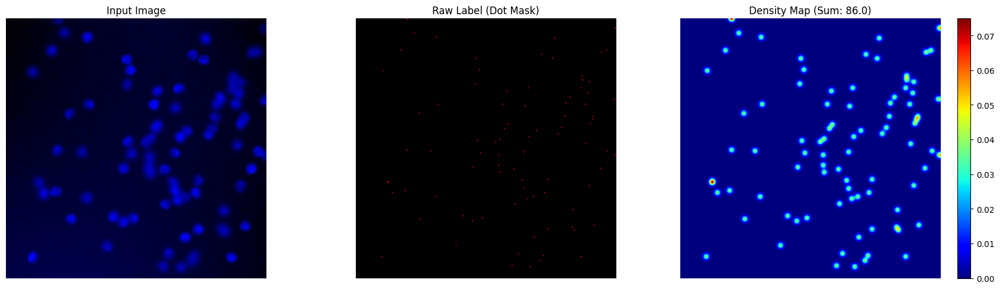

In [10]:
val_set.visualize_sample(0)

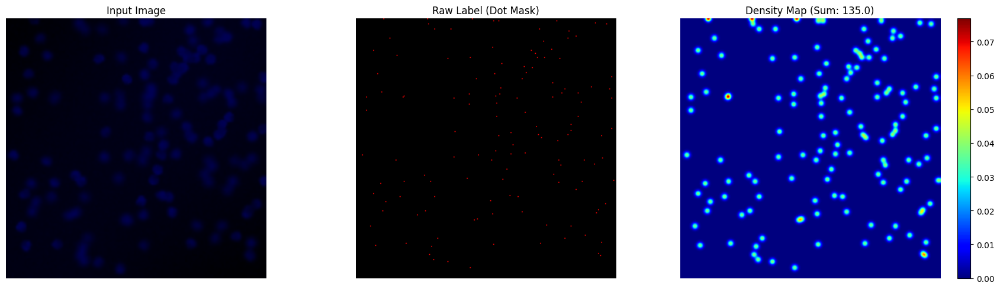

In [11]:
train_set.visualize_sample(0)

In [15]:
import torch
import torch.nn as nn
import torch.nn.functional as F


class DoubleConv(nn.Module):
    """(Conv => BN => ReLU) × 2"""

    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)


class Down(nn.Module):
    """Downscaling with maxpool then double conv"""

    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        return self.maxpool_conv(x)


class Up(nn.Module):
    """Upscaling then double conv"""

    def __init__(self, in_channels, out_channels, alg=False):
        super().__init__()

        # if bilinear, use the normal convolutions to reduce the number of channels
        if alg:
            self.up = nn.Upsample(scale_factor=2, mode='bicubic', align_corners=True)
            self.conv = DoubleConv(in_channels, out_channels)
        else:
            self.up = nn.ConvTranspose2d(in_channels, in_channels // 2, kernel_size=2, stride=2)
            self.conv = DoubleConv(in_channels, out_channels)

    def forward(self, x1, x2):
        x1 = self.up(x1)

        # Ensure x1 and x2 have same dimensions
        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]

        x1 = F.pad(x1, [diffX // 2, diffX - diffX // 2,
                        diffY // 2, diffY - diffY // 2])

        # Concatenate along the channel dimension
        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)


class OutConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(OutConv, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

    def forward(self, x):
        return self.conv(x)


class UNetCellCounter(nn.Module):
    def __init__(self, n_channels=3, alg=False):
        super(UNetCellCounter, self).__init__()
        self.n_channels = n_channels
        self.bilinear = alg

        # Initial feature size and scaling factor
        features = 64

        # Encoder (Downsampling path)
        self.inc = DoubleConv(n_channels, features)
        self.down1 = Down(features, features * 2)       # 64 -> 128
        self.down2 = Down(features * 2, features * 4)   # 128 -> 256
        self.down3 = Down(features * 4, features * 8)   # 256 -> 512

        # Bottleneck
        factor = 2 if alg else 1
        self.down4 = Down(features * 8, features * 16 // factor)  # 512 -> 1024/2=512

        # Decoder (Upsampling path)
        self.up1 = Up(features * 16, features * 8 // factor, alg)  # 1024 -> 512/2=256
        self.up2 = Up(features * 8, features * 4 // factor, alg)   # 512 -> 256/2=128
        self.up3 = Up(features * 4, features * 2 // factor, alg)   # 256 -> 128/2=64
        self.up4 = Up(features * 2, features, alg)                 # 128 -> 64

        # Final output layer - density map
        self.outc = OutConv(features, 1)

    def forward(self, x):
        # Encoder path
        x1 = self.inc(x)        # 64 channels
        x2 = self.down1(x1)     # 128 channels
        x3 = self.down2(x2)     # 256 channels
        x4 = self.down3(x3)     # 512 channels
        x5 = self.down4(x4)     # 1024/512 channels (bottleneck)

        # Decoder path with skip connections
        x = self.up1(x5, x4)    # 512/256 channels
        x = self.up2(x, x3)     # 256/128 channels
        x = self.up3(x, x2)     # 128/64 channels
        x = self.up4(x, x1)     # 64 channels

        # Final density map
        density_map = self.outc(x)  # 1 channel

        # Calculate cell count by summing the density map
        count = torch.sum(density_map, dim=(1, 2, 3))

        return density_map, count
def mse_with_count_regularization(pred_map, target_map, alpha=1, beta=0.001):
    pixel_mse = F.mse_loss(pred_map, target_map)

    pred_count = torch.sum(pred_map, dim=(1, 2, 3))
    true_count = torch.sum(target_map, dim=(1, 2, 3))
    count_mse = F.mse_loss(pred_count, true_count)

    return alpha * pixel_mse + beta * count_mse


# Training function with L2 loss
def train_unet(model, train_loader, val_loader, optimizer, criterion, device, num_epochs=50):
    best_val_loss = float('inf')
    train_losses = []
    val_losses = []

    for epoch in range(num_epochs):
        # Training phase
        model.train()
        epoch_loss = 0

        for inputs,_, targets in train_loader:
            inputs, targets = inputs.to(device), targets.to(device)

            # Zero gradients
            optimizer.zero_grad()

            # Forward pass
            density_maps, _ = model(inputs)

            # Calculate loss (L2 / MSE loss)
            loss = criterion(density_maps, targets)

            # Backward pass
            loss.backward()

            # Update weights
            optimizer.step()

            epoch_loss += loss.item()

        avg_train_loss = epoch_loss / len(train_loader)
        train_losses.append(avg_train_loss)

        # Validation phase
        model.eval()
        val_loss = 0
        mae = 0  # Mean Absolute Error for count

        with torch.no_grad():
            for batch_idx, (inputs, labels, targets) in enumerate(val_loader):
              inputs, labels, targets = inputs.to(device), labels.to(device),targets.to(device)
              density_maps, predicted_counts = model(inputs)

              loss = criterion(density_maps, targets)
              val_loss += loss.item()

              true_counts = torch.sum(labels, dim=(1, 2, 3))
              mae += torch.abs(predicted_counts - true_counts).sum().item()
              """
              if batch_idx % 10 == 0:
                # Visualize just the first sample in the batch
                print(mae)
                print(f"\n True count: {true_counts[0].item():.1f}, Predicted count: {predicted_counts[0].item():.1f}")

                plt.subplot(1, 2, 1)
                plt.imshow(targets[0].squeeze().cpu(), cmap='jet')
                plt.title(f"GT Density (Sum: {true_counts[0].item():.1f})")

                plt.subplot(1, 2, 2)
                plt.imshow(density_maps[0].squeeze().cpu(), cmap='jet')
                plt.title(f"Predicted (Sum: {predicted_counts[0].item():.1f})")
                plt.colorbar()
                plt.show()
              """

        # Then outside the loop:
        avg_val_loss = val_loss / len(val_loader)
        val_losses.append(avg_val_loss)
        avg_mae = mae / len(val_loader.dataset)
        print(f'Epoch {epoch+1}/{num_epochs}:')
        print(f'Train Loss: {avg_train_loss:.6f}, Val Loss: {avg_val_loss:.6f}, MAE: {avg_mae:.2f}')

        # Save best model
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            torch.save(model.state_dict(), 'best_unet_cell_counter.pth')
            print(f'Model saved with Val Loss: {best_val_loss:.4f}')

    return train_losses, val_losses

In [5]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = UNetCellCounter(n_channels=3, alg=True).to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)
criterion = nn.MSELoss()  # L2 loss for density map regression


9662.1923828125

 True count: 224.0, Predicted count: -1765.3


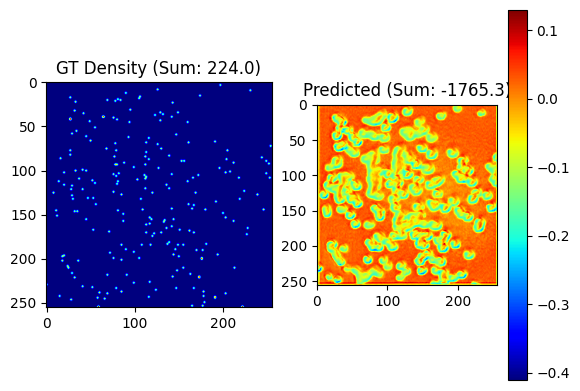

Epoch 1/30:
Train Loss: 63612.189188, Val Loss: 2512.740723, MAE: 1223.79
Model saved with Val Loss: 2512.7407
4692.76953125

 True count: 156.0, Predicted count: -361.5


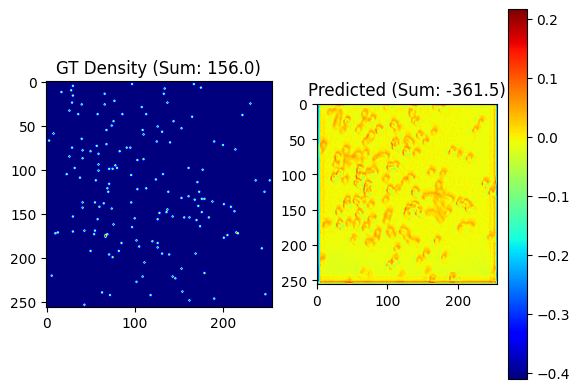

Epoch 2/30:
Train Loss: 4499.292053, Val Loss: 435.541448, MAE: 603.29
Model saved with Val Loss: 435.5414
921.36376953125

 True count: 98.0, Predicted count: 116.5


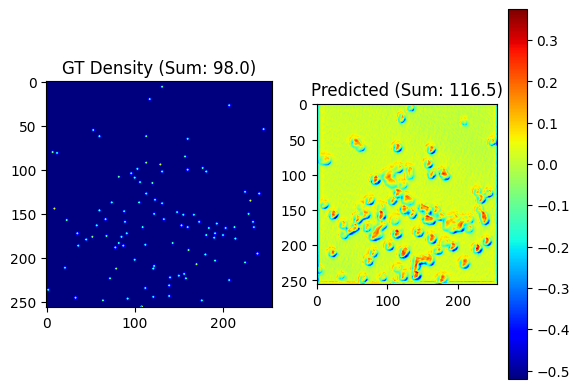

Epoch 3/30:
Train Loss: 3401.166109, Val Loss: 27.368593, MAE: 134.86
Model saved with Val Loss: 27.3686
3731.251953125

 True count: 244.0, Predicted count: 991.4


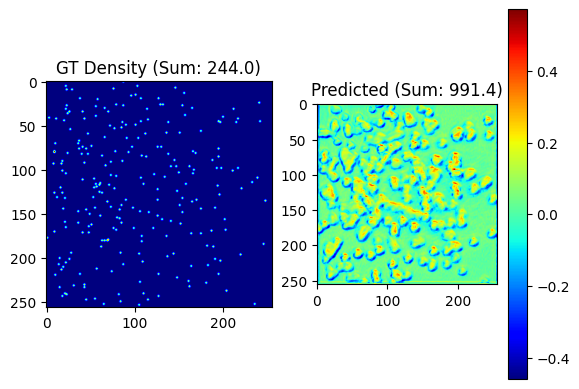

Epoch 4/30:
Train Loss: 1493.286415, Val Loss: 226.157857, MAE: 423.57
5074.6259765625

 True count: 79.0, Predicted count: -348.1


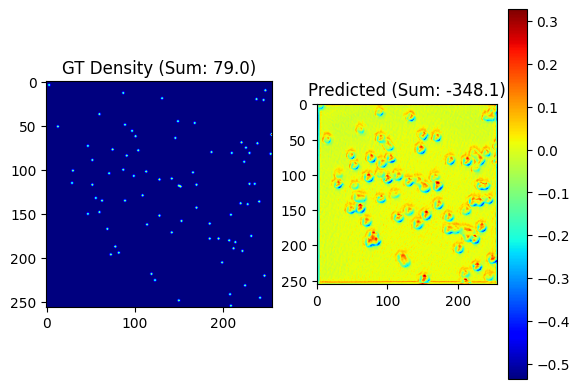

Epoch 5/30:
Train Loss: 1122.213088, Val Loss: 444.408580, MAE: 626.45
5765.4462890625

 True count: 95.0, Predicted count: -1030.9


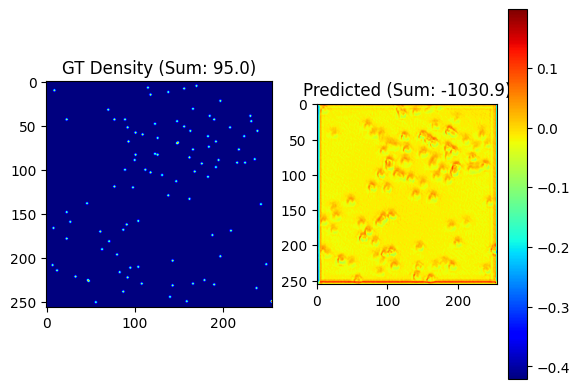

Epoch 6/30:
Train Loss: 1238.060163, Val Loss: 396.472524, MAE: 612.50
3489.78369140625

 True count: 248.0, Predicted count: 418.5


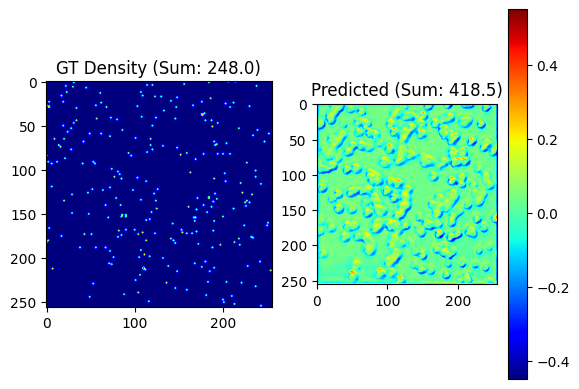

Epoch 7/30:
Train Loss: 646.262245, Val Loss: 179.930979, MAE: 406.66
1034.564453125

 True count: 200.0, Predicted count: 340.4


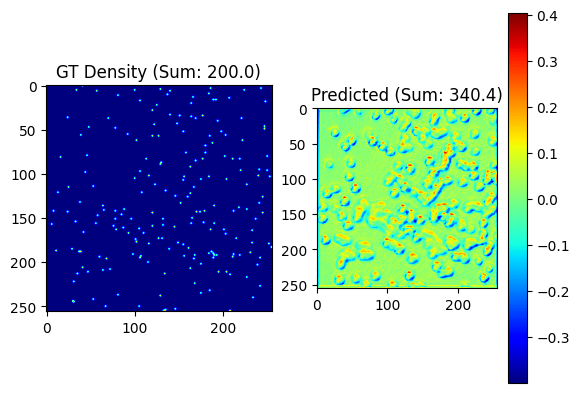

Epoch 8/30:
Train Loss: 362.833492, Val Loss: 22.777581, MAE: 120.50
Model saved with Val Loss: 22.7776
1900.949951171875

 True count: 248.0, Predicted count: -202.7


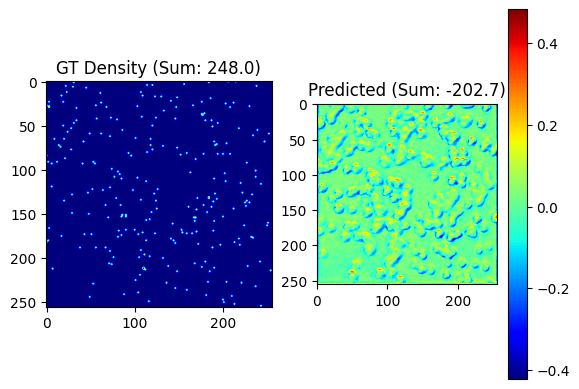

Epoch 9/30:
Train Loss: 328.562883, Val Loss: 90.128337, MAE: 269.43
1137.9306640625

 True count: 273.0, Predicted count: 44.7


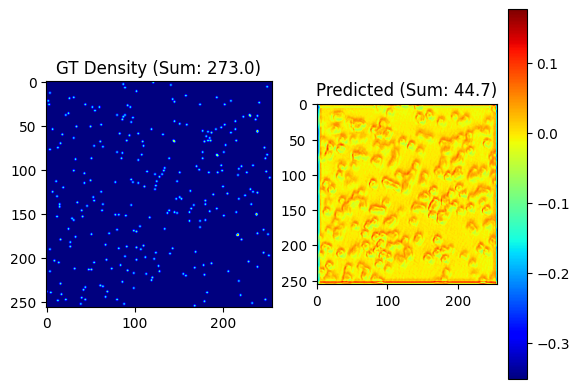

Epoch 10/30:
Train Loss: 271.872248, Val Loss: 25.685576, MAE: 135.23
2029.6396484375

 True count: 273.0, Predicted count: -210.6


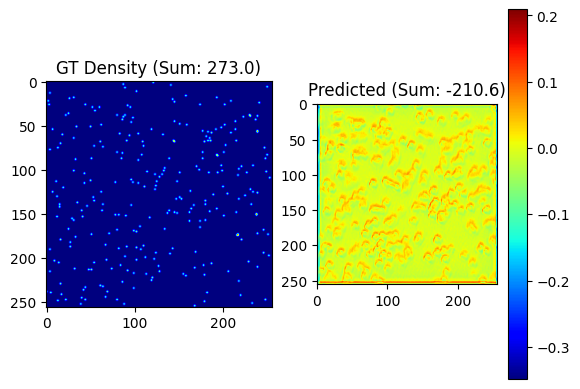

Epoch 11/30:
Train Loss: 314.290840, Val Loss: 88.603889, MAE: 261.33
1375.89453125

 True count: 200.0, Predicted count: -226.0


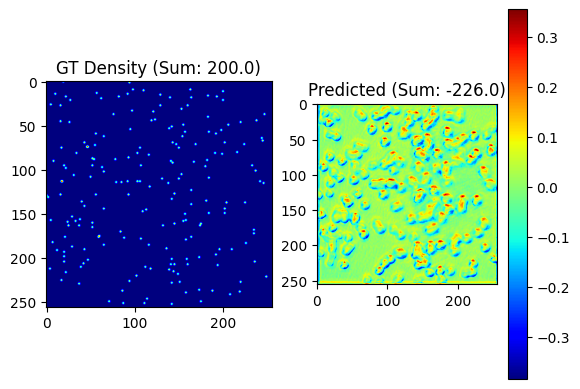

Epoch 12/30:
Train Loss: 322.851959, Val Loss: 78.908262, MAE: 207.30


KeyboardInterrupt: 

In [10]:
train_losses, val_losses = train_unet(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    optimizer=optimizer,
    criterion=mse_with_count_regularization,
    device=device,
    num_epochs=30
)


In [ ]:
import torch
from torch.utils.data import Dataset, DataLoader
import cv2
import numpy as np
import torchvision.transforms.functional as TF
import random
from torchvision import transforms
from scipy.ndimage import gaussian_filter
from PIL import Image
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import segmentation_models_pytorch as smp
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import argparse
import torch.nn.functional as F
from preprocess_cells import CellCountingDataset
import torchvision.models as models

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
seed = 42
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

def mse_with_count_regularization(pred_map, target_map, alpha=1, beta=0.001):
    pixel_mse = F.mse_loss(pred_map, target_map)

    pred_count = torch.sum(pred_map, dim=(1, 2, 3))
    true_count = torch.sum(target_map, dim=(1, 2, 3))
    count_mse = F.mse_loss(pred_count, true_count)

    return alpha * pixel_mse + beta * count_mse

class DoubleConv(nn.Module):
    """(Conv => BN => ReLU) × 2"""
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, 3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        return self.double_conv(x)


class Up(nn.Module):
    def __init__(self, x1_channels, x2_channels, out_channels, mode='bicubic', alg=False):
        super().__init__()

        self.up = nn.Upsample(scale_factor=2, mode=mode, align_corners=True)
        self.reduce = nn.Conv2d(x1_channels, out_channels, kernel_size=1)


        self.conv = DoubleConv(out_channels + x2_channels, out_channels)

    def forward(self, x1, x2):
        x1 = self.up(x1)
        x1 = self.reduce(x1)

        diffY = x2.size()[2] - x1.size()[2]
        diffX = x2.size()[3] - x1.size()[3]
        x1 = F.pad(x1, [diffX // 2, diffX - diffX // 2,
                        diffY // 2, diffY - diffY // 2])
        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)




class OutConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

    def forward(self, x):
        return self.conv(x)


class UNetCellCounter(nn.Module):
    def __init__(self,pretrained=True):
        super().__init__()

        # Load ResNet-34 backbone
        resnet = models.resnet50(pretrained=pretrained)

        self.layer0 = nn.Sequential(
            resnet.conv1,  # out: 64
            resnet.bn1,
            resnet.relu
        )
        self.pool = resnet.maxpool
        self.layer1 = resnet.layer1  # out: 64
        self.layer2 = resnet.layer2  # out: 128
        self.layer3 = resnet.layer3  # out: 256
        self.layer4 = resnet.layer4  # out: 512

        # Decoder
        factor = 2
        #self.up1 = Up(512, 256, 256)  # x1=512, x2=256 → output=256
        #self.up2 = Up(256, 128, 128)  # x1=256, x2=128 → output=128
        #self.up3 = Up(128, 64, 64)    # x1=128, x2=64  → output=64
        #self.up4 = Up(64, 64, 64)     # x1=64,  x2=64  → output=64
        self.up1 = Up(2048, 1024, 512)  # x1=2048 from layer4, x2=1024 from layer3
        self.up2 = Up(512, 512, 256)    # x1=512 after up1, x2=512 from layer2
        self.up3 = Up(256, 256, 128)    # x1=256 after up2, x2=256 from layer1
        self.up4 = Up(128, 64, 64)      # x1=128 after up3, x2=64 from early layers


        self.outc = OutConv(64, 1)

    def forward(self, x):
        #print("Input:", x.shape)  # [B, 3, H, W]

        x0 = self.layer0(x)       # 64
        #print("x0 (after conv1/bn1/relu):", x0.shape)

        x1 = self.pool(x0)        # 64
        #print("x1 (after maxpool):", x1.shape)

        x2 = self.layer1(x1)      # 64
        #print("x2 (layer1):", x2.shape)

        x3 = self.layer2(x2)      # 128
        #print("x3 (layer2):", x3.shape)

        x4 = self.layer3(x3)      # 256
        #print("x4 (layer3):", x4.shape)

        x5 = self.layer4(x4)      # 512
        #print("x5 (layer4):", x5.shape)

        # Decoder path
        x = self.up1(x5, x4)
        #print("After up1:", x.shape)

        x = self.up2(x, x3)
        #print("After up2:", x.shape)

        x = self.up3(x, x2)
        #print("After up3:", x.shape)

        x = self.up4(x, x1)
        #print("After up4:", x.shape)

        density_map = F.relu(self.outc(x))
        #print("Final density map:", density_map.shape)
        density_map = F.interpolate(density_map, size=(256, 256), mode='bicubic', align_corners=False)
        scale_factor = (density_map.shape[2] * density_map.shape[3]) / (x.shape[2] * x.shape[3])
        density_map = density_map / scale_factor


        count = torch.sum(density_map, dim=(1, 2, 3))
        return density_map, count



class UNetCellCounterEffNet(nn.Module):
    def __init__(self, backbone="efficientnet-b4", pretrained=True):
        super().__init__()
        # 1) Build a Unet with EfficientNet‑B4 encoder
        self.unet = smp.Unet(
            encoder_name=backbone,
            encoder_weights="imagenet" if pretrained else None,
            in_channels=3,
            classes=1,
            decoder_channels=(256, 128, 64, 64,64),   # you can adjust if you like
            activation=None
        )

    def forward(self, x):
        # returns [B,1,H,W]
        density_map = torch.relu(self.unet(x))
        count = density_map.sum(dim=(1, 2, 3))
        return density_map, count



def train_unet(model, train_loader, val_loader, optimizer, criterion, device, num_epochs=50):
    best_val_loss = float('inf')
    train_losses = []
    val_losses = []
    mae_list = []

    for epoch in range(num_epochs):
        # Training phase
        model.train()
        epoch_loss = 0

        for inputs,_, targets in train_loader:
            inputs, targets = inputs.to(device), targets.to(device)

            # Zero gradients
            optimizer.zero_grad()

            # Forward pass
            density_maps, _ = model(inputs)
            # inside your train loop, after you send targets to device:
            #print("targets min/max/sum:", targets.min().item(), targets.max().item(), targets.sum().item())
            #print("preds   min/max/sum:", density_maps.detach().min().item(),
             #                           density_maps.detach().max().item(),
              #                          density_maps.detach().sum().item())


            # Calculate loss (L2 / MSE loss)
            loss = criterion(density_maps, targets)

            # Backward pass
            loss.backward()

            # Update weights
            optimizer.step()

            epoch_loss += loss.item()

        avg_train_loss = epoch_loss / len(train_loader)
        train_losses.append(avg_train_loss)

        # Validation phase
        model.eval()
        val_loss = 0
        mae = 0  # Mean Absolute Error for count

        with torch.no_grad():
            for batch_idx, (inputs, labels, targets) in enumerate(val_loader):
              inputs, labels, targets = inputs.to(device), labels.to(device),targets.to(device)
              density_maps, predicted_counts = model(inputs)

              loss = criterion(density_maps, targets)
              val_loss += loss.item()

              true_counts = torch.sum(labels, dim=(1, 2, 3))
              mae += torch.abs(predicted_counts - true_counts).sum().item()
              """
              if batch_idx % 10 == 0:
                # Visualize just the first sample in the batch
                print(mae)
                print(f"\n True count: {true_counts[0].item():.1f}, Predicted count: {predicted_counts[0].item():.1f}")

                plt.subplot(1, 2, 1)
                plt.imshow(targets[0].squeeze().cpu(), cmap='jet')
                plt.title(f"GT Density (Sum: {true_counts[0].item():.1f})")

                plt.subplot(1, 2, 2)
                plt.imshow(density_maps[0].squeeze().cpu(), cmap='jet')
                plt.title(f"Predicted (Sum: {predicted_counts[0].item():.1f})")
                plt.colorbar()
                plt.show()
              """

        # Then outside the loop:
        avg_val_loss = val_loss / len(val_loader)
        val_losses.append(avg_val_loss)
        avg_mae = mae / len(val_loader.dataset)
        mae_list.append(avg_mae)
        print(f'Epoch {epoch+1}/{num_epochs}:')
        print(f'Train Loss: {avg_train_loss:.6f}, Val Loss: {avg_val_loss:.6f}, MAE: {avg_mae:.2f}')

        # Save best model
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            torch.save(model.state_dict(), 'best_unet_cell_counter.pth')
            print(f'Model saved with Val Loss: {best_val_loss:.4f}')

    return train_losses, val_losses, mae_list

In [14]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = UNetCellCounter().to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-4)
criterion = nn.MSELoss()  # L2 loss for density map regression

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
100%|██████████| 83.3M/83.3M [00:00<00:00, 188MB/s] 


In [15]:
from torchsummary import summary
summary(model, input_size = (3,256,256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 128, 128]           9,408
       BatchNorm2d-2         [-1, 64, 128, 128]             128
              ReLU-3         [-1, 64, 128, 128]               0
         MaxPool2d-4           [-1, 64, 64, 64]               0
            Conv2d-5           [-1, 64, 64, 64]          36,864
       BatchNorm2d-6           [-1, 64, 64, 64]             128
              ReLU-7           [-1, 64, 64, 64]               0
            Conv2d-8           [-1, 64, 64, 64]          36,864
       BatchNorm2d-9           [-1, 64, 64, 64]             128
             ReLU-10           [-1, 64, 64, 64]               0
       BasicBlock-11           [-1, 64, 64, 64]               0
           Conv2d-12           [-1, 64, 64, 64]          36,864
      BatchNorm2d-13           [-1, 64, 64, 64]             128
             ReLU-14           [-1, 64,

In [10]:
import torch
import torch.nn as nn
import segmentation_models_pytorch as smp

class UNetCellCounterEffNet(nn.Module):
    def __init__(self, backbone="efficientnet-b4", pretrained=True):
        super().__init__()
        # 1) Build a Unet with EfficientNet‑B4 encoder
        self.unet = smp.Unet(
            encoder_name=backbone,
            encoder_weights="imagenet" if pretrained else None,
            in_channels=3,
            classes=1,
            decoder_channels=(256, 128, 64, 64,64),   # you can adjust if you like
            activation=None
        )

    def forward(self, x):
        # returns [B,1,H,W]
        density_map = torch.relu(self.unet(x))
        count = density_map.sum(dim=(1, 2, 3))
        return density_map, count



In [11]:
from torchsummary import summary

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = UNetCellCounterEffNet().to(device)

summary(model, input_size=(3, 256, 256), device=str(device))



----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
         ZeroPad2d-1          [-1, 3, 257, 257]               0
Conv2dStaticSamePadding-2         [-1, 48, 128, 128]           1,296
       BatchNorm2d-3         [-1, 48, 128, 128]              96
MemoryEfficientSwish-4         [-1, 48, 128, 128]               0
         ZeroPad2d-5         [-1, 48, 130, 130]               0
Conv2dStaticSamePadding-6         [-1, 48, 128, 128]             432
       BatchNorm2d-7         [-1, 48, 128, 128]              96
MemoryEfficientSwish-8         [-1, 48, 128, 128]               0
          Identity-9             [-1, 48, 1, 1]               0
Conv2dStaticSamePadding-10             [-1, 12, 1, 1]             588
MemoryEfficientSwish-11             [-1, 12, 1, 1]               0
         Identity-12             [-1, 12, 1, 1]               0
Conv2dStaticSamePadding-13             [-1, 48, 1, 1]             624
         I

## Expeiment 1: Adam, lr 1e-4, weight_decay 1e-4, sigma - 1, bicubic with pretrained weights resnet 34

1028.346923828125

 True count: 244.0, Predicted count: 28.9


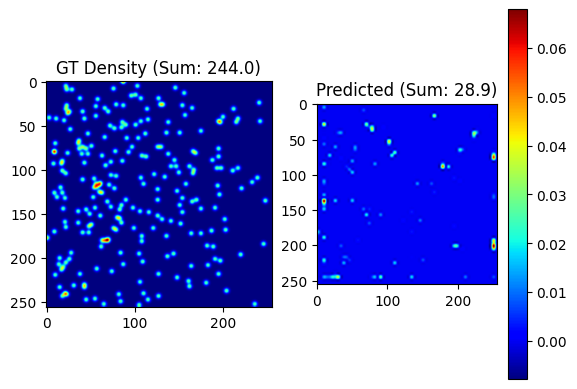

Epoch 1/30:
Train Loss: 2338.751320, Val Loss: 27.033653, MAE: 153.42
Model saved with Val Loss: 27.0337
414.7215576171875

 True count: 128.0, Predicted count: 72.6


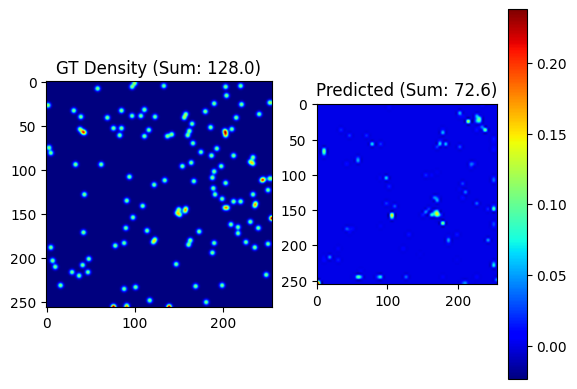

Epoch 2/30:
Train Loss: 29.666359, Val Loss: 7.893638, MAE: 71.16
Model saved with Val Loss: 7.8936
331.16278076171875

 True count: 153.0, Predicted count: 173.3


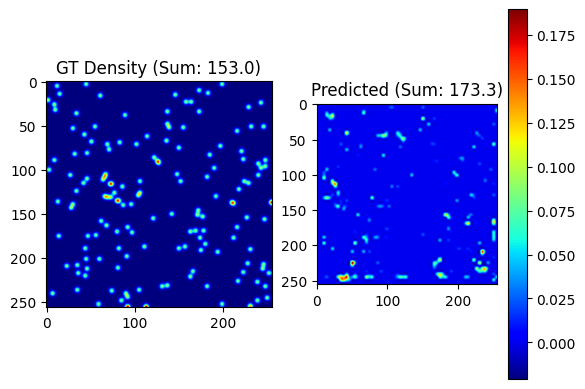

Epoch 3/30:
Train Loss: 11.986717, Val Loss: 3.269078, MAE: 45.94
Model saved with Val Loss: 3.2691
353.47601318359375

 True count: 98.0, Predicted count: 123.6


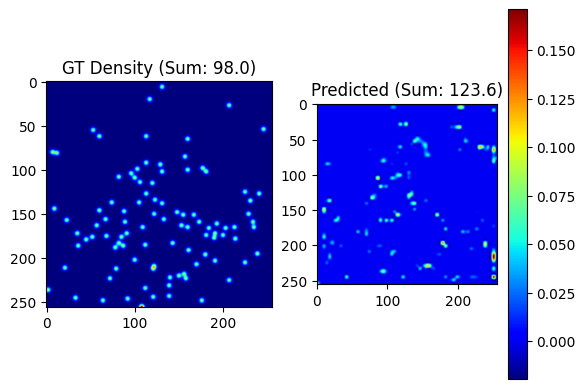

Epoch 4/30:
Train Loss: 7.489401, Val Loss: 2.282580, MAE: 40.51
Model saved with Val Loss: 2.2826
290.46575927734375

 True count: 95.0, Predicted count: 116.1


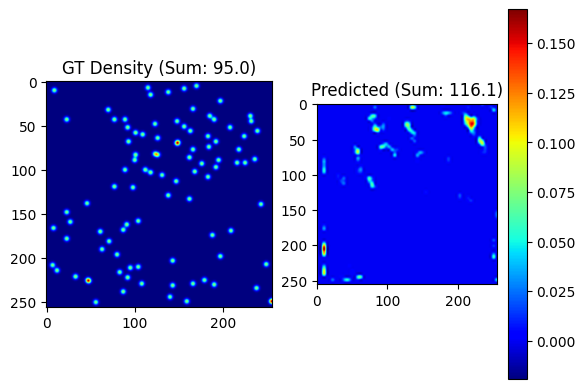

Epoch 5/30:
Train Loss: 9.998832, Val Loss: 1.220852, MAE: 28.97
Model saved with Val Loss: 1.2209
347.93389892578125

 True count: 273.0, Predicted count: 298.2


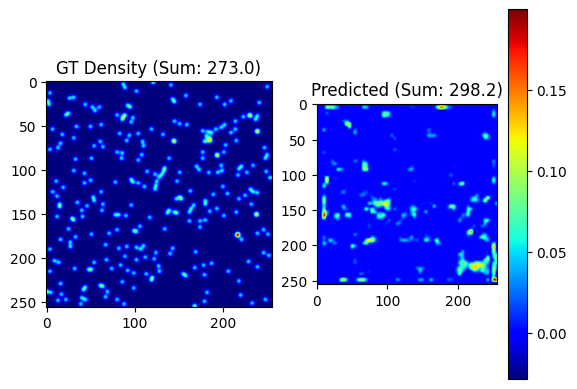

Epoch 6/30:
Train Loss: 7.030032, Val Loss: 2.093600, MAE: 37.77
473.91510009765625

 True count: 153.0, Predicted count: 137.1


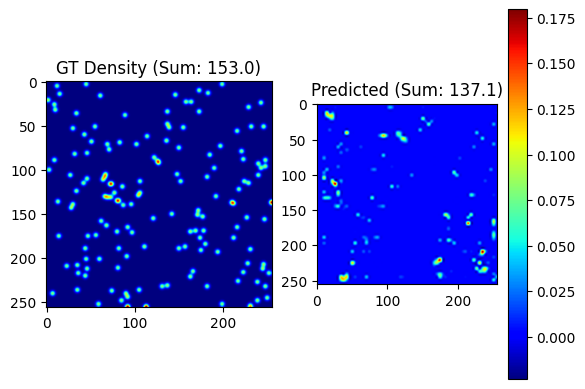

Epoch 7/30:
Train Loss: 7.710640, Val Loss: 4.089878, MAE: 51.14
333.0680847167969

 True count: 153.0, Predicted count: 121.1


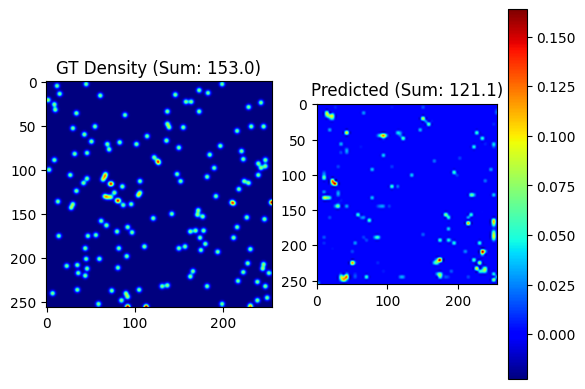

Epoch 8/30:
Train Loss: 5.955712, Val Loss: 5.348274, MAE: 56.59
325.27618408203125

 True count: 153.0, Predicted count: 167.6


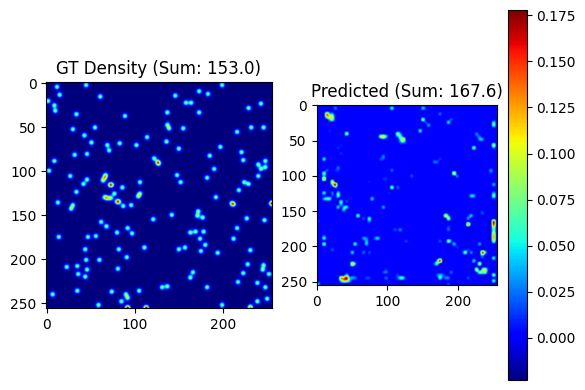

Epoch 9/30:
Train Loss: 8.458381, Val Loss: 1.534178, MAE: 36.27
305.89520263671875

 True count: 218.0, Predicted count: 143.6


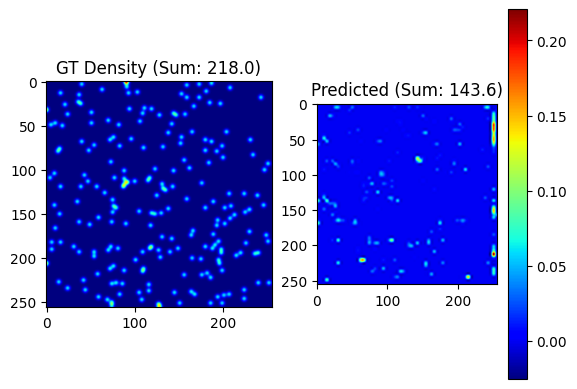

Epoch 10/30:
Train Loss: 4.596426, Val Loss: 1.869207, MAE: 35.20
302.4208984375

 True count: 79.0, Predicted count: 116.9


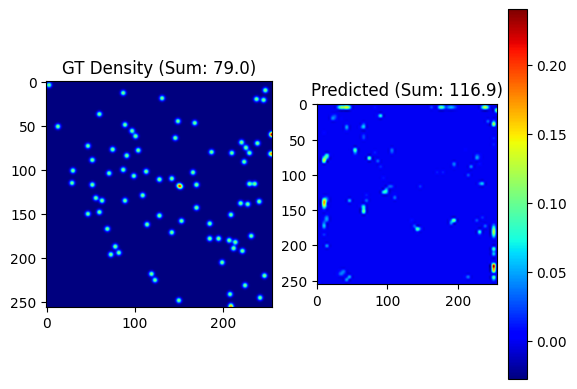

Epoch 11/30:
Train Loss: 5.112460, Val Loss: 1.392345, MAE: 32.39
260.98583984375

 True count: 98.0, Predicted count: 141.7


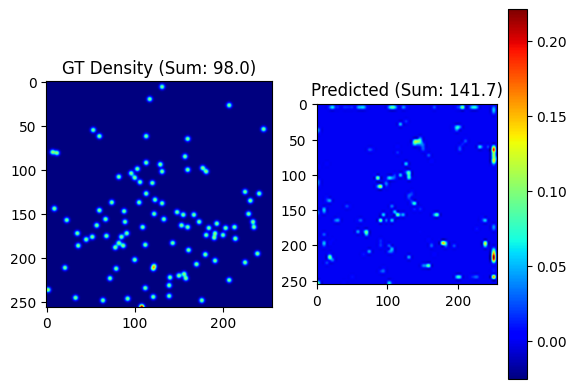

Epoch 12/30:
Train Loss: 4.246395, Val Loss: 1.552171, MAE: 34.54
270.50787353515625

 True count: 292.0, Predicted count: 342.4


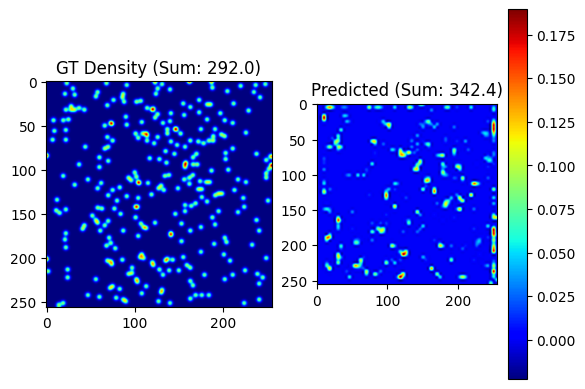

Epoch 13/30:
Train Loss: 5.473926, Val Loss: 1.782121, MAE: 36.18
276.4056396484375

 True count: 200.0, Predicted count: 151.0


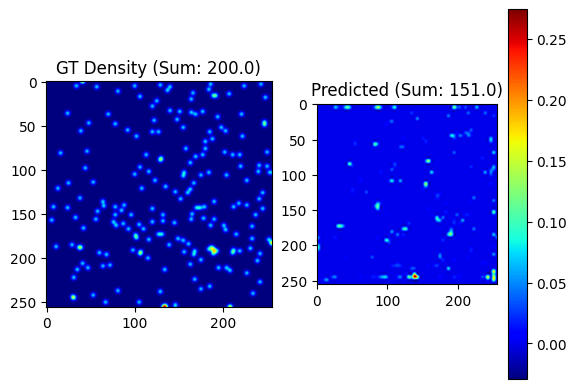

Epoch 14/30:
Train Loss: 4.805583, Val Loss: 1.272328, MAE: 30.84
370.2785339355469

 True count: 218.0, Predicted count: 181.6


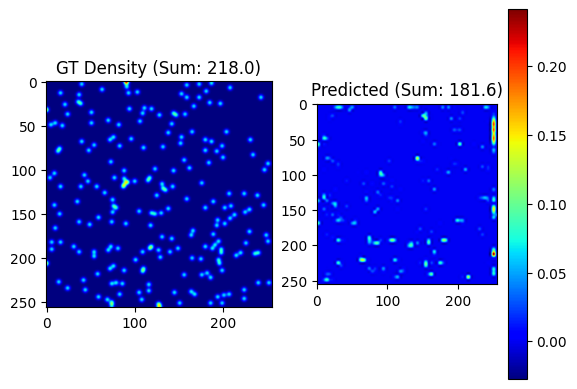

Epoch 15/30:
Train Loss: 3.846345, Val Loss: 1.615955, MAE: 35.85
247.12371826171875

 True count: 218.0, Predicted count: 168.5


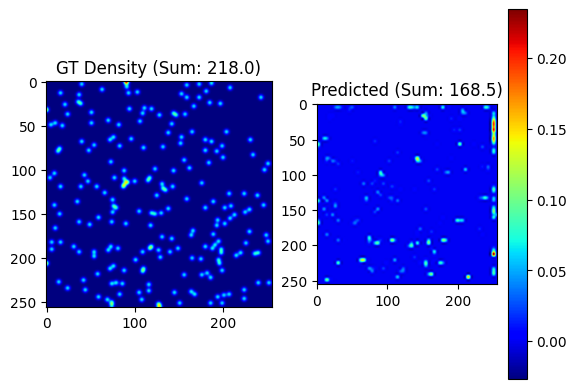

Epoch 16/30:
Train Loss: 4.357329, Val Loss: 1.324100, MAE: 29.28
355.0115051269531

 True count: 292.0, Predicted count: 429.9


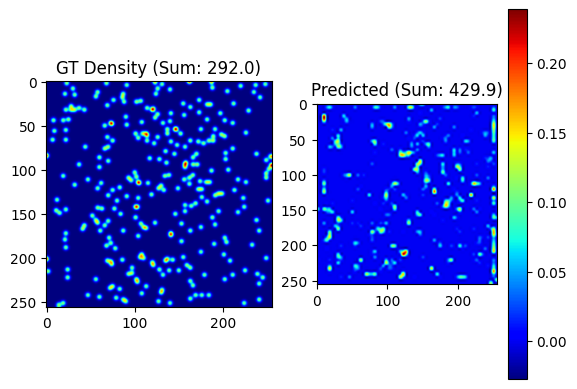

Epoch 17/30:
Train Loss: 3.995186, Val Loss: 2.696246, MAE: 41.48
284.0341796875

 True count: 156.0, Predicted count: 204.8


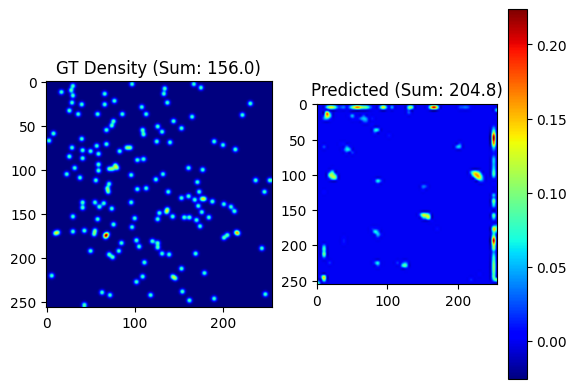

Epoch 18/30:
Train Loss: 3.279653, Val Loss: 1.222622, MAE: 30.10
243.99307250976562

 True count: 200.0, Predicted count: 151.6


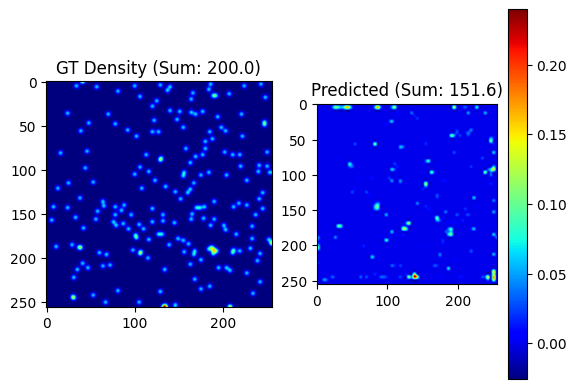

Epoch 19/30:
Train Loss: 3.876250, Val Loss: 1.292379, MAE: 29.68
324.18267822265625

 True count: 248.0, Predicted count: 244.0


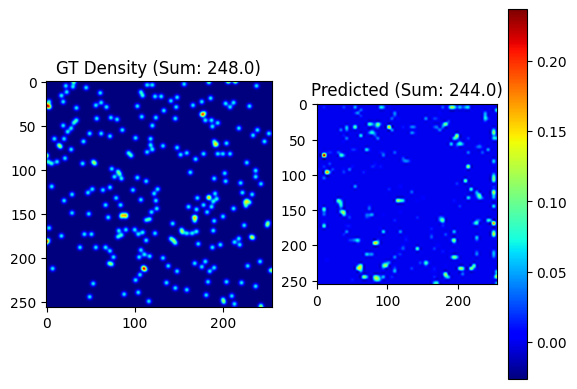

Epoch 20/30:
Train Loss: 4.084537, Val Loss: 1.841455, MAE: 33.33
179.272216796875

 True count: 98.0, Predicted count: 139.0


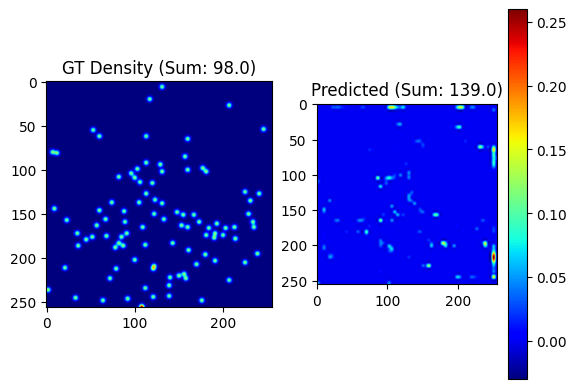

Epoch 21/30:
Train Loss: 2.461860, Val Loss: 1.575819, MAE: 29.41
286.1922912597656

 True count: 244.0, Predicted count: 216.2


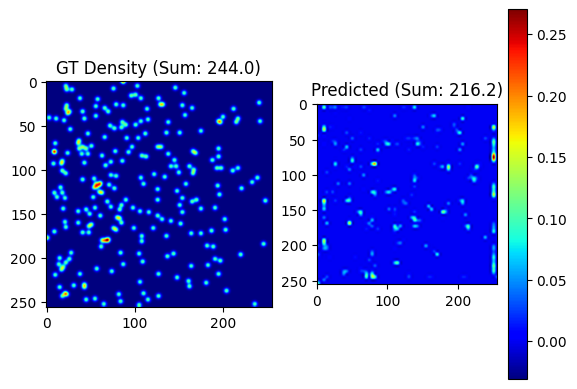

Epoch 22/30:
Train Loss: 3.874926, Val Loss: 1.042372, MAE: 29.40
Model saved with Val Loss: 1.0424
267.12188720703125

 True count: 248.0, Predicted count: 231.1


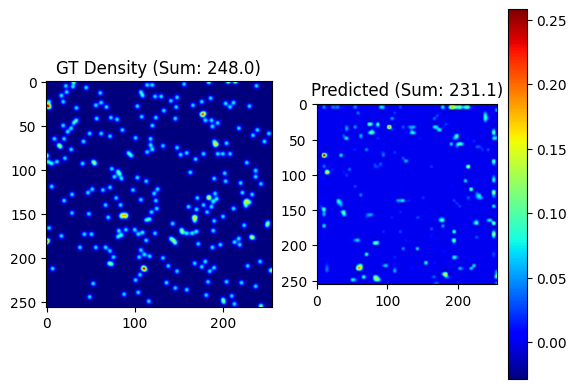

Epoch 23/30:
Train Loss: 2.945745, Val Loss: 1.591693, MAE: 32.14
254.82937622070312

 True count: 292.0, Predicted count: 383.3


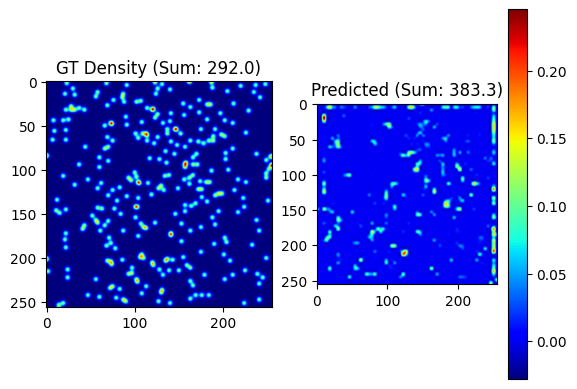

Epoch 24/30:
Train Loss: 2.920942, Val Loss: 1.308441, MAE: 29.78
170.07386779785156

 True count: 224.0, Predicted count: 256.0


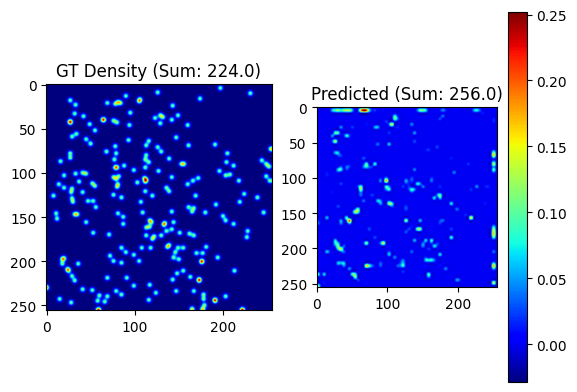

Epoch 25/30:
Train Loss: 2.984088, Val Loss: 0.932222, MAE: 24.42
Model saved with Val Loss: 0.9322
240.69436645507812

 True count: 273.0, Predicted count: 261.1


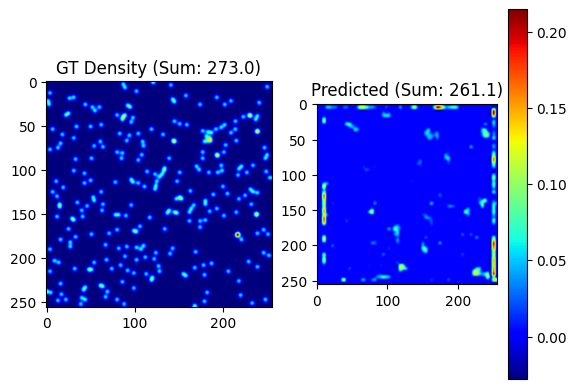

Epoch 26/30:
Train Loss: 3.481805, Val Loss: 1.144176, MAE: 29.23
240.55062866210938

 True count: 273.0, Predicted count: 187.7


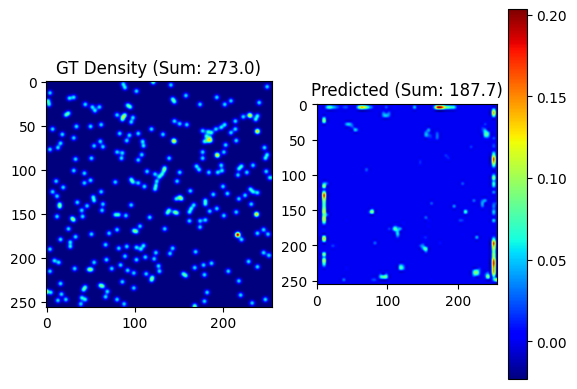

Epoch 27/30:
Train Loss: 3.510173, Val Loss: 2.104840, MAE: 36.48
323.7597351074219

 True count: 79.0, Predicted count: 165.4


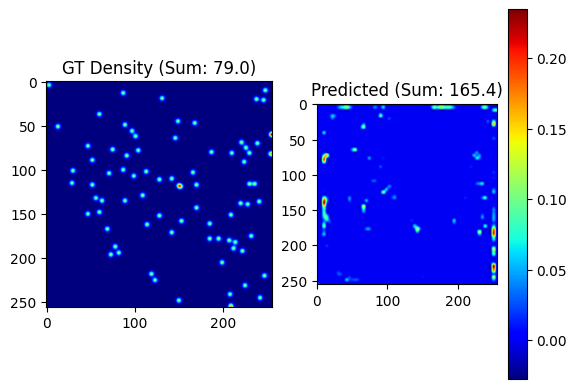

Epoch 28/30:
Train Loss: 2.824647, Val Loss: 1.466716, MAE: 32.35
275.93707275390625

 True count: 154.0, Predicted count: 130.4


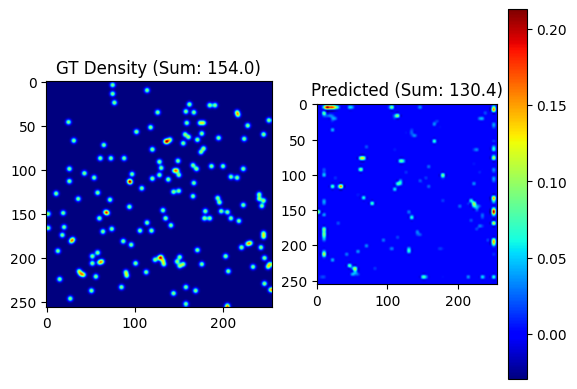

Epoch 29/30:
Train Loss: 2.788744, Val Loss: 0.954527, MAE: 26.26
271.9251403808594

 True count: 224.0, Predicted count: 207.5


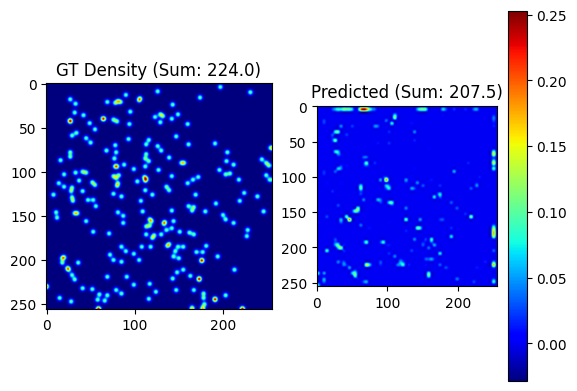

Epoch 30/30:
Train Loss: 3.103761, Val Loss: 1.310025, MAE: 30.76


In [196]:
train_losses, val_losses = train_unet(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    optimizer=optimizer,
    criterion=mse_with_count_regularization,
    device=device,
    num_epochs=30
)


## Expeiment 1: Adam, lr 1e-4, weight_decay 1e-4, sigma - 0.5, bicubic with pretrained weights resnet 34

877.8692626953125

 True count: 124.0, Predicted count: 49.4


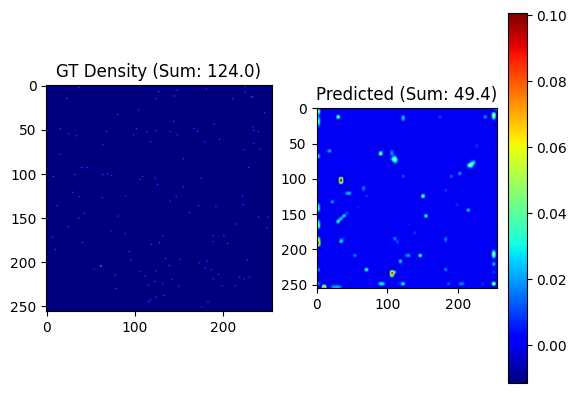

Epoch 1/30:
Train Loss: 7123.470369, Val Loss: 18.329907, MAE: 123.98
Model saved with Val Loss: 18.3299
1744.21484375

 True count: 218.0, Predicted count: 152.0


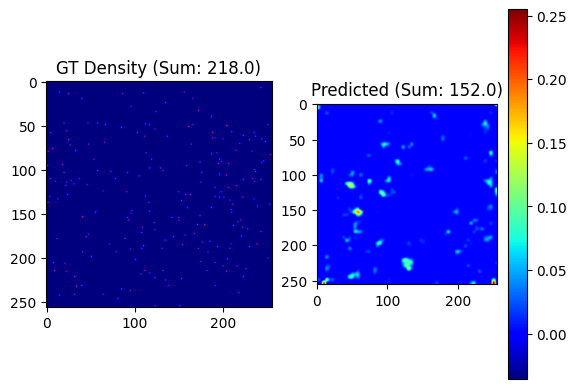

Epoch 2/30:
Train Loss: 261.954843, Val Loss: 48.519023, MAE: 185.01
615.6930541992188

 True count: 273.0, Predicted count: 138.1


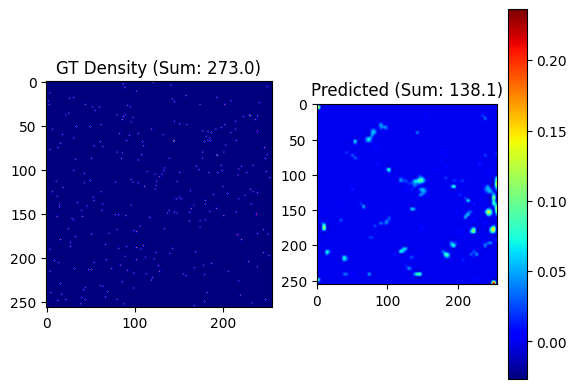

Epoch 3/30:
Train Loss: 48.045590, Val Loss: 11.429093, MAE: 88.60
Model saved with Val Loss: 11.4291
707.6868286132812

 True count: 156.0, Predicted count: 127.9


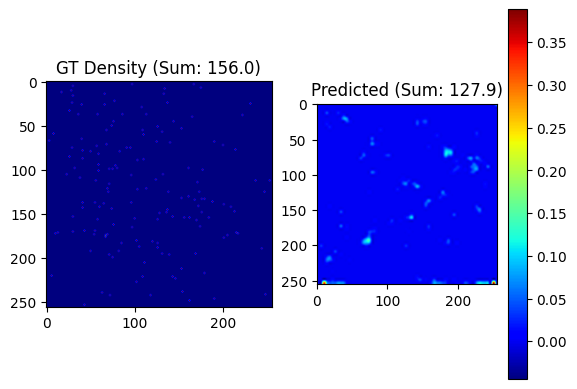

Epoch 4/30:
Train Loss: 31.387858, Val Loss: 11.751707, MAE: 82.54
653.4901733398438

 True count: 273.0, Predicted count: 80.7


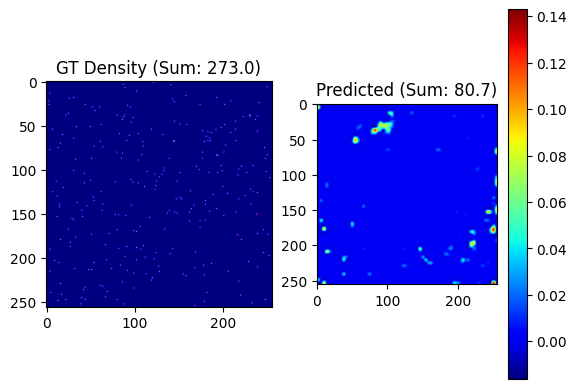

Epoch 5/30:
Train Loss: 11.165612, Val Loss: 9.127391, MAE: 77.26
Model saved with Val Loss: 9.1274
566.77490234375

 True count: 218.0, Predicted count: 71.0


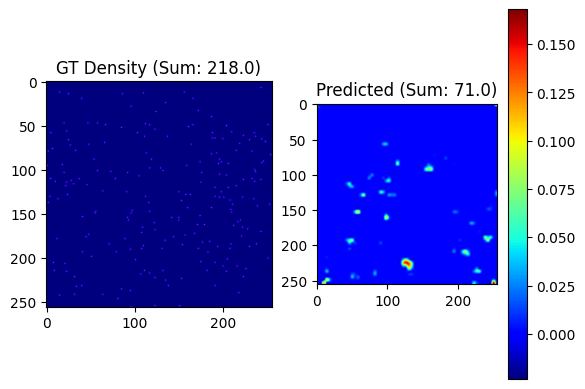

Epoch 6/30:
Train Loss: 7.671288, Val Loss: 7.706483, MAE: 66.52
Model saved with Val Loss: 7.7065
555.603271484375

 True count: 95.0, Predicted count: 35.5


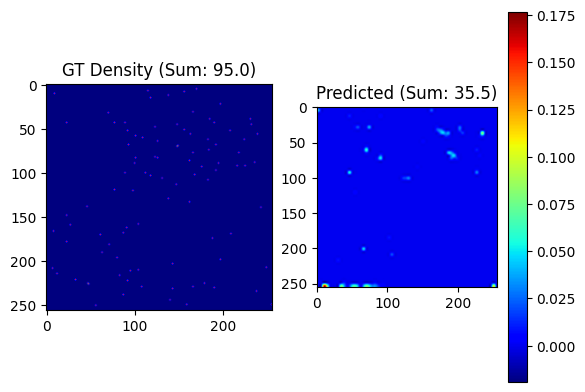

Epoch 7/30:
Train Loss: 11.241126, Val Loss: 7.812530, MAE: 67.27
745.1304931640625

 True count: 292.0, Predicted count: 103.9


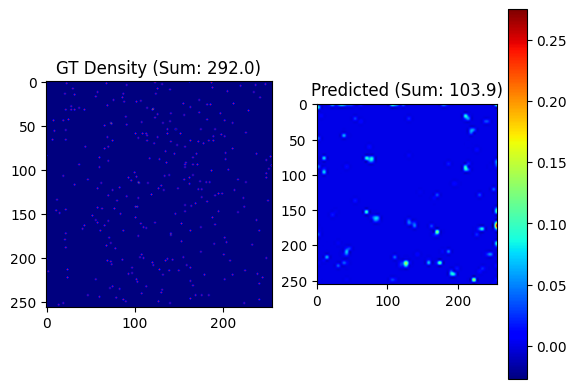

Epoch 8/30:
Train Loss: 8.222882, Val Loss: 8.049428, MAE: 71.85
504.3723449707031

 True count: 132.0, Predicted count: 90.0


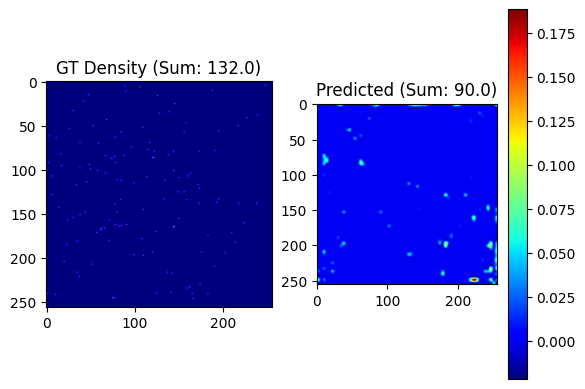

Epoch 9/30:
Train Loss: 7.119553, Val Loss: 6.943138, MAE: 67.82
Model saved with Val Loss: 6.9431
406.0212707519531

 True count: 200.0, Predicted count: 220.7


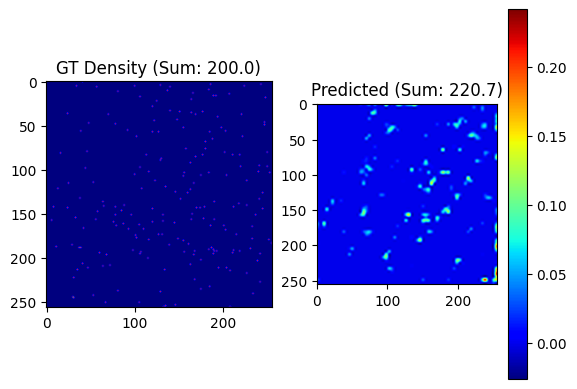

Epoch 10/30:
Train Loss: 10.060816, Val Loss: 8.200324, MAE: 71.79
385.2142639160156

 True count: 84.0, Predicted count: 103.5


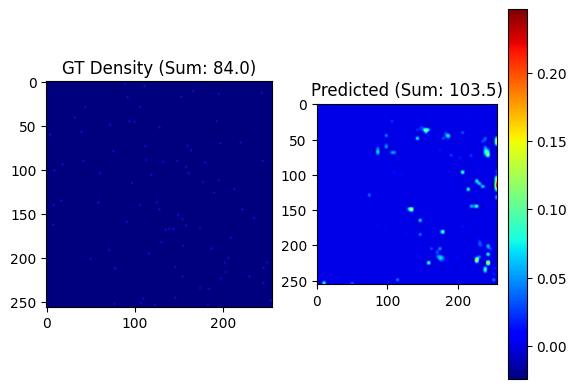

Epoch 11/30:
Train Loss: 6.871512, Val Loss: 5.353858, MAE: 58.21
Model saved with Val Loss: 5.3539
645.0722045898438

 True count: 86.0, Predicted count: 86.7


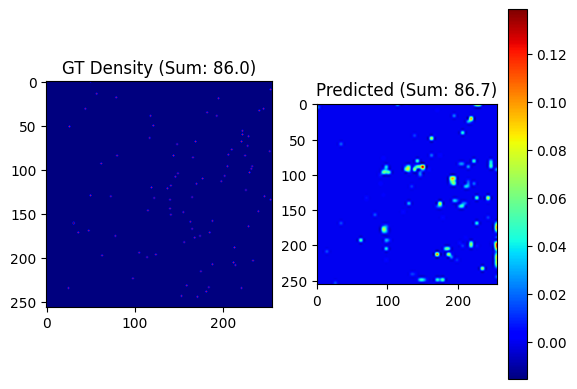

Epoch 12/30:
Train Loss: 7.804376, Val Loss: 7.424229, MAE: 65.85
433.14288330078125

 True count: 218.0, Predicted count: 86.7


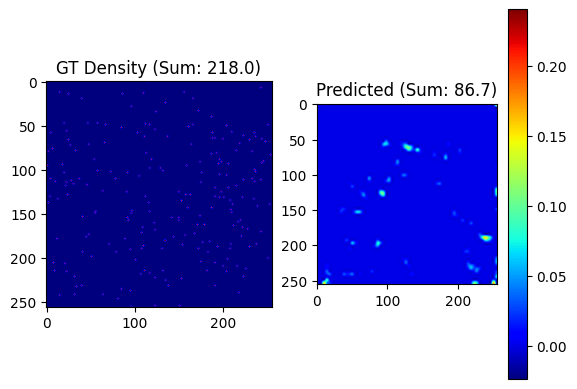

Epoch 13/30:
Train Loss: 5.972244, Val Loss: 6.516572, MAE: 69.57
374.6731262207031

 True count: 218.0, Predicted count: 117.8


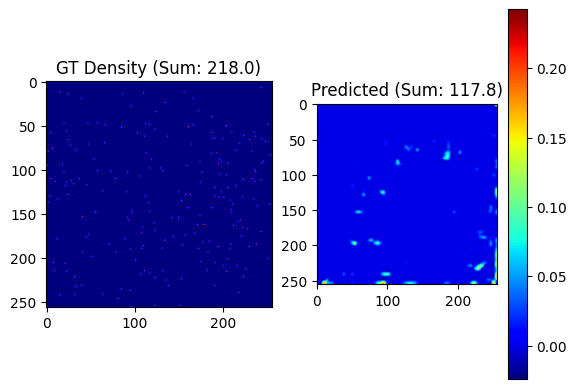

Epoch 14/30:
Train Loss: 6.794265, Val Loss: 5.278284, MAE: 57.26
Model saved with Val Loss: 5.2783
487.3775329589844

 True count: 248.0, Predicted count: 95.0


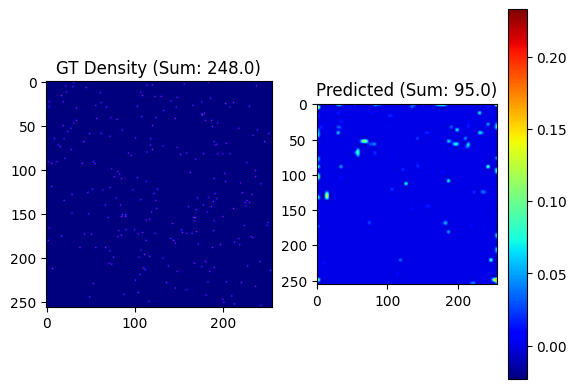

Epoch 15/30:
Train Loss: 6.589940, Val Loss: 7.359100, MAE: 66.84
525.66015625

 True count: 124.0, Predicted count: 104.2


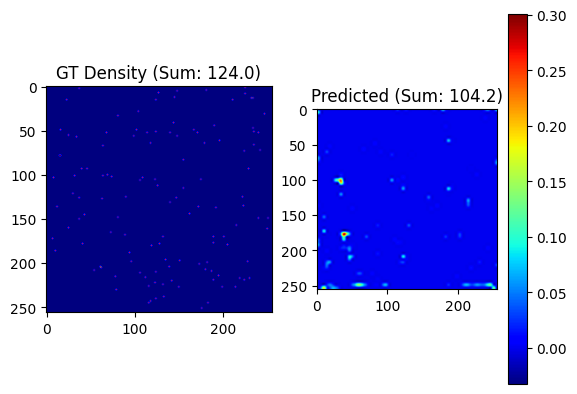

Epoch 16/30:
Train Loss: 8.170481, Val Loss: 9.391291, MAE: 66.13
465.9857177734375

 True count: 248.0, Predicted count: 97.8


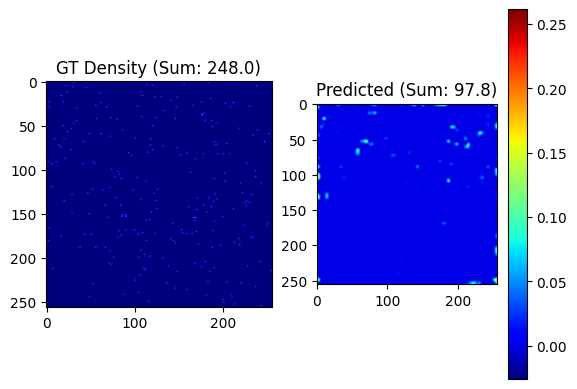

Epoch 17/30:
Train Loss: 5.044108, Val Loss: 5.638857, MAE: 57.18
541.3984375

 True count: 273.0, Predicted count: 142.4


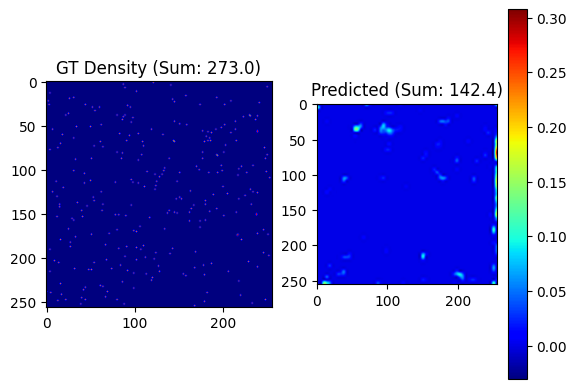

Epoch 18/30:
Train Loss: 5.781588, Val Loss: 4.225014, MAE: 54.27
Model saved with Val Loss: 4.2250
403.7539978027344

 True count: 132.0, Predicted count: 111.6


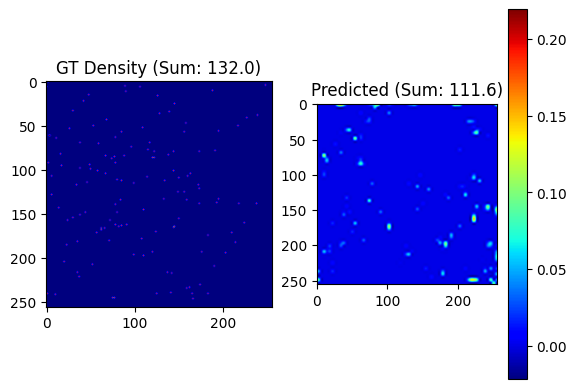

Epoch 19/30:
Train Loss: 4.177188, Val Loss: 4.549822, MAE: 53.67
324.59185791015625

 True count: 132.0, Predicted count: 129.1


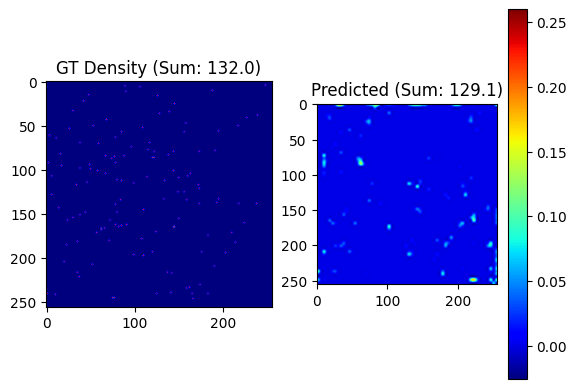

Epoch 20/30:
Train Loss: 6.680081, Val Loss: 4.232704, MAE: 48.30
441.56402587890625

 True count: 98.0, Predicted count: 85.3


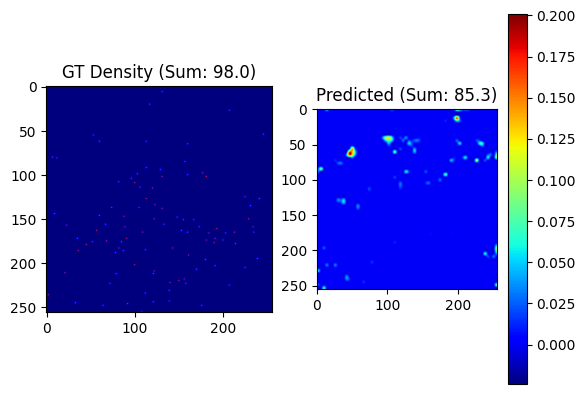

Epoch 21/30:
Train Loss: 6.255961, Val Loss: 7.301900, MAE: 67.41
323.2693176269531

 True count: 79.0, Predicted count: 79.2


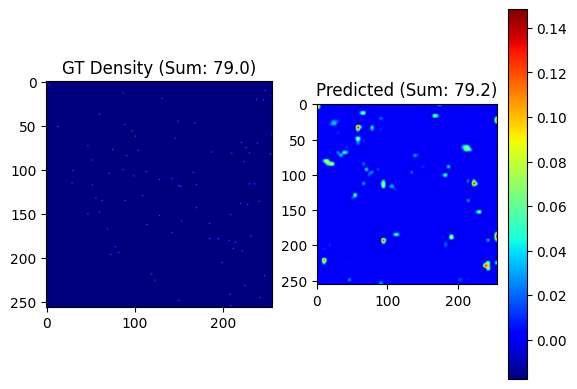

Epoch 22/30:
Train Loss: 4.272766, Val Loss: 3.364694, MAE: 44.85
Model saved with Val Loss: 3.3647
326.1892395019531

 True count: 84.0, Predicted count: 110.9


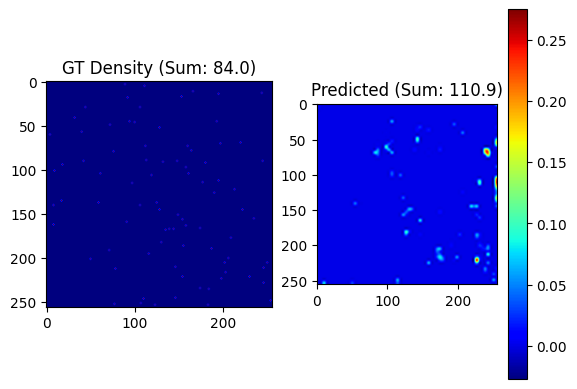

Epoch 23/30:
Train Loss: 5.208632, Val Loss: 4.126379, MAE: 50.65
381.93621826171875

 True count: 248.0, Predicted count: 136.4


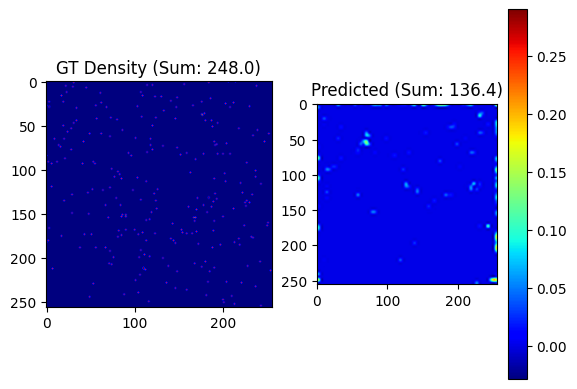

Epoch 24/30:
Train Loss: 4.733635, Val Loss: 2.034336, MAE: 35.44
Model saved with Val Loss: 2.0343
345.60479736328125

 True count: 153.0, Predicted count: 113.4


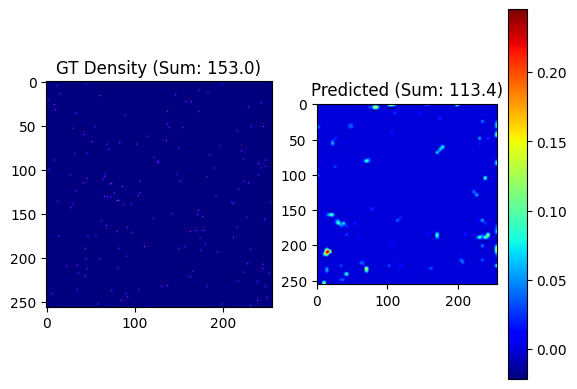

Epoch 25/30:
Train Loss: 5.201512, Val Loss: 4.366947, MAE: 43.22
405.66229248046875

 True count: 79.0, Predicted count: 68.9


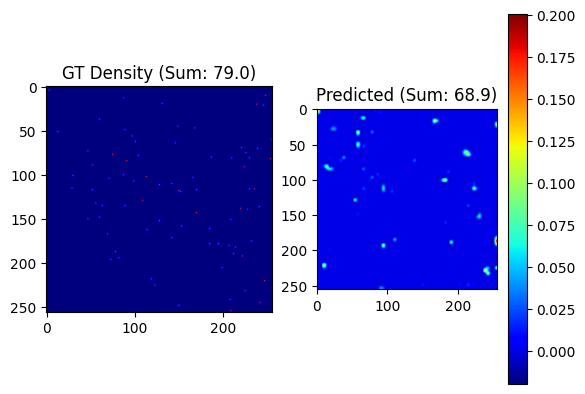

Epoch 26/30:
Train Loss: 4.302467, Val Loss: 2.873390, MAE: 40.86
148.63363647460938

 True count: 154.0, Predicted count: 150.0


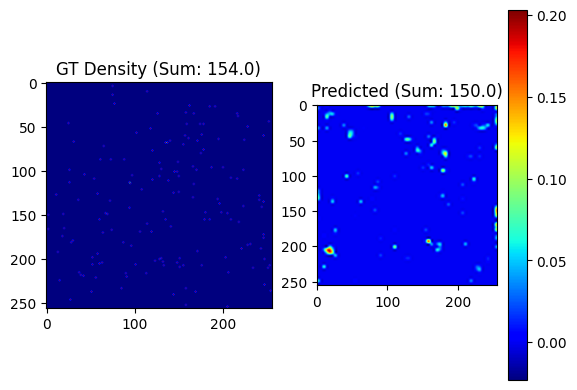

Epoch 27/30:
Train Loss: 4.762738, Val Loss: 3.760625, MAE: 43.26
281.0308532714844

 True count: 86.0, Predicted count: 82.5


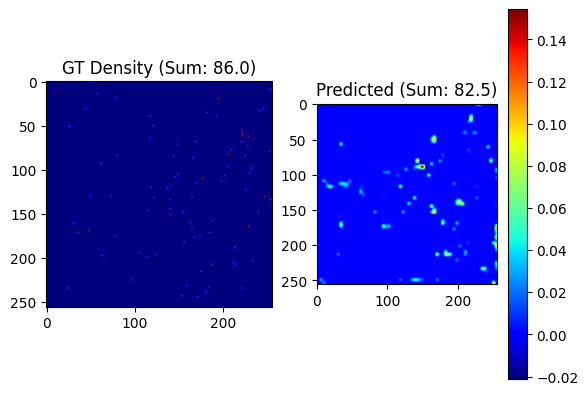

Epoch 28/30:
Train Loss: 4.338065, Val Loss: 2.990285, MAE: 45.07
364.79669189453125

 True count: 248.0, Predicted count: 160.0


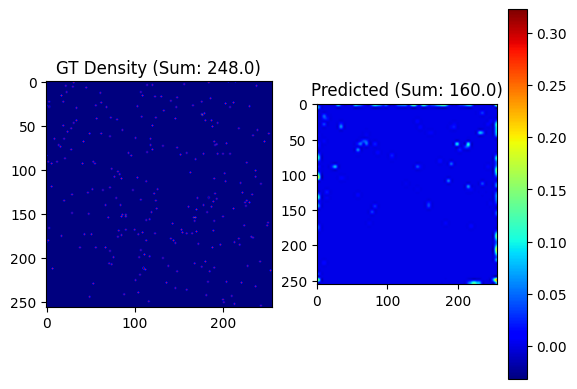

Epoch 29/30:
Train Loss: 4.592637, Val Loss: 3.275542, MAE: 39.58
275.9988708496094

 True count: 98.0, Predicted count: 110.4


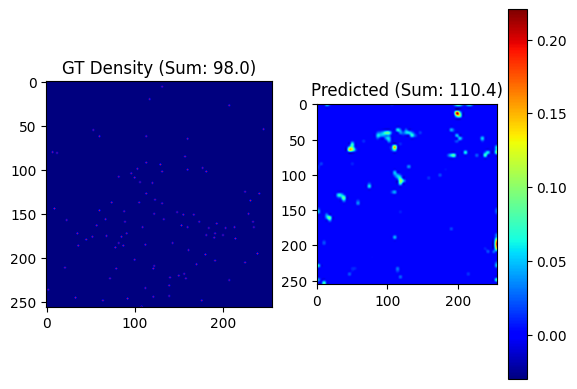

Epoch 30/30:
Train Loss: 6.170028, Val Loss: 4.203211, MAE: 44.21


In [211]:
train_losses, val_losses = train_unet(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    optimizer=optimizer,
    criterion=mse_with_count_regularization,
    device=device,
    num_epochs=30
)


## Expeiment 1: Adam, lr 1e-4, weight_decay 1e-4, sigma - 0.8, bicubic with pretrained weights resnet 34

13895.0126953125

 True count: 292.0, Predicted count: 1543.6


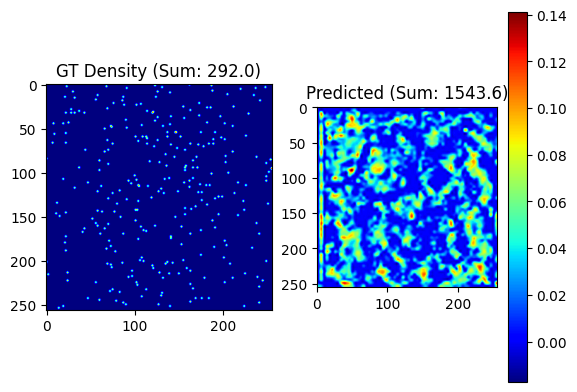

Epoch 1/30:
Train Loss: 34144.444453, Val Loss: 2982.296712, MAE: 1720.30
Model saved with Val Loss: 2982.2967
3309.0302734375

 True count: 98.0, Predicted count: 706.1


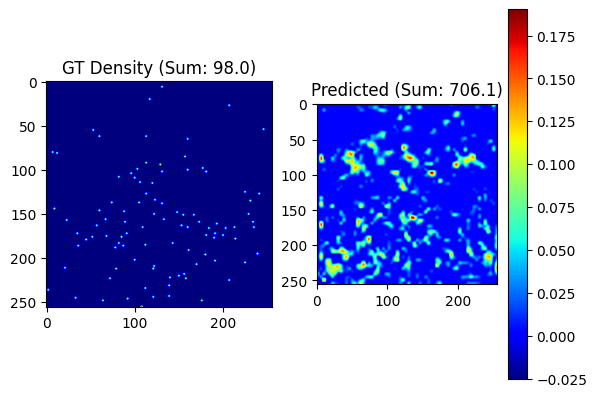

Epoch 2/30:
Train Loss: 1895.897683, Val Loss: 175.862096, MAE: 381.22
Model saved with Val Loss: 175.8621
751.7180786132812

 True count: 153.0, Predicted count: 217.4


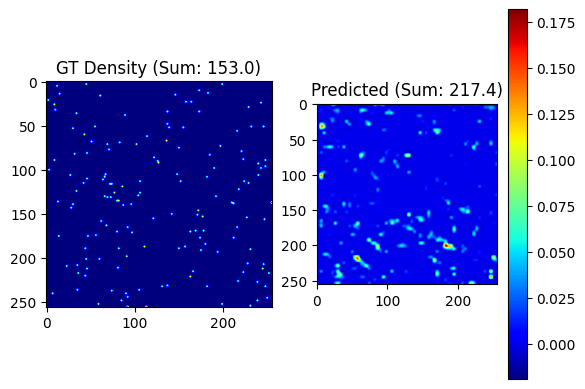

Epoch 3/30:
Train Loss: 188.765054, Val Loss: 8.555627, MAE: 82.50
Model saved with Val Loss: 8.5556
474.0377197265625

 True count: 98.0, Predicted count: 206.8


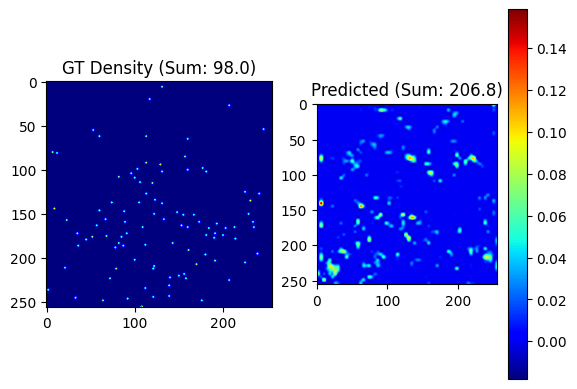

Epoch 4/30:
Train Loss: 83.800913, Val Loss: 4.694551, MAE: 56.56
Model saved with Val Loss: 4.6946
425.37005615234375

 True count: 248.0, Predicted count: 233.3


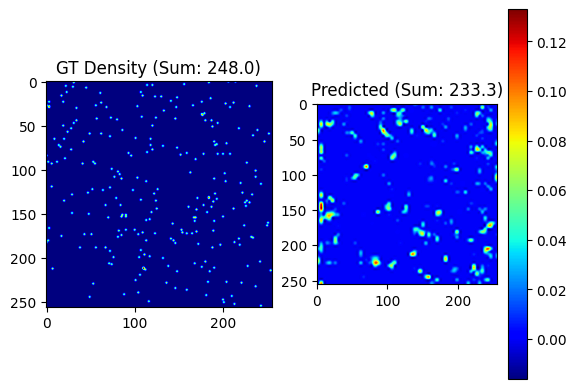

Epoch 5/30:
Train Loss: 67.957823, Val Loss: 5.323609, MAE: 56.87
401.247802734375

 True count: 224.0, Predicted count: 186.2


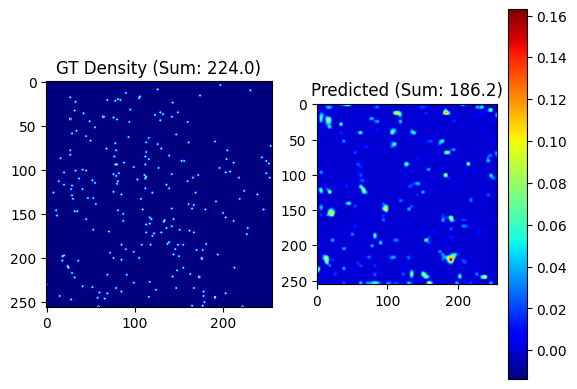

Epoch 6/30:
Train Loss: 36.780036, Val Loss: 5.311997, MAE: 55.46
425.7641296386719

 True count: 248.0, Predicted count: 144.5


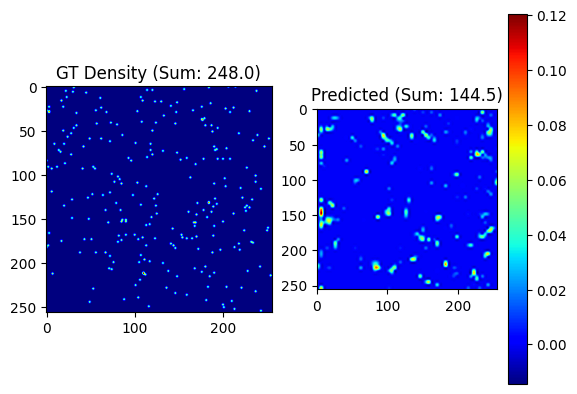

Epoch 7/30:
Train Loss: 14.309111, Val Loss: 12.310335, MAE: 77.06
508.4476013183594

 True count: 292.0, Predicted count: 133.8


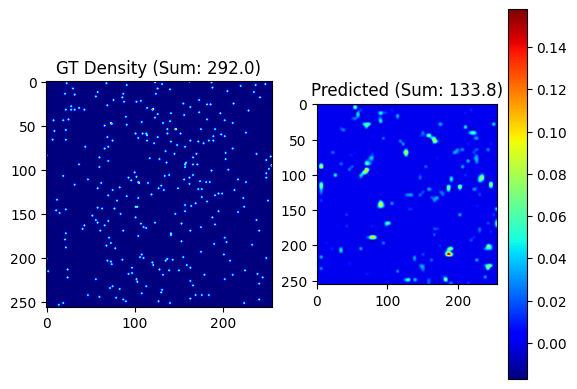

Epoch 8/30:
Train Loss: 22.535201, Val Loss: 5.998268, MAE: 63.21
392.9811706542969

 True count: 95.0, Predicted count: 112.2


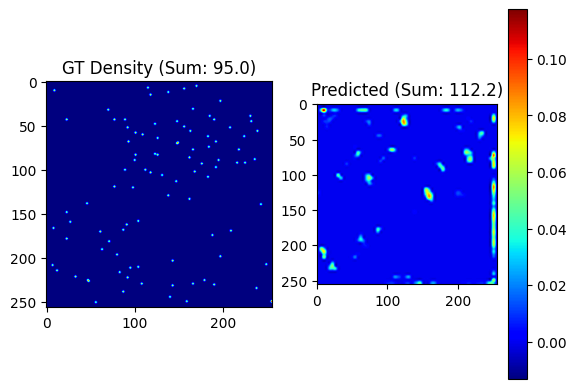

Epoch 9/30:
Train Loss: 10.828231, Val Loss: 8.125146, MAE: 72.06
849.0379028320312

 True count: 218.0, Predicted count: 61.0


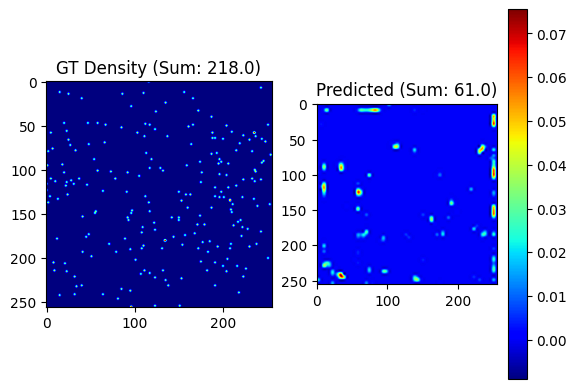

Epoch 10/30:
Train Loss: 7.665563, Val Loss: 8.762963, MAE: 79.56
345.38720703125

 True count: 200.0, Predicted count: 116.0


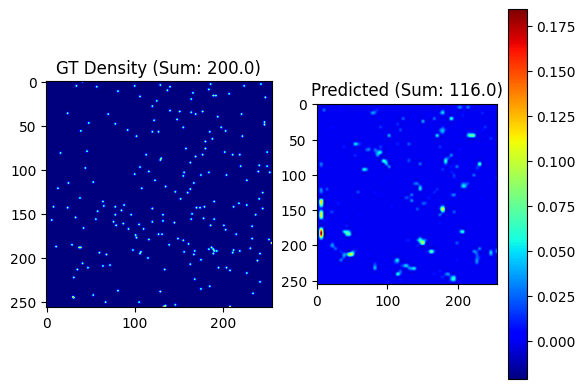

Epoch 11/30:
Train Loss: 11.708035, Val Loss: 7.276860, MAE: 62.22
647.49169921875

 True count: 154.0, Predicted count: 101.8


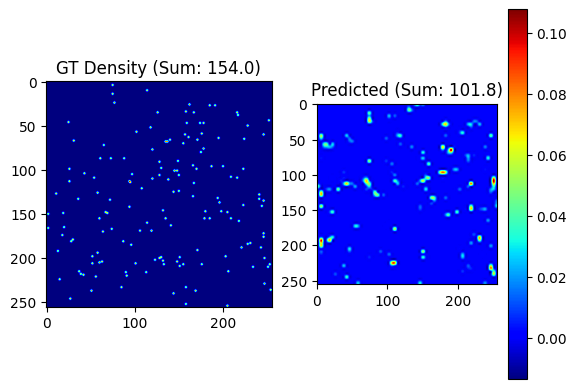

Epoch 12/30:
Train Loss: 18.212012, Val Loss: 4.418981, MAE: 57.79
Model saved with Val Loss: 4.4190
814.0384521484375

 True count: 200.0, Predicted count: 92.4


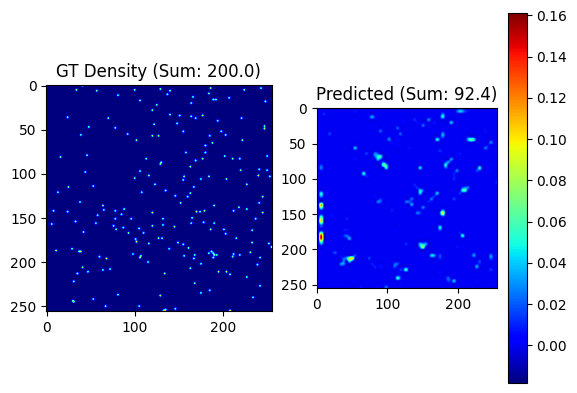

Epoch 13/30:
Train Loss: 9.982847, Val Loss: 8.290906, MAE: 74.82
523.9569702148438

 True count: 132.0, Predicted count: 131.9


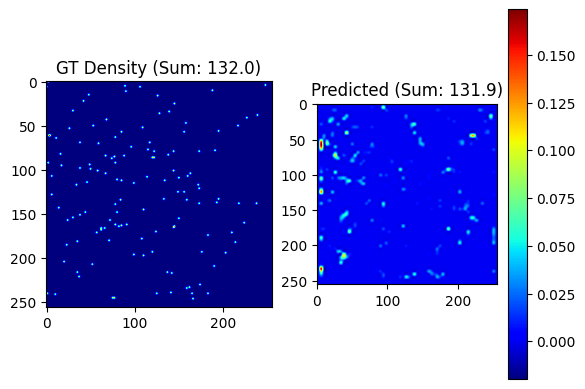

Epoch 14/30:
Train Loss: 7.397375, Val Loss: 6.019110, MAE: 61.43
489.09002685546875

 True count: 218.0, Predicted count: 152.7


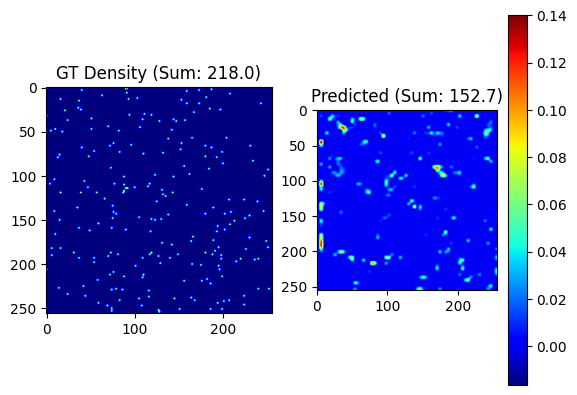

Epoch 15/30:
Train Loss: 11.358226, Val Loss: 7.720970, MAE: 73.69
751.5830688476562

 True count: 273.0, Predicted count: 99.8


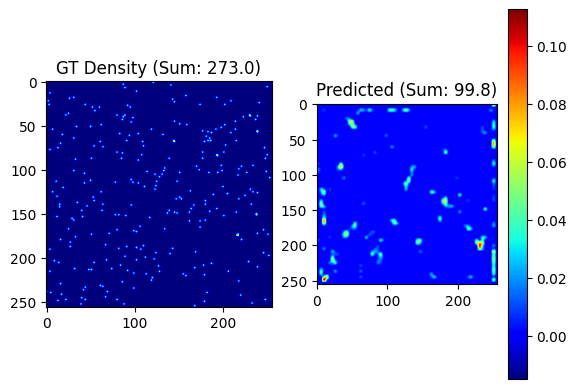

Epoch 16/30:
Train Loss: 8.876206, Val Loss: 10.675435, MAE: 87.88
757.8892822265625

 True count: 292.0, Predicted count: 114.7


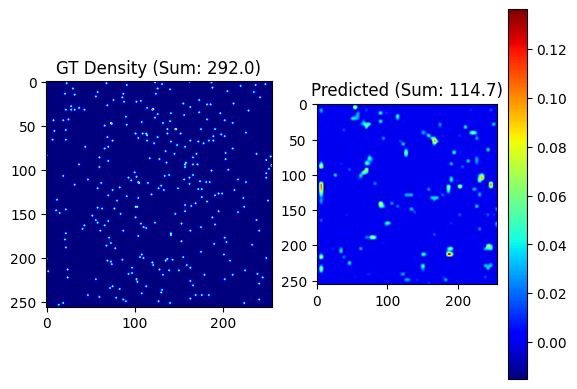

Epoch 17/30:
Train Loss: 10.825742, Val Loss: 8.274080, MAE: 69.87
600.554443359375

 True count: 292.0, Predicted count: 119.0


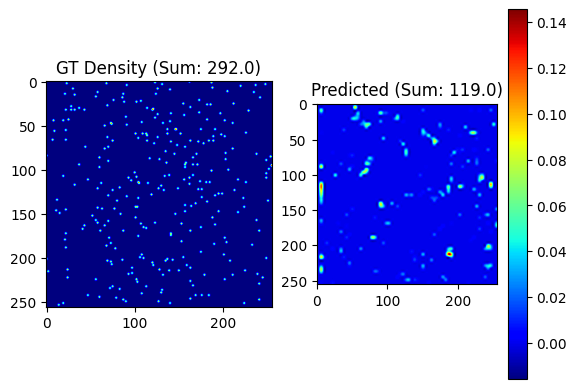

Epoch 18/30:
Train Loss: 8.616130, Val Loss: 5.585775, MAE: 64.13
472.4497985839844

 True count: 132.0, Predicted count: 122.7


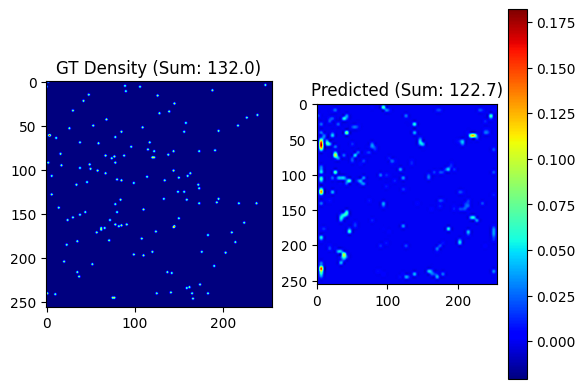

Epoch 19/30:
Train Loss: 8.796695, Val Loss: 7.801911, MAE: 64.62
414.1832275390625

 True count: 86.0, Predicted count: 86.7


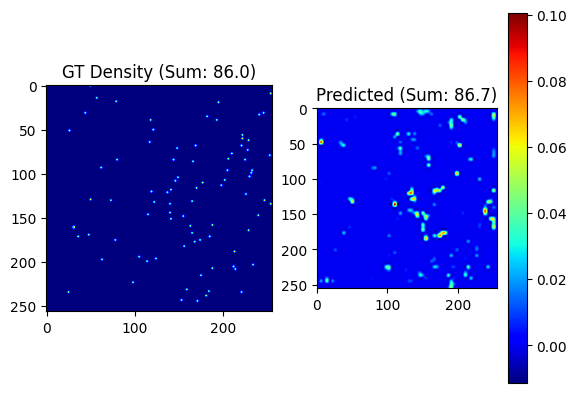

Epoch 20/30:
Train Loss: 6.649077, Val Loss: 4.481199, MAE: 54.89
496.51971435546875

 True count: 84.0, Predicted count: 64.1


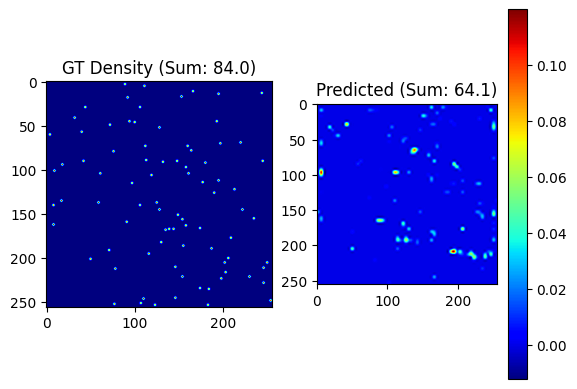

Epoch 21/30:
Train Loss: 11.702699, Val Loss: 10.823381, MAE: 83.56
528.13720703125

 True count: 86.0, Predicted count: 64.8


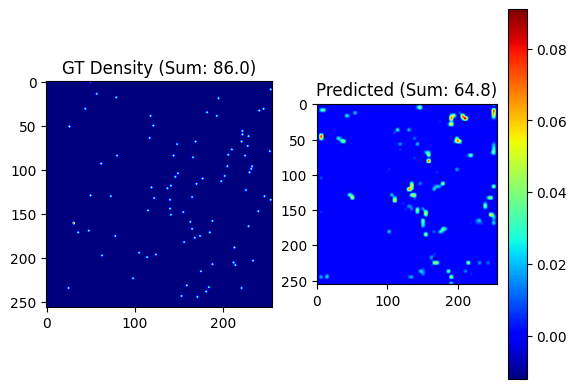

Epoch 22/30:
Train Loss: 7.138795, Val Loss: 8.172440, MAE: 74.68
412.4297790527344

 True count: 200.0, Predicted count: 139.7


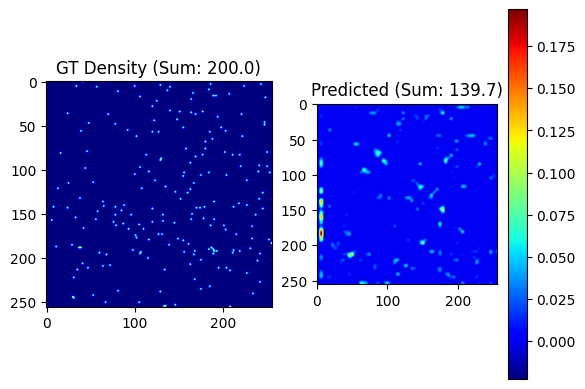

Epoch 23/30:
Train Loss: 8.626334, Val Loss: 2.991941, MAE: 44.48
Model saved with Val Loss: 2.9919
644.8285522460938

 True count: 124.0, Predicted count: 89.5


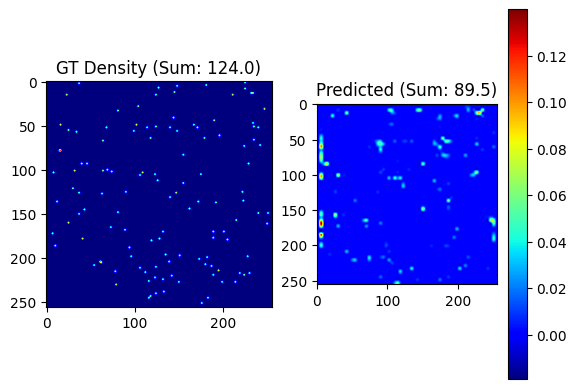

Epoch 24/30:
Train Loss: 7.589686, Val Loss: 3.986497, MAE: 51.82
399.51556396484375

 True count: 244.0, Predicted count: 145.9


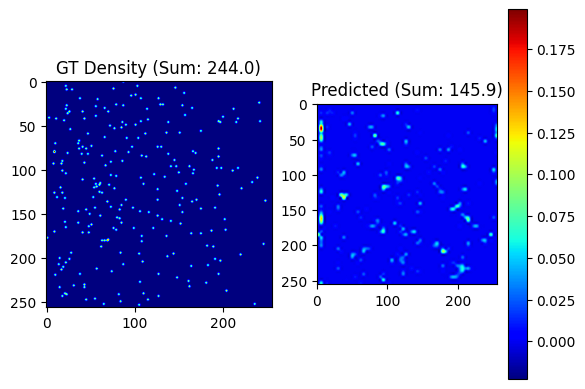

Epoch 25/30:
Train Loss: 5.278130, Val Loss: 4.410732, MAE: 51.36
325.3775634765625

 True count: 200.0, Predicted count: 176.7


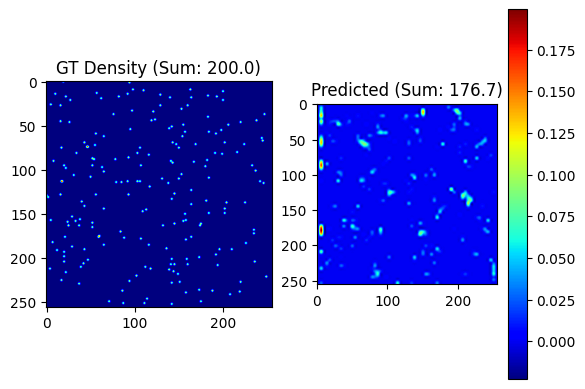

Epoch 26/30:
Train Loss: 7.497931, Val Loss: 2.824278, MAE: 40.75
Model saved with Val Loss: 2.8243
459.37982177734375

 True count: 200.0, Predicted count: 145.1


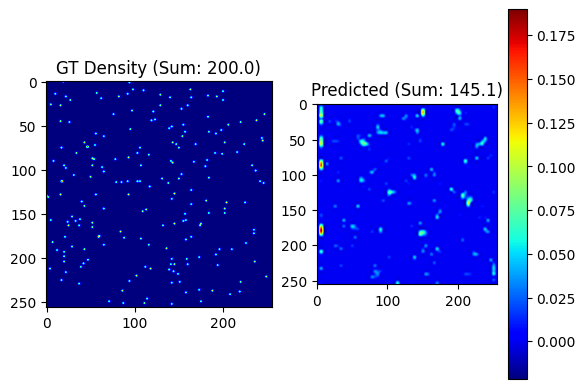

Epoch 27/30:
Train Loss: 6.518070, Val Loss: 5.076462, MAE: 53.39
224.78025817871094

 True count: 128.0, Predicted count: 106.5


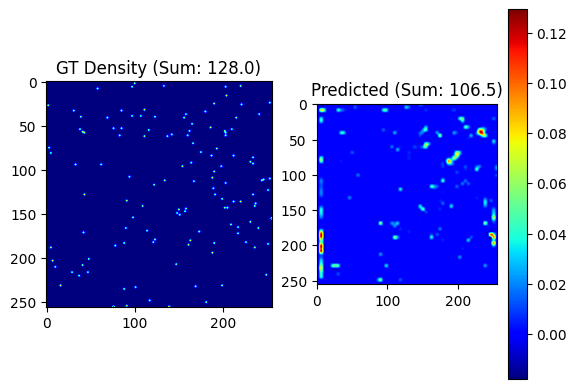

Epoch 28/30:
Train Loss: 5.289837, Val Loss: 2.673155, MAE: 40.00
Model saved with Val Loss: 2.6732
397.21514892578125

 True count: 292.0, Predicted count: 185.5


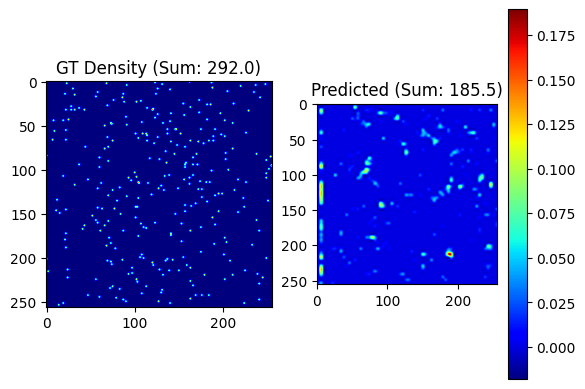

Epoch 29/30:
Train Loss: 5.082951, Val Loss: 2.786522, MAE: 42.22
428.911376953125

 True count: 273.0, Predicted count: 135.8


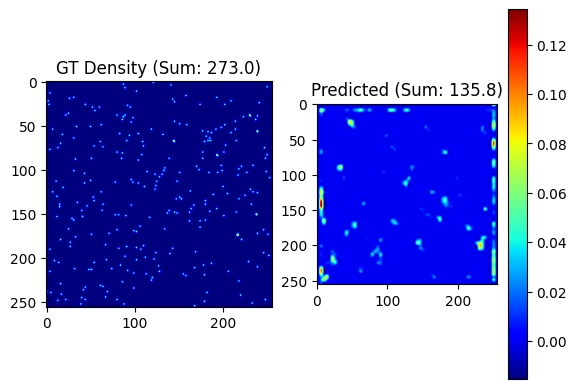

Epoch 30/30:
Train Loss: 6.174381, Val Loss: 2.703098, MAE: 43.85


In [13]:
train_losses, val_losses = train_unet(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    optimizer=optimizer,
    criterion=mse_with_count_regularization,
    device=device,
    num_epochs=30
)


Expeiment 4: Adam, lr 1e-4, weight_decay 1e-4, sigma - 1, bicubic with pretrained weights resnet 34, rotation to image and desity maps (same angle)

15161.8779296875

 True count: 84.0, Predicted count: 1501.6


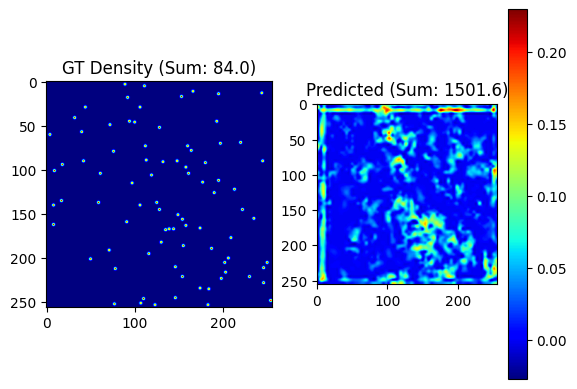

Epoch 1/30:
Train Loss: 42118.116593, Val Loss: 5916.028809, MAE: 2021.42
Model saved with Val Loss: 5916.0288
6451.50390625

 True count: 154.0, Predicted count: 1023.0


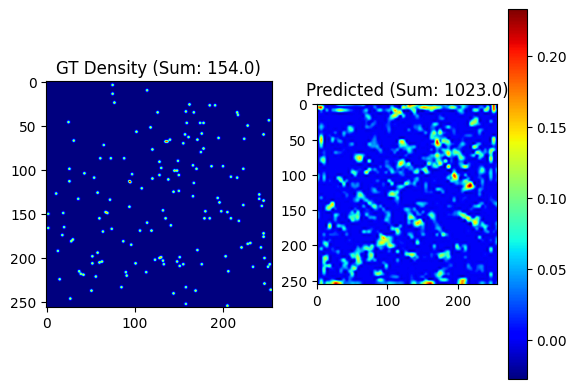

Epoch 2/30:
Train Loss: 3348.017399, Val Loss: 447.183665, MAE: 646.77
Model saved with Val Loss: 447.1837
3078.05810546875

 True count: 132.0, Predicted count: 712.5


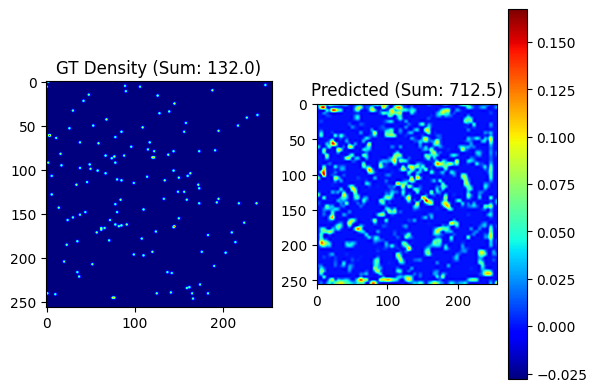

Epoch 3/30:
Train Loss: 522.613355, Val Loss: 255.029846, MAE: 455.57
Model saved with Val Loss: 255.0298
918.45849609375

 True count: 200.0, Predicted count: 347.5


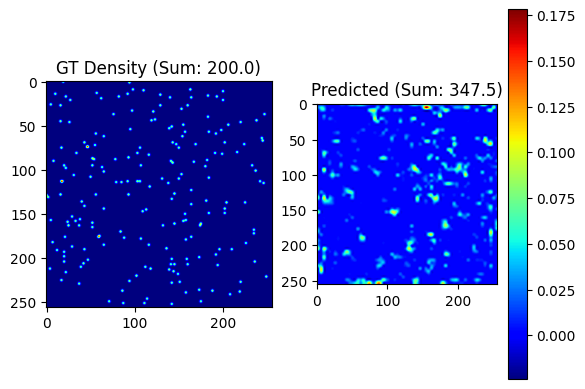

Epoch 4/30:
Train Loss: 167.933655, Val Loss: 20.102228, MAE: 131.01
Model saved with Val Loss: 20.1022
1098.9716796875

 True count: 248.0, Predicted count: 405.4


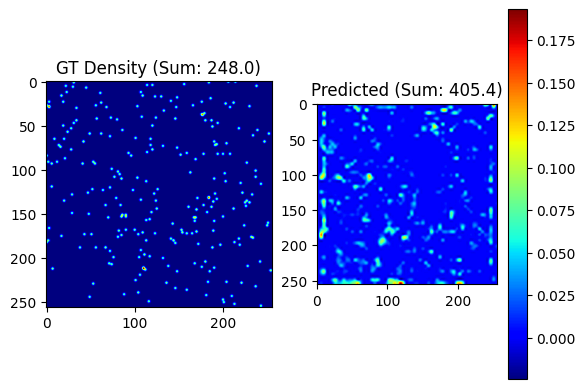

Epoch 5/30:
Train Loss: 82.446417, Val Loss: 22.066076, MAE: 134.04
799.1431884765625

 True count: 200.0, Predicted count: 306.8


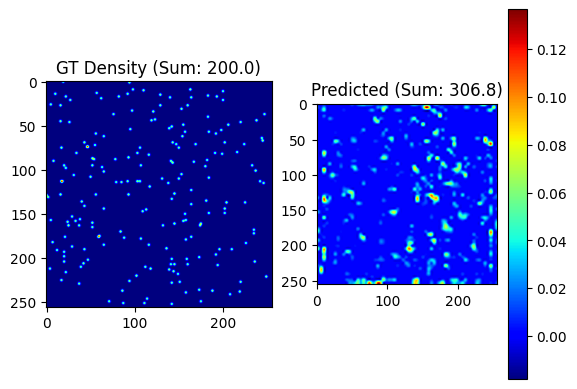

Epoch 6/30:
Train Loss: 50.457268, Val Loss: 9.537025, MAE: 91.16
Model saved with Val Loss: 9.5370
849.554931640625

 True count: 292.0, Predicted count: 125.5


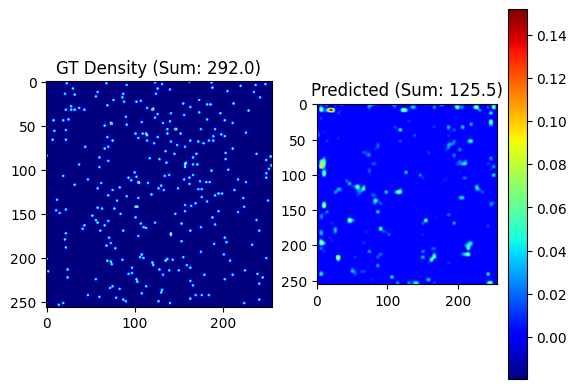

Epoch 7/30:
Train Loss: 67.040307, Val Loss: 13.134629, MAE: 106.03
443.01483154296875

 True count: 200.0, Predicted count: 140.4


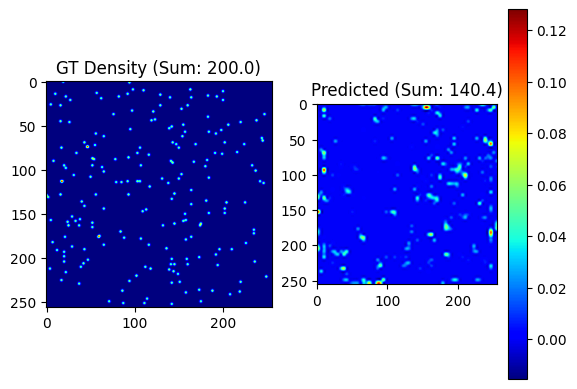

Epoch 8/30:
Train Loss: 23.921965, Val Loss: 7.363062, MAE: 54.10
Model saved with Val Loss: 7.3631
426.7922058105469

 True count: 292.0, Predicted count: 218.6


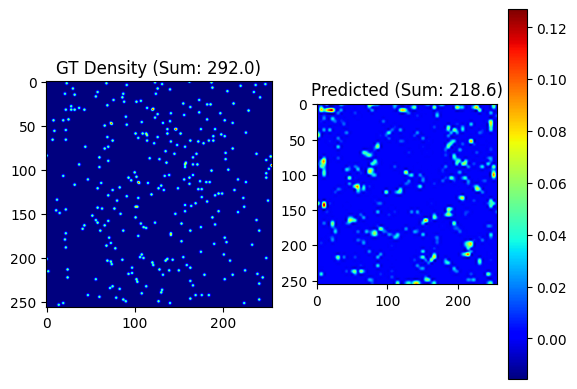

Epoch 9/30:
Train Loss: 56.420750, Val Loss: 3.776396, MAE: 52.18
Model saved with Val Loss: 3.7764
643.6651611328125

 True count: 248.0, Predicted count: 147.4


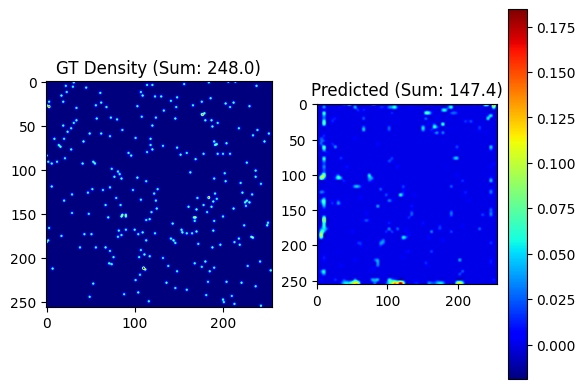

Epoch 10/30:
Train Loss: 33.797903, Val Loss: 9.398813, MAE: 81.52
452.9238586425781

 True count: 273.0, Predicted count: 70.2


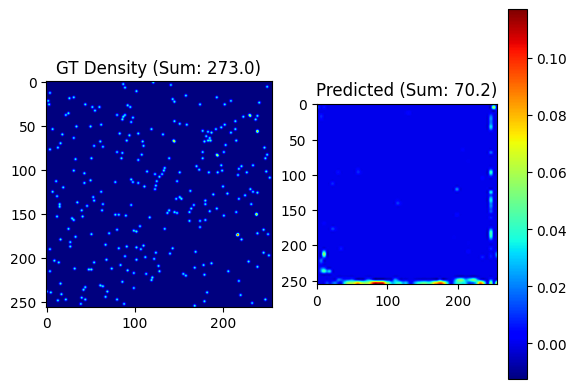

Epoch 11/30:
Train Loss: 29.827225, Val Loss: 3.965792, MAE: 45.56
550.1673583984375

 True count: 224.0, Predicted count: 117.4


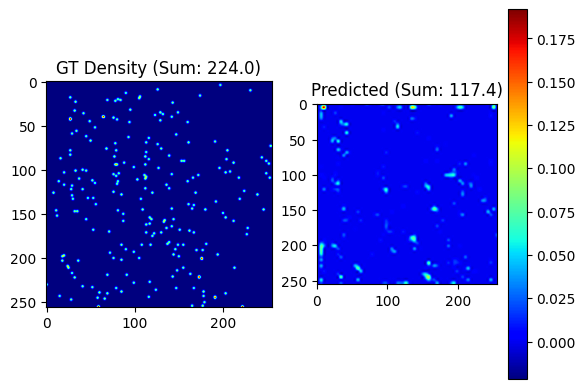

Epoch 12/30:
Train Loss: 36.869466, Val Loss: 10.584265, MAE: 88.35
486.9176025390625

 True count: 248.0, Predicted count: 169.1


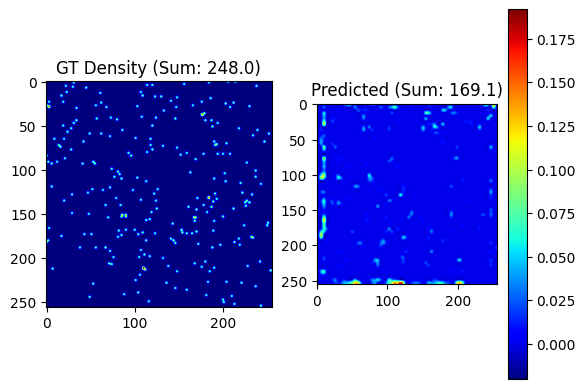

Epoch 13/30:
Train Loss: 18.375704, Val Loss: 7.817264, MAE: 63.15
345.3602294921875

 True count: 200.0, Predicted count: 163.0


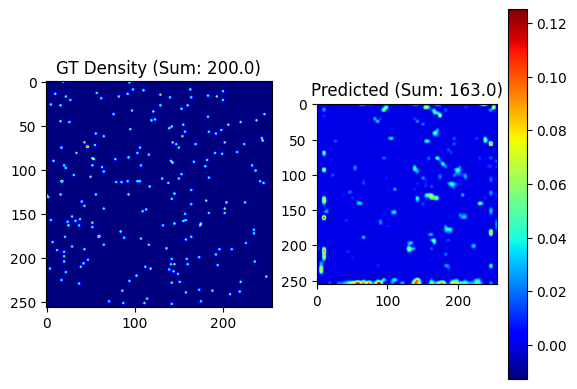

Epoch 14/30:
Train Loss: 11.771095, Val Loss: 4.478469, MAE: 47.00
426.6644592285156

 True count: 156.0, Predicted count: 99.4


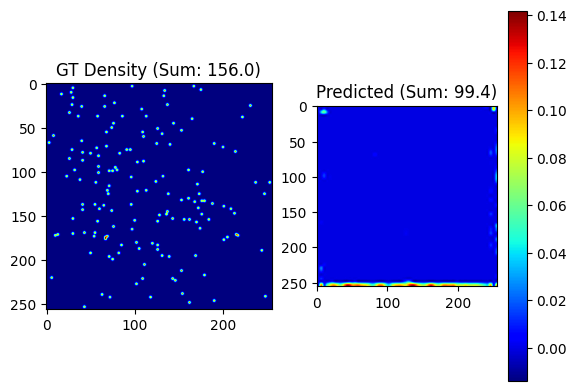

Epoch 15/30:
Train Loss: 21.218490, Val Loss: 4.815957, MAE: 45.86
488.10601806640625

 True count: 154.0, Predicted count: 182.0


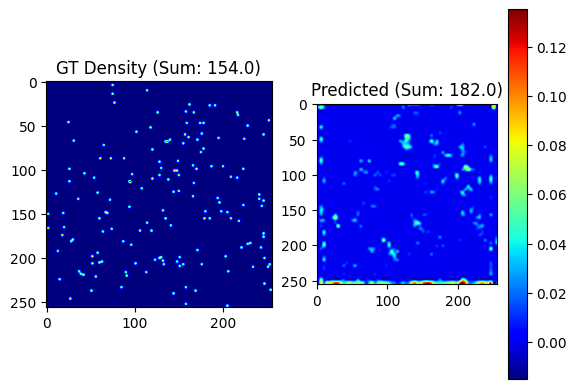

Epoch 16/30:
Train Loss: 19.130594, Val Loss: 3.255501, MAE: 43.66
Model saved with Val Loss: 3.2555
498.1949768066406

 True count: 218.0, Predicted count: 134.8


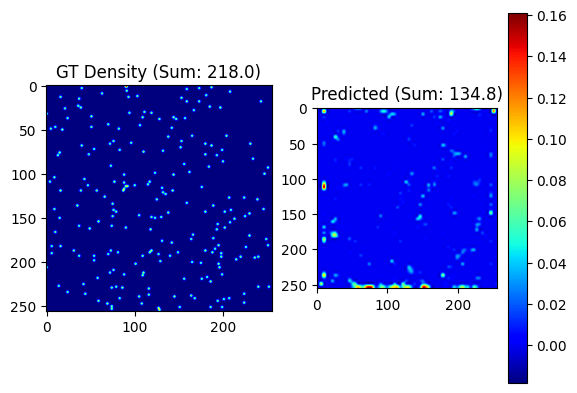

Epoch 17/30:
Train Loss: 14.103901, Val Loss: 8.330765, MAE: 66.75
394.8530578613281

 True count: 218.0, Predicted count: 159.2


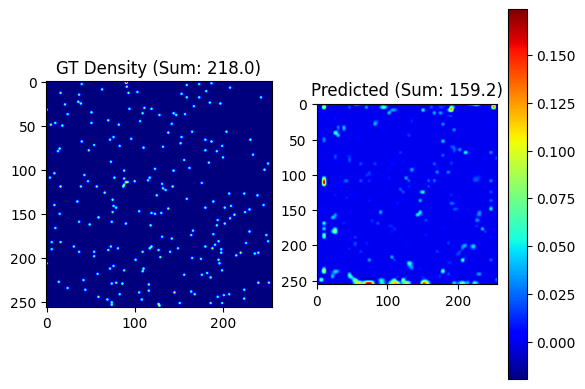

Epoch 18/30:
Train Loss: 19.104745, Val Loss: 5.095049, MAE: 53.06
468.6341552734375

 True count: 153.0, Predicted count: 109.9


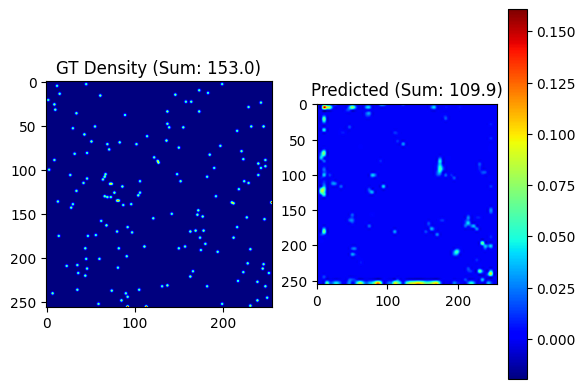

Epoch 19/30:
Train Loss: 16.710324, Val Loss: 6.919150, MAE: 66.24
369.3092346191406

 True count: 218.0, Predicted count: 105.0


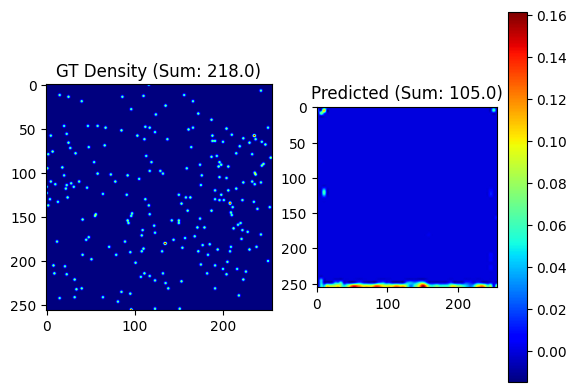

Epoch 20/30:
Train Loss: 13.906805, Val Loss: 4.690725, MAE: 54.72
681.6671752929688

 True count: 292.0, Predicted count: 136.3


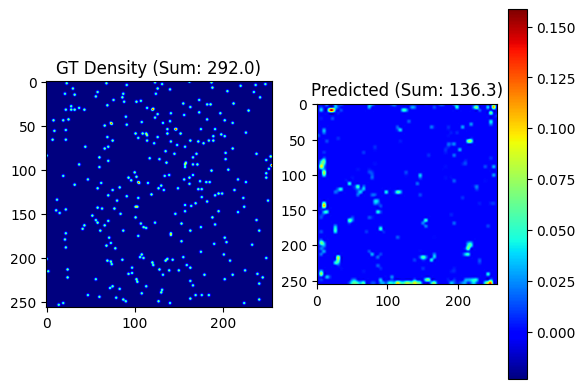

Epoch 21/30:
Train Loss: 16.133121, Val Loss: 6.233703, MAE: 64.70
444.20849609375

 True count: 95.0, Predicted count: 185.3


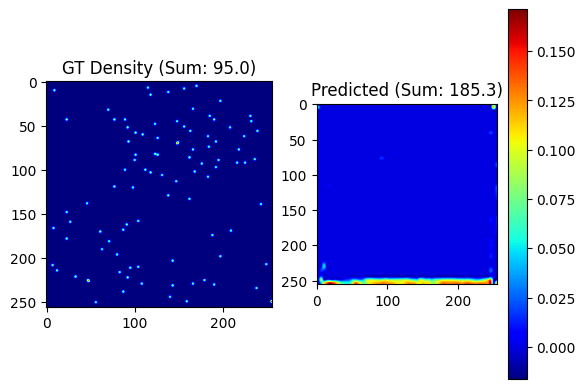

Epoch 22/30:
Train Loss: 11.939119, Val Loss: 3.208632, MAE: 50.78
Model saved with Val Loss: 3.2086
296.29034423828125

 True count: 153.0, Predicted count: 138.9


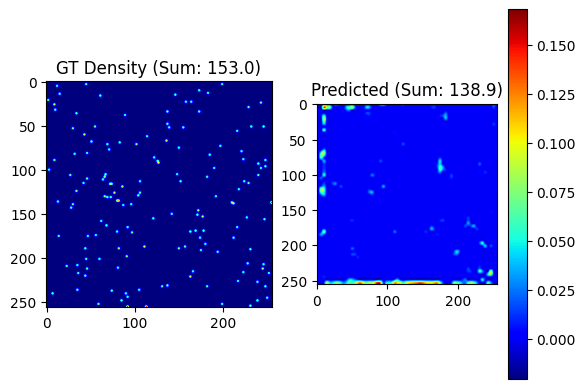

Epoch 23/30:
Train Loss: 19.000207, Val Loss: 4.713929, MAE: 46.83
530.040283203125

 True count: 292.0, Predicted count: 165.9


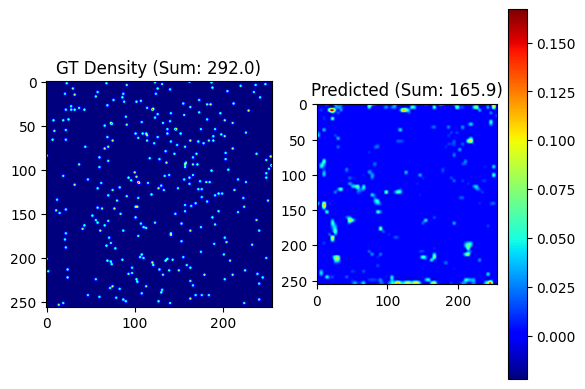

Epoch 24/30:
Train Loss: 11.604179, Val Loss: 5.006931, MAE: 52.97
399.872802734375

 True count: 84.0, Predicted count: 99.5


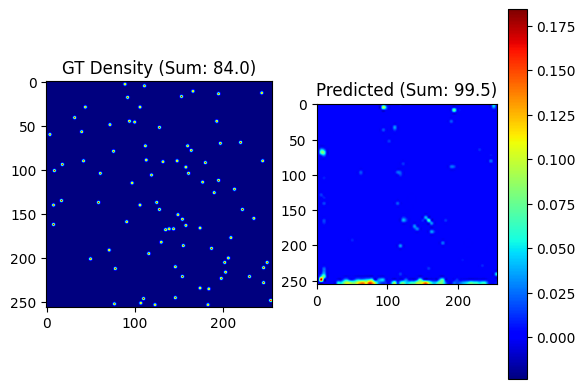

Epoch 25/30:
Train Loss: 11.049186, Val Loss: 4.811619, MAE: 59.98
576.4696655273438

 True count: 244.0, Predicted count: 172.9


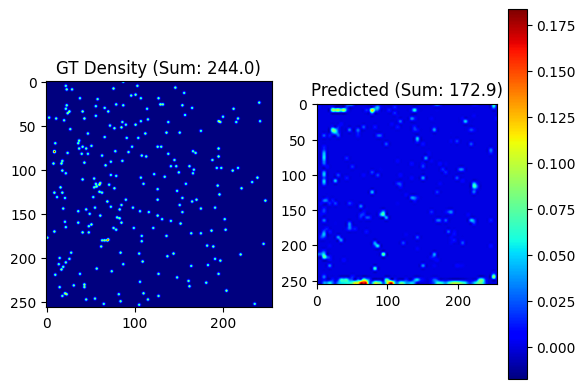

Epoch 26/30:
Train Loss: 14.512132, Val Loss: 3.064554, MAE: 47.85
Model saved with Val Loss: 3.0646
451.04998779296875

 True count: 98.0, Predicted count: 113.4


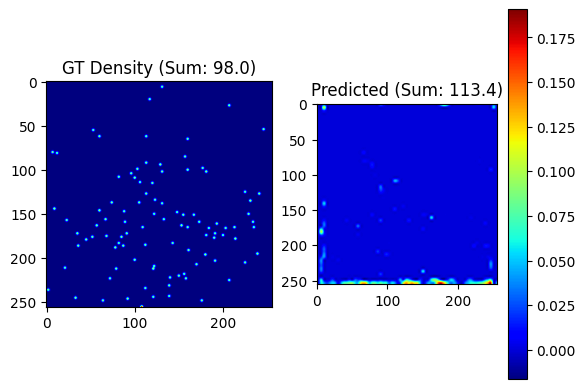

Epoch 27/30:
Train Loss: 15.132743, Val Loss: 4.056252, MAE: 51.01
541.477783203125

 True count: 218.0, Predicted count: 136.7


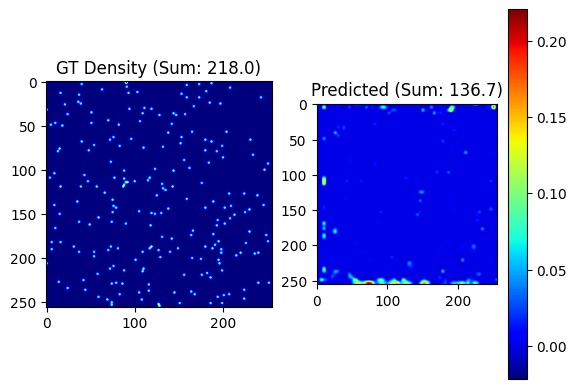

Epoch 28/30:
Train Loss: 9.295926, Val Loss: 3.624419, MAE: 50.42
513.0179443359375

 True count: 248.0, Predicted count: 183.6


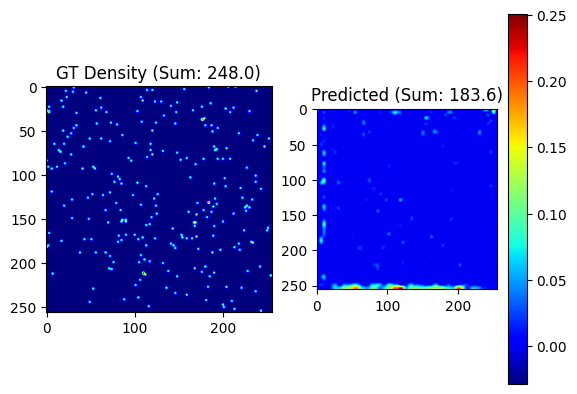

Epoch 29/30:
Train Loss: 8.150941, Val Loss: 3.837059, MAE: 51.27
526.68701171875

 True count: 248.0, Predicted count: 180.8


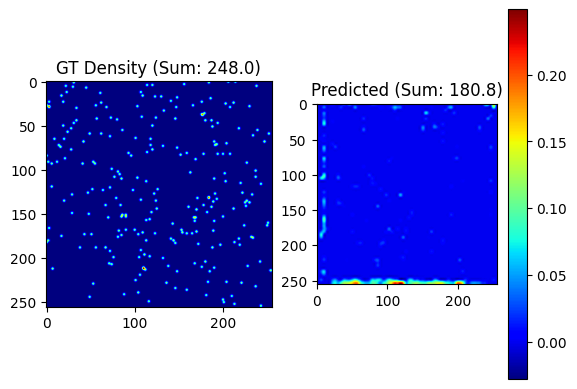

Epoch 30/30:
Train Loss: 8.858454, Val Loss: 3.489756, MAE: 50.52


In [43]:
train_losses, val_losses = train_unet(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    optimizer=optimizer,
    criterion=mse_with_count_regularization,
    device=device,
    num_epochs=30
)

Expeiment 4: Adam, lr 1e-4, weight_decay 1e-4, sigma - 1, bicubic with pretrained weights resnet 34, rotation to image and desity maps (same angle)

1089.2100830078125

 True count: 200.0, Predicted count: 332.0


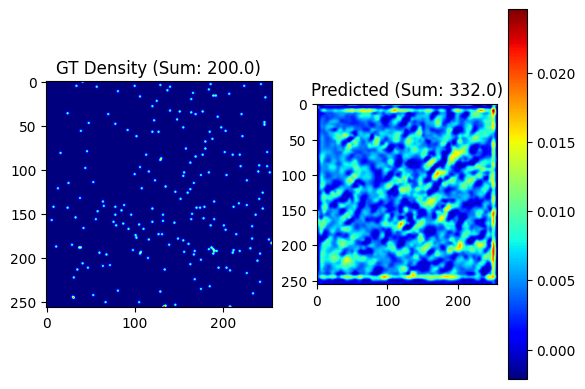

Epoch 1/30:
Train Loss: 5.921563, Val Loss: 23.519348, MAE: 145.03
Model saved with Val Loss: 23.5193
166.84249877929688

 True count: 224.0, Predicted count: 244.6


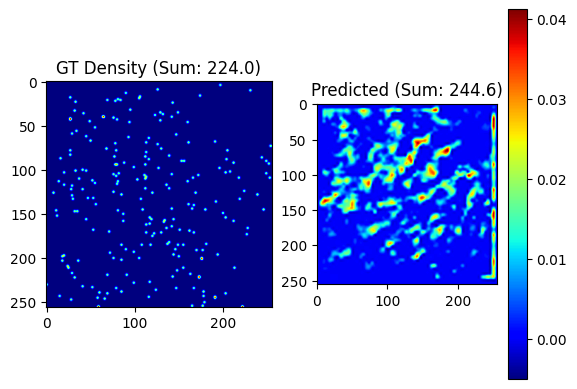

Epoch 2/30:
Train Loss: 3.386750, Val Loss: 1.220019, MAE: 23.74
Model saved with Val Loss: 1.2200
155.5753631591797

 True count: 156.0, Predicted count: 187.2


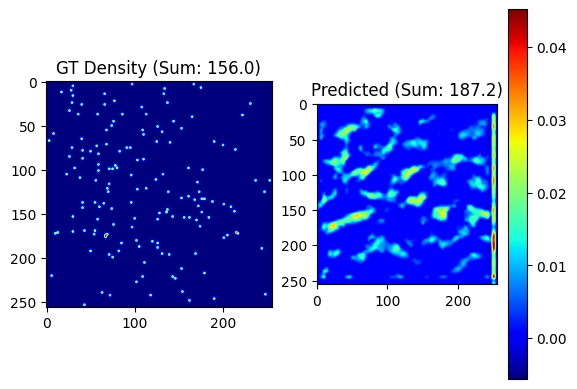

Epoch 3/30:
Train Loss: 2.569307, Val Loss: 0.691897, MAE: 20.85
Model saved with Val Loss: 0.6919
233.14573669433594

 True count: 124.0, Predicted count: 99.2


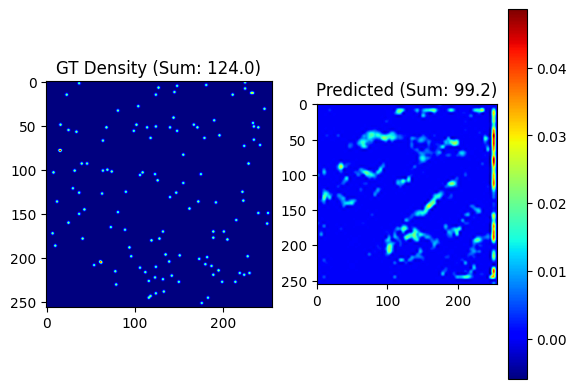

Epoch 4/30:
Train Loss: 2.308868, Val Loss: 0.730680, MAE: 23.54
204.93458557128906

 True count: 153.0, Predicted count: 161.7


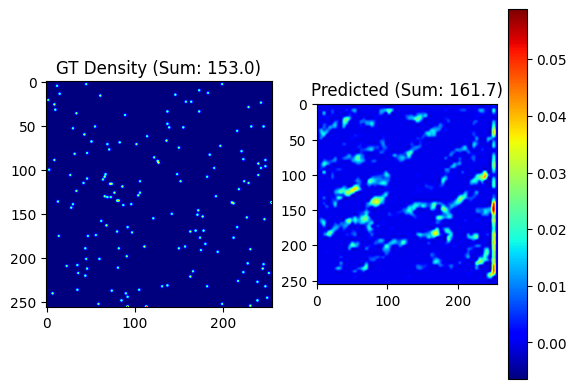

Epoch 5/30:
Train Loss: 1.208741, Val Loss: 0.794730, MAE: 22.14
404.603271484375

 True count: 273.0, Predicted count: 218.1


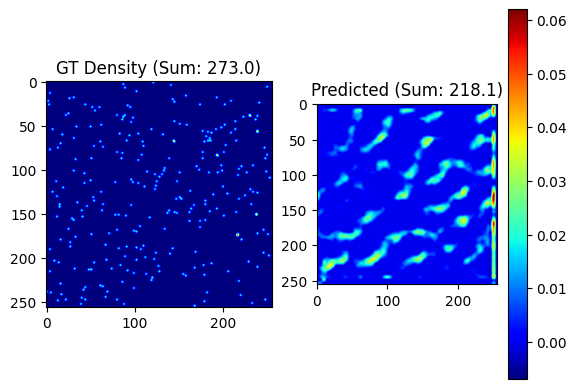

Epoch 6/30:
Train Loss: 1.455474, Val Loss: 2.096740, MAE: 40.57
180.00601196289062

 True count: 153.0, Predicted count: 119.2


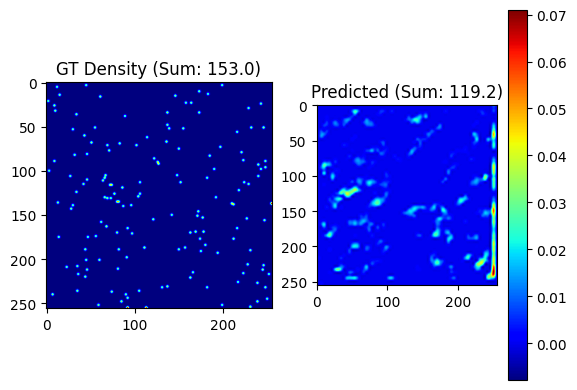

Epoch 7/30:
Train Loss: 1.222749, Val Loss: 0.410152, MAE: 17.29
Model saved with Val Loss: 0.4102
192.42489624023438

 True count: 128.0, Predicted count: 127.9


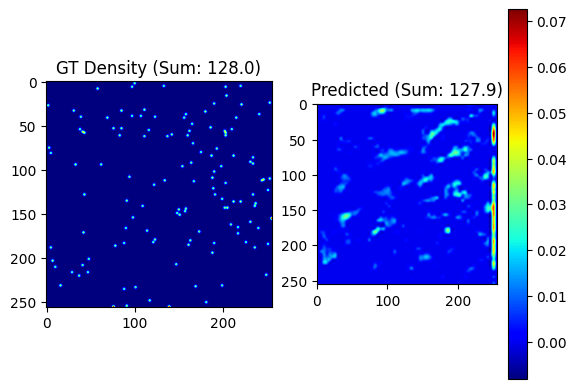

Epoch 8/30:
Train Loss: 1.233785, Val Loss: 0.686369, MAE: 21.86
141.8717041015625

 True count: 200.0, Predicted count: 196.9


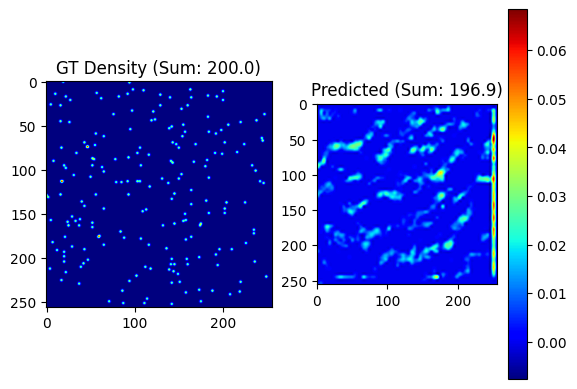

Epoch 9/30:
Train Loss: 1.133190, Val Loss: 0.463052, MAE: 17.63
122.04716491699219

 True count: 200.0, Predicted count: 212.1


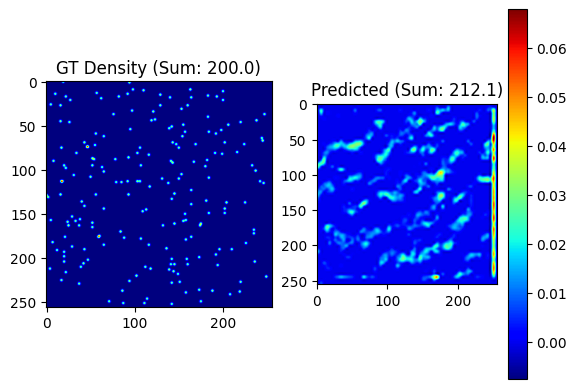

Epoch 10/30:
Train Loss: 1.006185, Val Loss: 0.327509, MAE: 14.50
Model saved with Val Loss: 0.3275
156.94076538085938

 True count: 86.0, Predicted count: 64.7


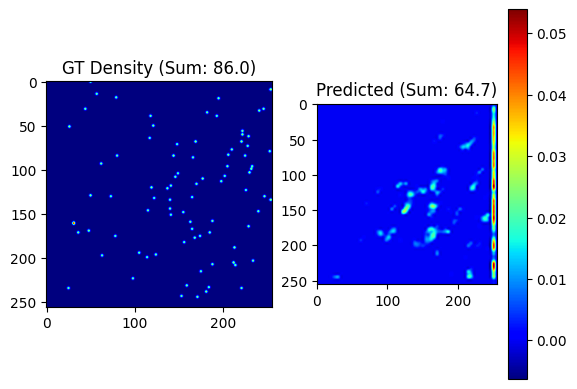

Epoch 11/30:
Train Loss: 0.640233, Val Loss: 0.408638, MAE: 15.07
176.8525390625

 True count: 200.0, Predicted count: 220.7


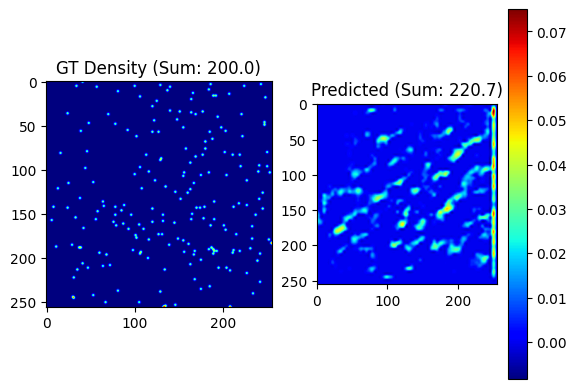

Epoch 12/30:
Train Loss: 0.619820, Val Loss: 0.634285, MAE: 19.20
128.5277862548828

 True count: 200.0, Predicted count: 203.9


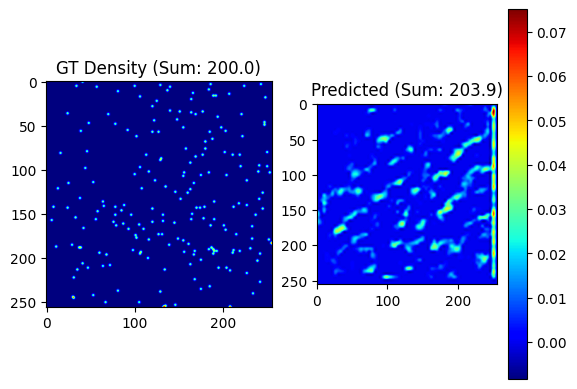

Epoch 13/30:
Train Loss: 0.565120, Val Loss: 0.266601, MAE: 12.81
Model saved with Val Loss: 0.2666
101.25117492675781

 True count: 218.0, Predicted count: 260.7


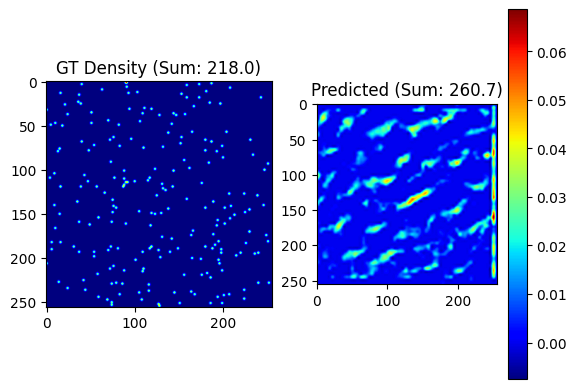

Epoch 14/30:
Train Loss: 0.513291, Val Loss: 0.527449, MAE: 16.12
151.61904907226562

 True count: 273.0, Predicted count: 244.1


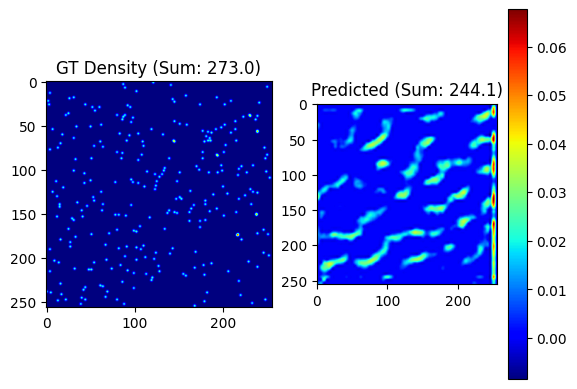

Epoch 15/30:
Train Loss: 0.684176, Val Loss: 0.206621, MAE: 12.48
Model saved with Val Loss: 0.2066
104.87520599365234

 True count: 244.0, Predicted count: 235.4


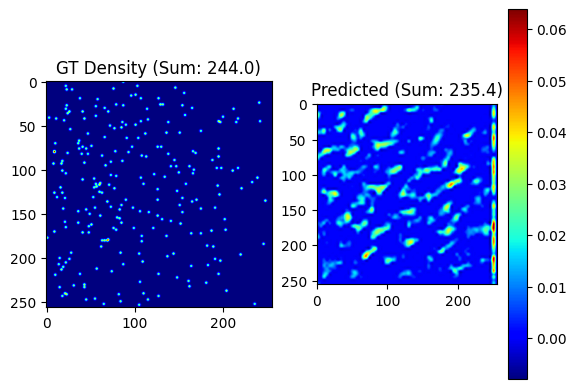

Epoch 16/30:
Train Loss: 0.514441, Val Loss: 0.158049, MAE: 9.87
Model saved with Val Loss: 0.1580
147.32164001464844

 True count: 273.0, Predicted count: 243.5


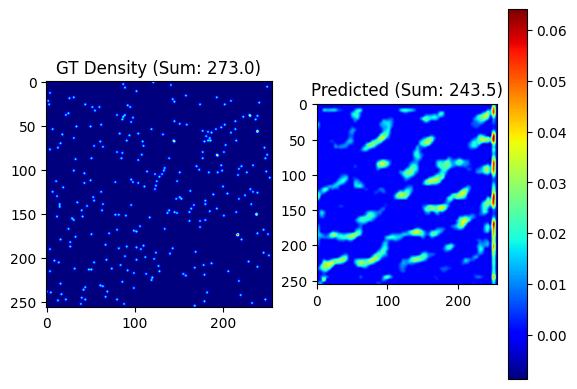

Epoch 17/30:
Train Loss: 0.467479, Val Loss: 0.402539, MAE: 17.00
59.42988586425781

 True count: 218.0, Predicted count: 210.3


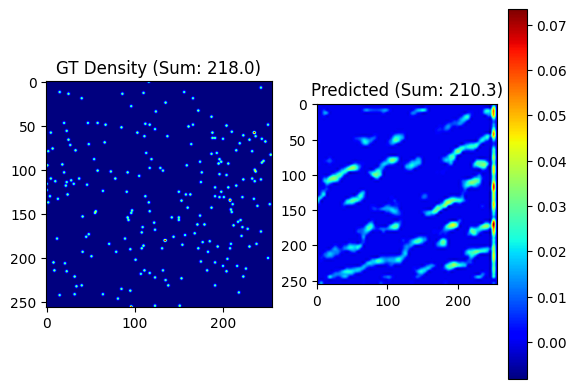

Epoch 18/30:
Train Loss: 0.680634, Val Loss: 0.214851, MAE: 10.70
84.73635864257812

 True count: 124.0, Predicted count: 116.6


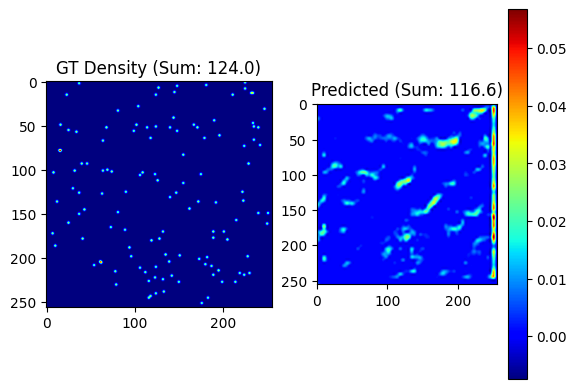

Epoch 19/30:
Train Loss: 0.491651, Val Loss: 0.196147, MAE: 11.01
168.1774444580078

 True count: 244.0, Predicted count: 217.9


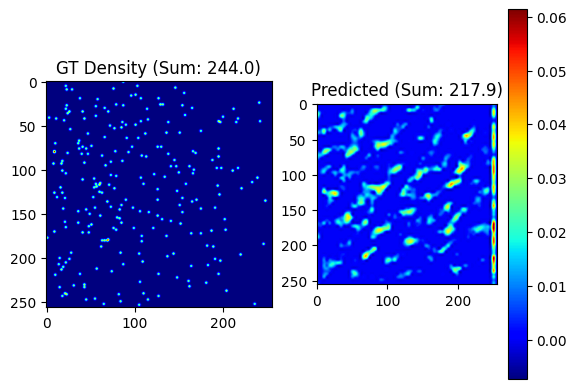

Epoch 20/30:
Train Loss: 0.324442, Val Loss: 0.269077, MAE: 13.68
147.0260009765625

 True count: 292.0, Predicted count: 316.7


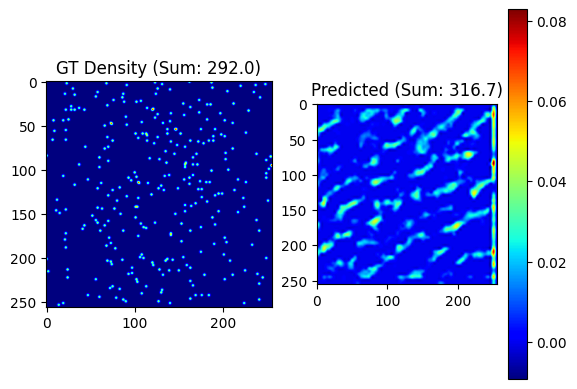

Epoch 21/30:
Train Loss: 0.550805, Val Loss: 0.376627, MAE: 16.03
107.75056457519531

 True count: 124.0, Predicted count: 116.4


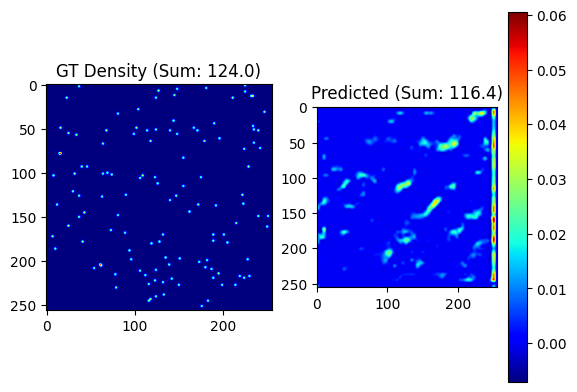

Epoch 22/30:
Train Loss: 0.661508, Val Loss: 0.468304, MAE: 14.08
106.24600982666016

 True count: 86.0, Predicted count: 88.1


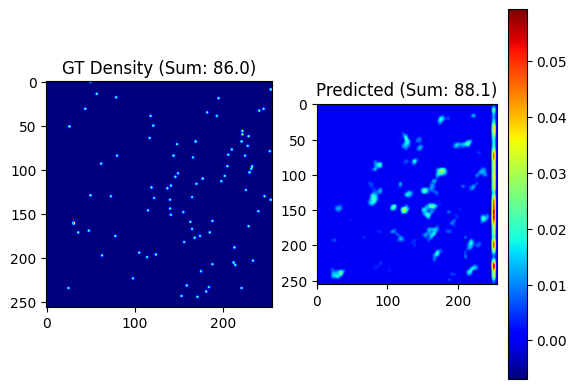

Epoch 23/30:
Train Loss: 0.743590, Val Loss: 0.309692, MAE: 14.63
95.90644073486328

 True count: 98.0, Predicted count: 106.2


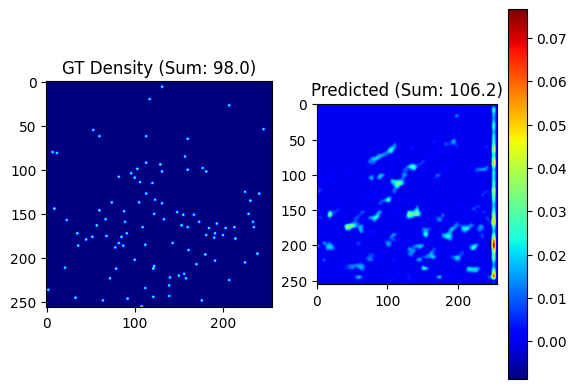

Epoch 24/30:
Train Loss: 0.450119, Val Loss: 0.223224, MAE: 11.92
65.5726089477539

 True count: 79.0, Predicted count: 79.7


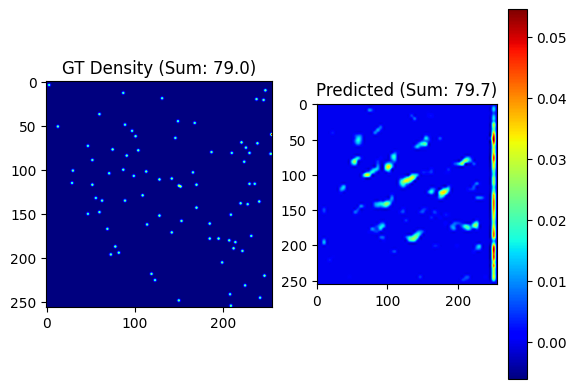

Epoch 25/30:
Train Loss: 0.384765, Val Loss: 0.226853, MAE: 11.02
71.18880462646484

 True count: 124.0, Predicted count: 113.1


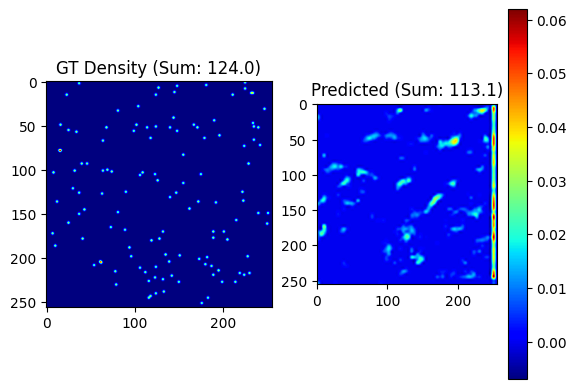

Epoch 26/30:
Train Loss: 0.419400, Val Loss: 0.148406, MAE: 10.57
Model saved with Val Loss: 0.1484
114.32477569580078

 True count: 154.0, Predicted count: 171.6


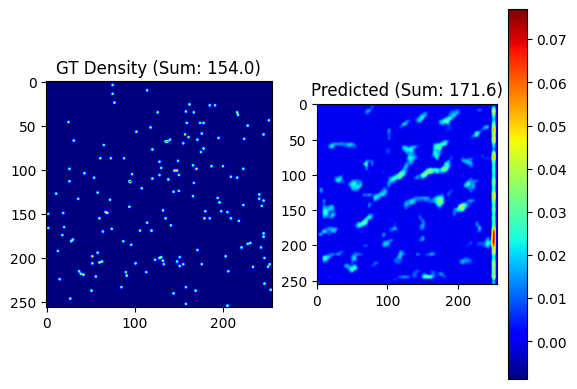

Epoch 27/30:
Train Loss: 0.376081, Val Loss: 0.216912, MAE: 11.31
61.93193054199219

 True count: 128.0, Predicted count: 136.9


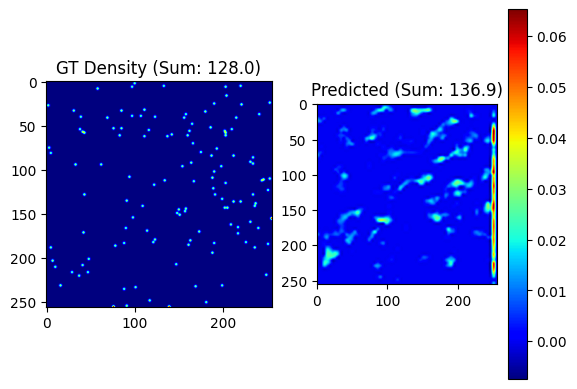

Epoch 28/30:
Train Loss: 0.336403, Val Loss: 0.246101, MAE: 12.50
94.50782012939453

 True count: 244.0, Predicted count: 235.4


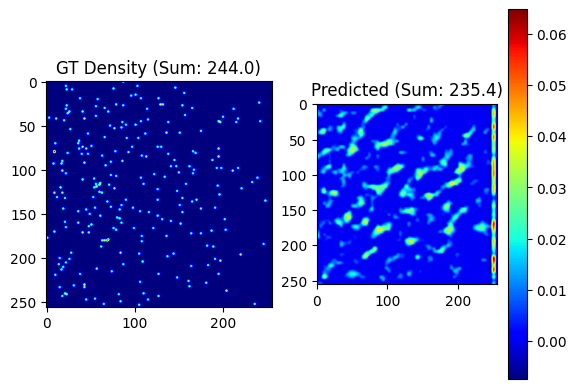

Epoch 29/30:
Train Loss: 0.304263, Val Loss: 0.176963, MAE: 11.80
110.38160705566406

 True count: 218.0, Predicted count: 249.9


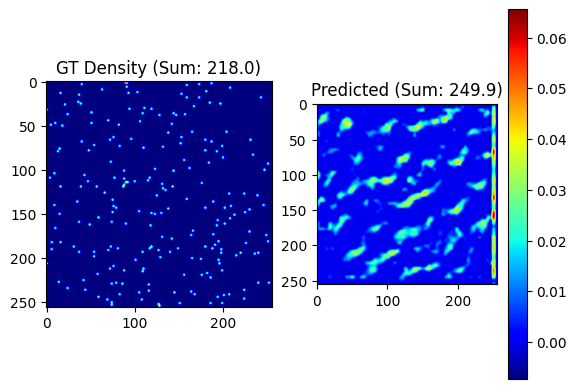

Epoch 30/30:
Train Loss: 0.441369, Val Loss: 0.287920, MAE: 14.27


In [60]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = UNetCellCounter().to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-4)
criterion = nn.MSELoss()  # L2 loss for density map regression
train_losses, val_losses = train_unet(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    optimizer=optimizer,
    criterion=mse_with_count_regularization,
    device=device,
    num_epochs=30
)

922.2034912109375

 True count: 153.0, Predicted count: 64.8


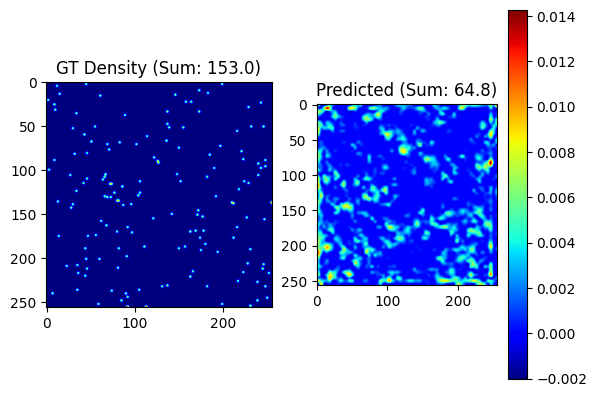

Epoch 1/30:
Train Loss: 29.744774, Val Loss: 13.139167, MAE: 97.80
Model saved with Val Loss: 13.1392
441.59619140625

 True count: 200.0, Predicted count: 160.0


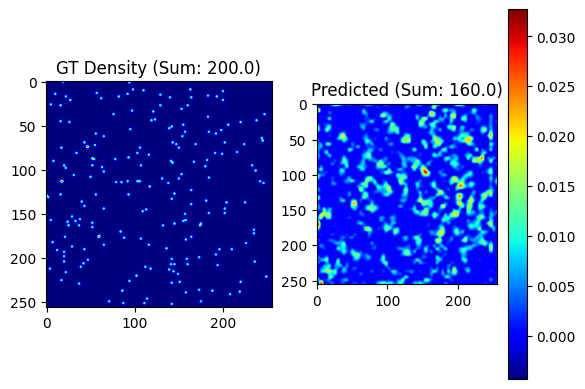

Epoch 2/30:
Train Loss: 3.648071, Val Loss: 2.823066, MAE: 48.89
Model saved with Val Loss: 2.8231
136.21466064453125

 True count: 218.0, Predicted count: 158.2


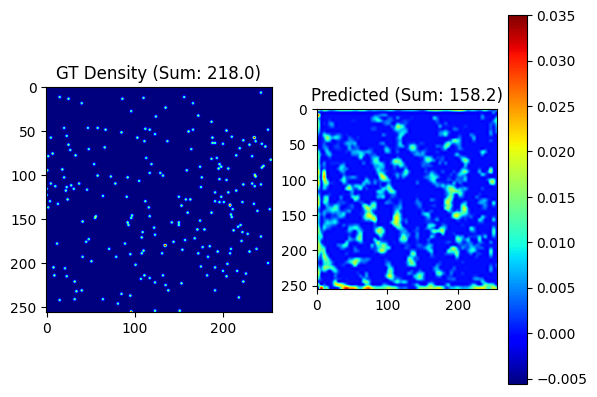

Epoch 3/30:
Train Loss: 2.226038, Val Loss: 0.968461, MAE: 22.90
Model saved with Val Loss: 0.9685
145.59686279296875

 True count: 84.0, Predicted count: 80.7


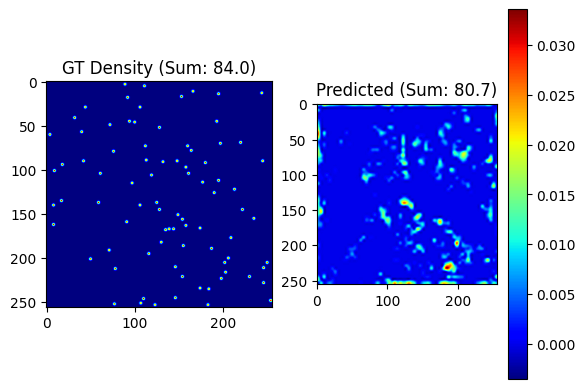

Epoch 4/30:
Train Loss: 1.422069, Val Loss: 0.511025, MAE: 18.78
Model saved with Val Loss: 0.5110
273.9736328125

 True count: 128.0, Predicted count: 79.9


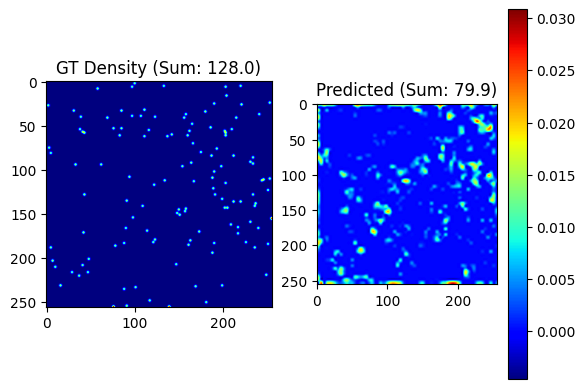

Epoch 5/30:
Train Loss: 1.501194, Val Loss: 1.125921, MAE: 26.52
151.07266235351562

 True count: 218.0, Predicted count: 221.8


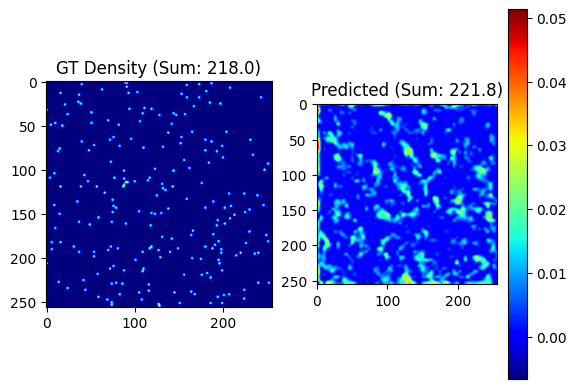

Epoch 6/30:
Train Loss: 1.416513, Val Loss: 0.531241, MAE: 18.17
146.09364318847656

 True count: 248.0, Predicted count: 223.5


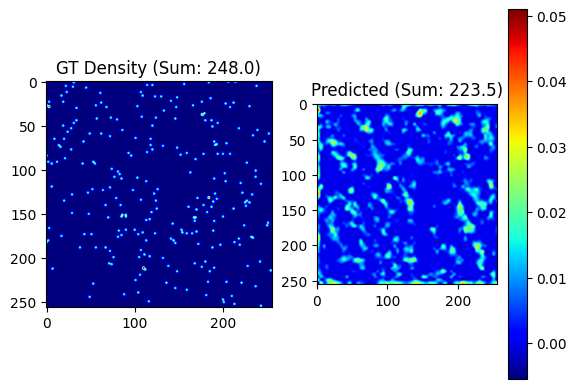

Epoch 7/30:
Train Loss: 1.313782, Val Loss: 1.033435, MAE: 22.51
184.57232666015625

 True count: 132.0, Predicted count: 162.4


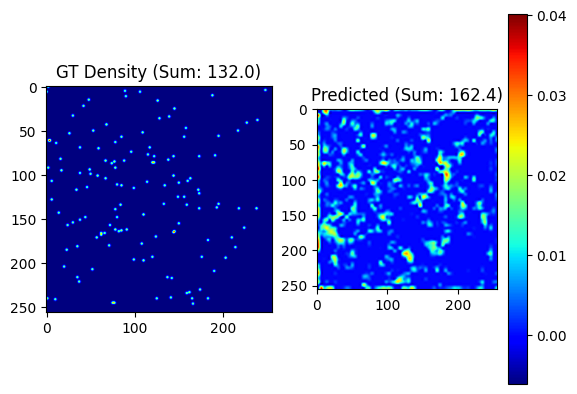

Epoch 8/30:
Train Loss: 1.989846, Val Loss: 0.510934, MAE: 21.31
Model saved with Val Loss: 0.5109
216.09768676757812

 True count: 153.0, Predicted count: 131.0


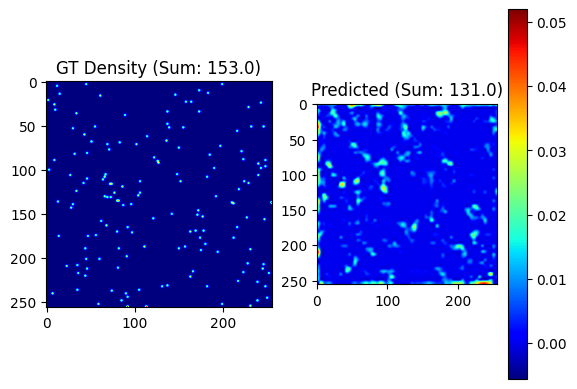

Epoch 9/30:
Train Loss: 1.158179, Val Loss: 0.651928, MAE: 21.13
134.663330078125

 True count: 98.0, Predicted count: 114.6


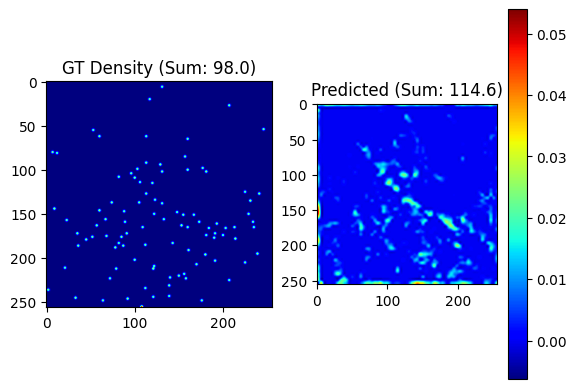

Epoch 10/30:
Train Loss: 1.091742, Val Loss: 0.536700, MAE: 17.67
305.0679931640625

 True count: 153.0, Predicted count: 161.8


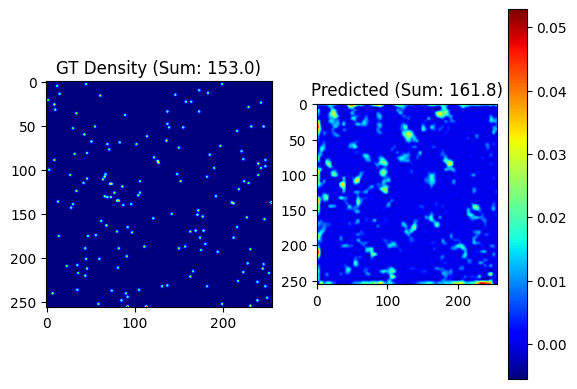

Epoch 11/30:
Train Loss: 0.971845, Val Loss: 0.893499, MAE: 25.13
158.30868530273438

 True count: 248.0, Predicted count: 223.5


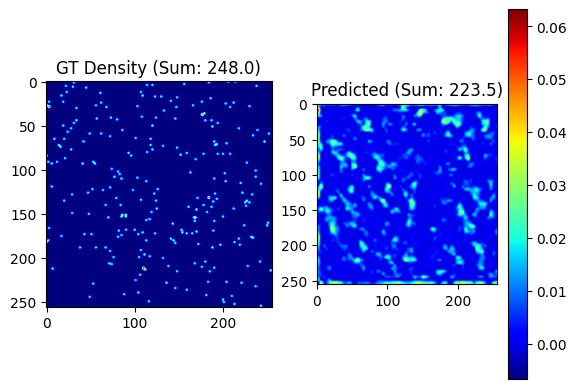

Epoch 12/30:
Train Loss: 0.946082, Val Loss: 0.430546, MAE: 17.94
Model saved with Val Loss: 0.4305
191.49380493164062

 True count: 200.0, Predicted count: 244.6


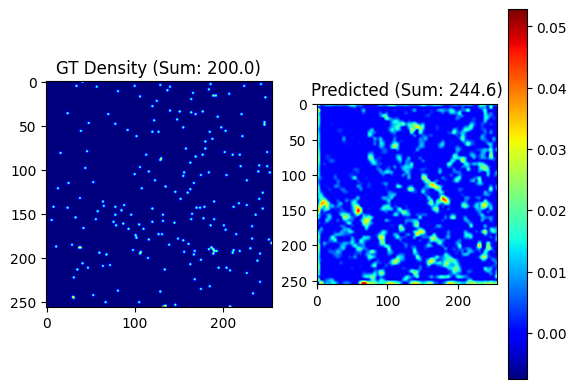

Epoch 13/30:
Train Loss: 0.913016, Val Loss: 0.581078, MAE: 19.82
126.43020629882812

 True count: 218.0, Predicted count: 215.9


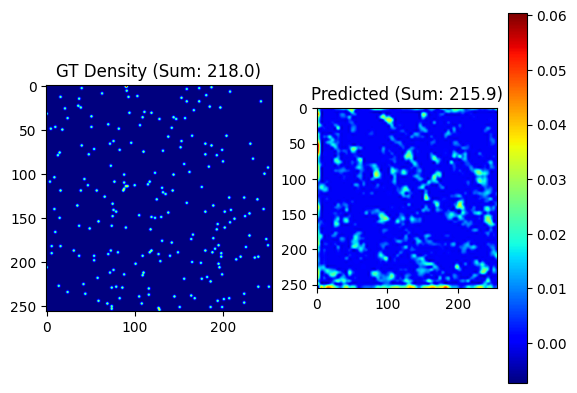

Epoch 14/30:
Train Loss: 0.925437, Val Loss: 0.247810, MAE: 14.53
Model saved with Val Loss: 0.2478
130.94906616210938

 True count: 273.0, Predicted count: 274.2


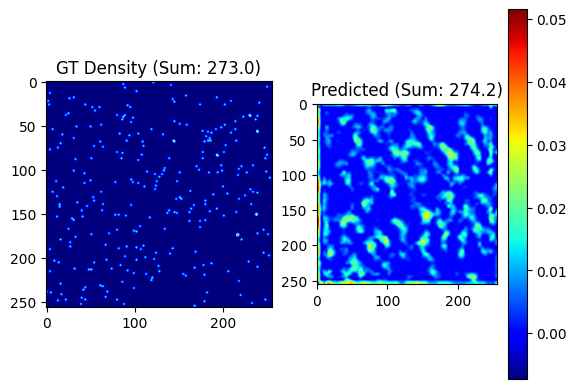

Epoch 15/30:
Train Loss: 0.626262, Val Loss: 1.184062, MAE: 25.00
181.03347778320312

 True count: 153.0, Predicted count: 160.0


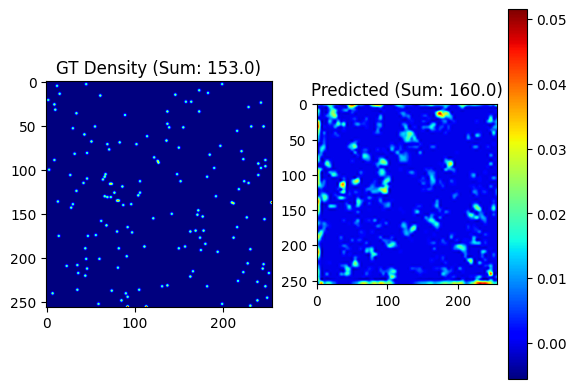

Epoch 16/30:
Train Loss: 0.621005, Val Loss: 0.648903, MAE: 21.53
103.45865631103516

 True count: 95.0, Predicted count: 87.0


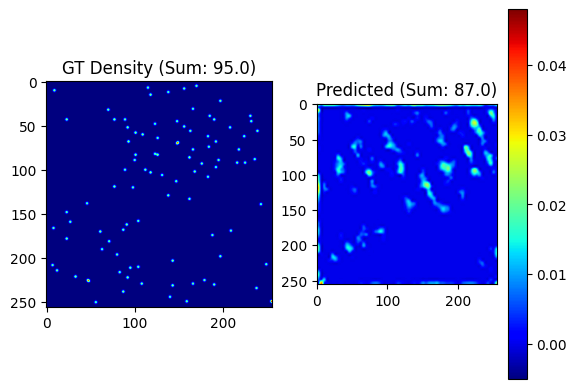

Epoch 17/30:
Train Loss: 0.494302, Val Loss: 0.195030, MAE: 10.73
Model saved with Val Loss: 0.1950
133.94940185546875

 True count: 244.0, Predicted count: 269.0


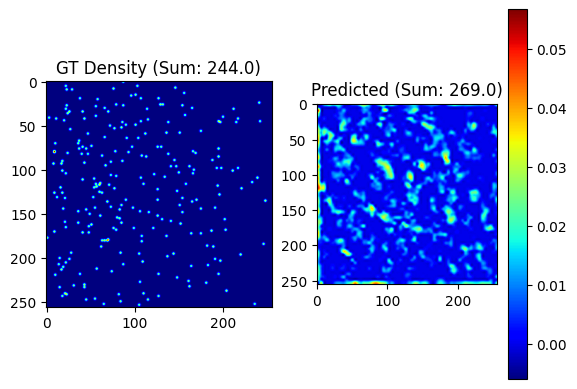

Epoch 18/30:
Train Loss: 0.762619, Val Loss: 0.439544, MAE: 16.25
185.08935546875

 True count: 156.0, Predicted count: 166.3


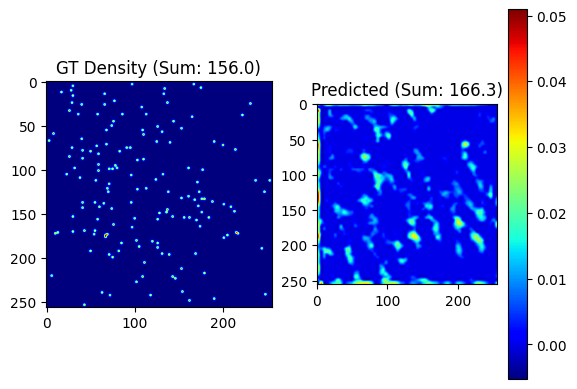

Epoch 19/30:
Train Loss: 0.626958, Val Loss: 0.766709, MAE: 21.83
122.4650650024414

 True count: 154.0, Predicted count: 164.8


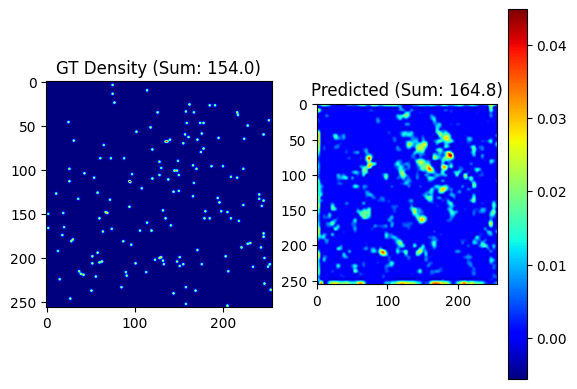

Epoch 20/30:
Train Loss: 0.556803, Val Loss: 0.550044, MAE: 17.50
136.56298828125

 True count: 200.0, Predicted count: 235.7


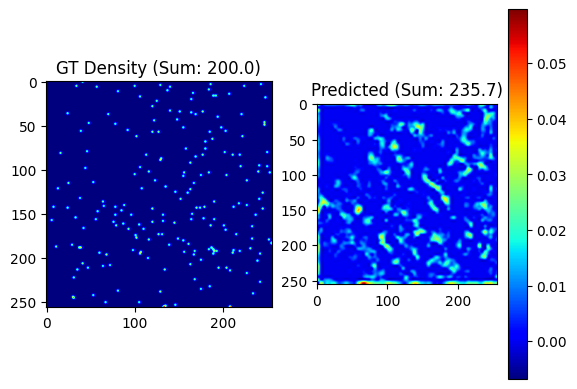

Epoch 21/30:
Train Loss: 0.670712, Val Loss: 0.302595, MAE: 15.27
130.87930297851562

 True count: 224.0, Predicted count: 209.3


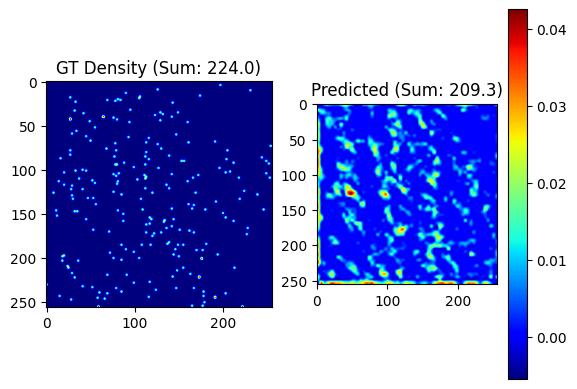

Epoch 22/30:
Train Loss: 0.805872, Val Loss: 0.728130, MAE: 19.17
102.36634063720703

 True count: 200.0, Predicted count: 242.4


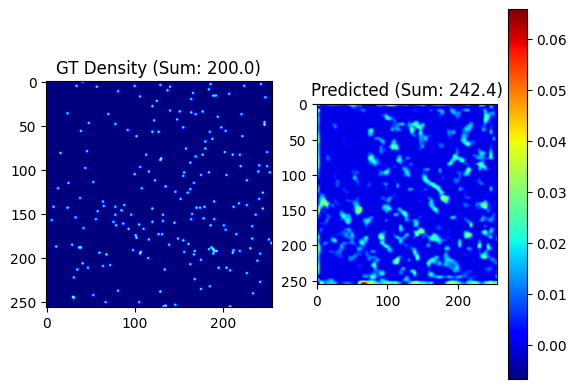

Epoch 23/30:
Train Loss: 0.630663, Val Loss: 0.383678, MAE: 16.15
92.45286560058594

 True count: 224.0, Predicted count: 234.5


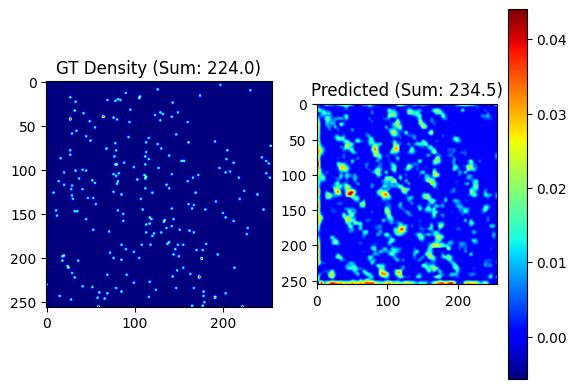

Epoch 24/30:
Train Loss: 0.564872, Val Loss: 0.184235, MAE: 12.34
Model saved with Val Loss: 0.1842
161.46200561523438

 True count: 218.0, Predicted count: 241.3


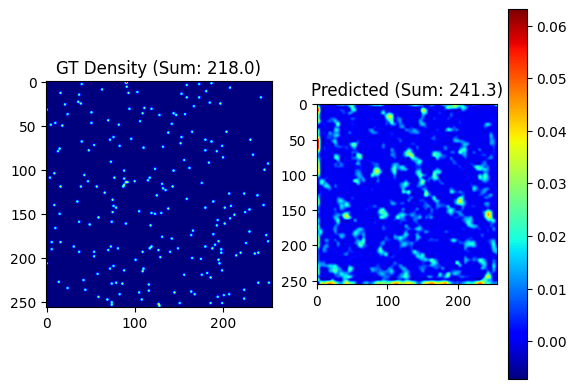

Epoch 25/30:
Train Loss: 0.458582, Val Loss: 0.399437, MAE: 16.13
96.17293548583984

 True count: 200.0, Predicted count: 226.0


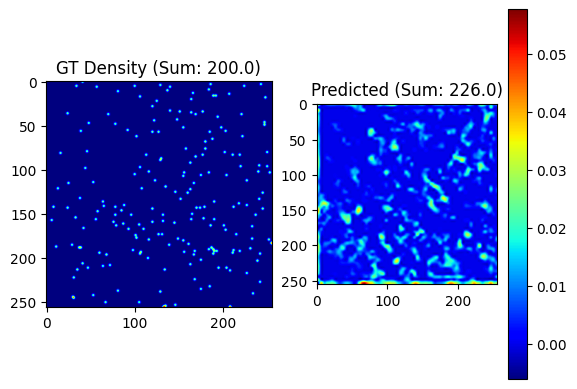

Epoch 26/30:
Train Loss: 0.638683, Val Loss: 0.123598, MAE: 9.31
Model saved with Val Loss: 0.1236
100.24474334716797

 True count: 200.0, Predicted count: 189.6


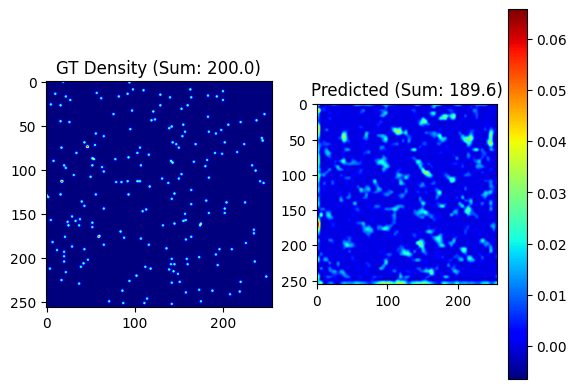

Epoch 27/30:
Train Loss: 0.434410, Val Loss: 0.262892, MAE: 12.96
123.72750091552734

 True count: 244.0, Predicted count: 261.9


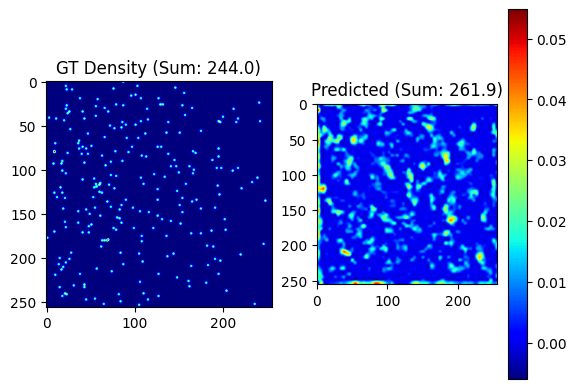

Epoch 28/30:
Train Loss: 0.567049, Val Loss: 0.569773, MAE: 18.75
224.0161895751953

 True count: 156.0, Predicted count: 197.3


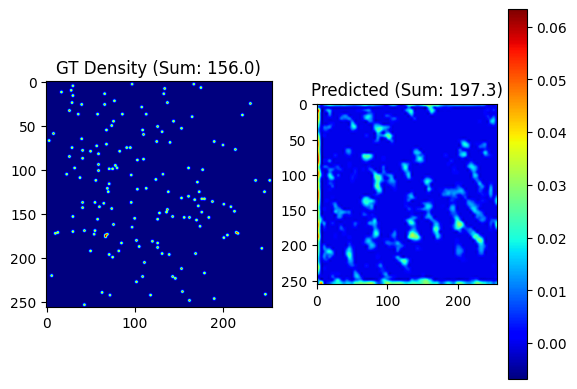

Epoch 29/30:
Train Loss: 0.911249, Val Loss: 0.905745, MAE: 27.33
148.8588409423828

 True count: 84.0, Predicted count: 98.6


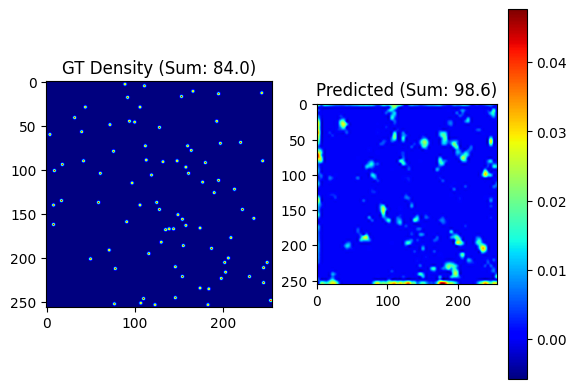

Epoch 30/30:
Train Loss: 0.702603, Val Loss: 0.448428, MAE: 16.52


In [61]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = UNetCellCounter().to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-4)
criterion = nn.MSELoss()  # L2 loss for density map regression
train_losses, val_losses = train_unet(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    optimizer=optimizer,
    criterion=mse_with_count_regularization,
    device=device,
    num_epochs=30
)

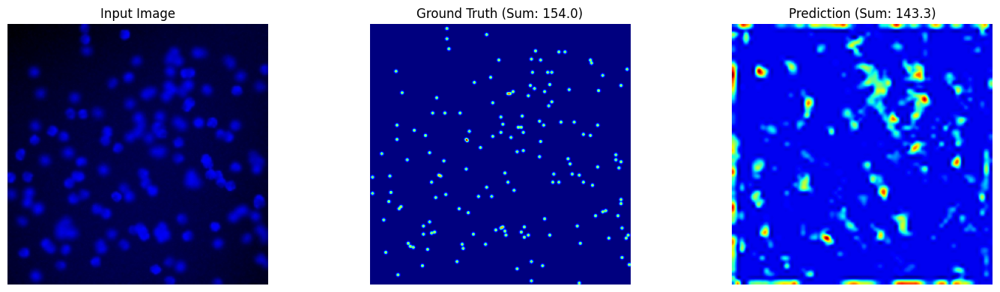

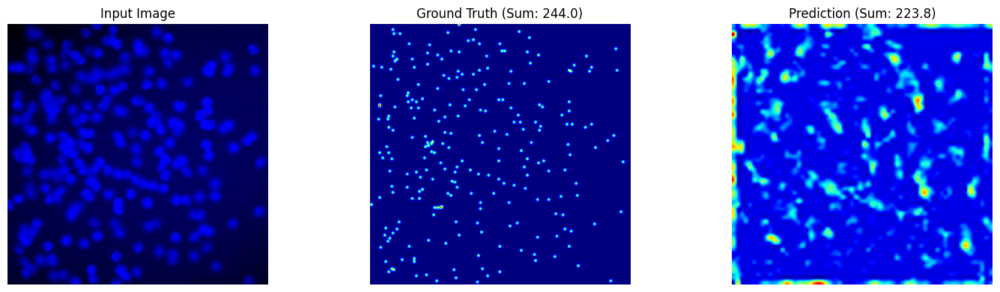

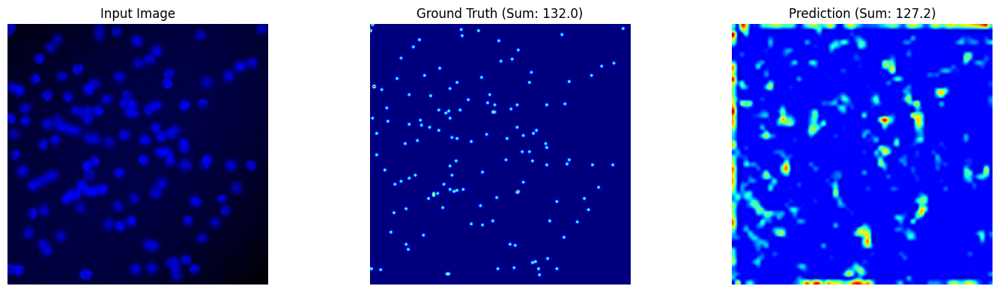

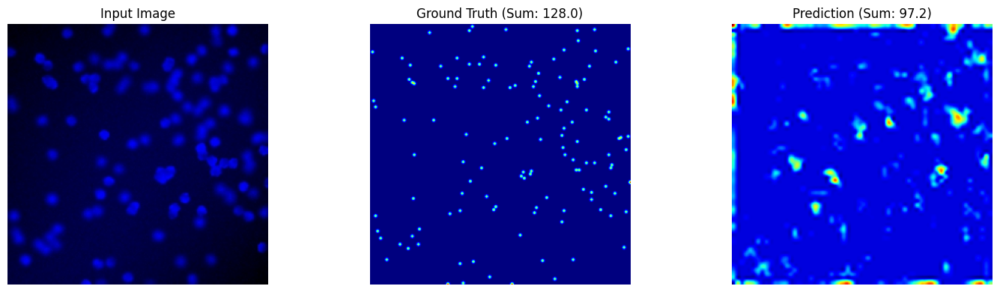

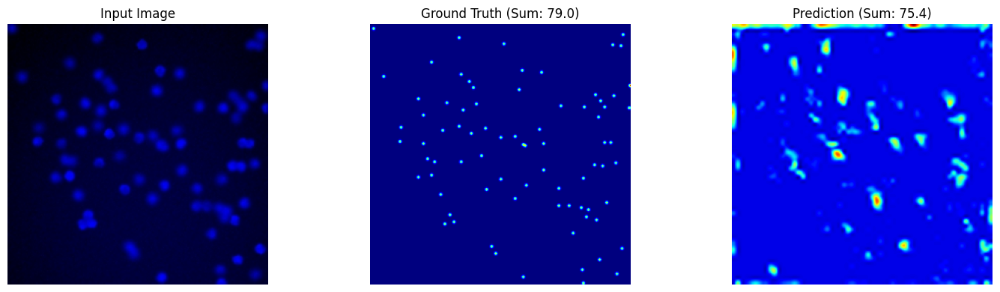

In [63]:
import random
import matplotlib.pyplot as plt

model.eval()

# Get 5 random indices from the val set
random_indices = random.sample(range(len(val_set)), 5)

with torch.no_grad():
    for idx in random_indices:
        image, _, gt_map = val_set[idx]

        # Move to device and batchify
        image_batch = image.unsqueeze(0).to(device)
        gt_map = gt_map.unsqueeze(0).to(device)

        # Forward pass
        pred_map, pred_count = model(image_batch)
        true_count = gt_map.sum().item()

        # Convert for plotting
        input_img = image.permute(1, 2, 0).numpy()
        input_img = np.clip(input_img * [0.229, 0.224, 0.225] + [0.485, 0.456, 0.406], 0, 1)
        gt_map_np = gt_map.squeeze().cpu().numpy()
        pred_map_np = pred_map.squeeze().cpu().numpy()

        # Plotting
        plt.figure(figsize=(15, 4))
        plt.subplot(1, 3, 1)
        plt.imshow(input_img)
        plt.title("Input Image")
        plt.axis("off")

        plt.subplot(1, 3, 2)
        plt.imshow(gt_map_np, cmap='jet')
        plt.title(f"Ground Truth (Sum: {true_count:.1f})")
        plt.axis("off")

        plt.subplot(1, 3, 3)
        plt.imshow(pred_map_np, cmap='jet')
        plt.title(f"Prediction (Sum: {pred_count.item():.1f})")
        plt.axis("off")

        plt.tight_layout()
        plt.show()


# `batch size = 8`

Expeiment 6: Adam, lr 1e-4, weight_decay 1e-4, sigma - 1.2, bicubic with pretrained weights resnet 34, rotation to image and desity maps (same angle)

1226.787841796875

 True count: 124.0, Predicted count: 11.0


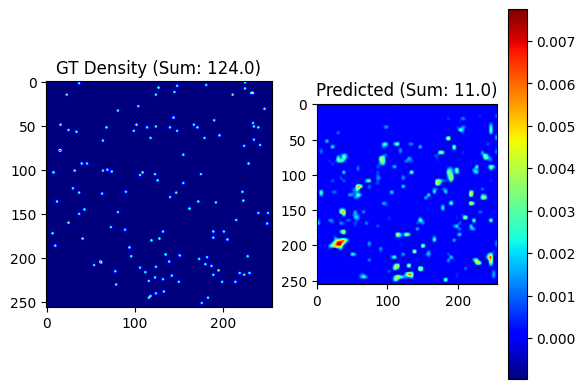

Epoch 1/30:
Train Loss: 44.485133, Val Loss: 25.494274, MAE: 151.63
Model saved with Val Loss: 25.4943
476.3353271484375

 True count: 95.0, Predicted count: 52.9


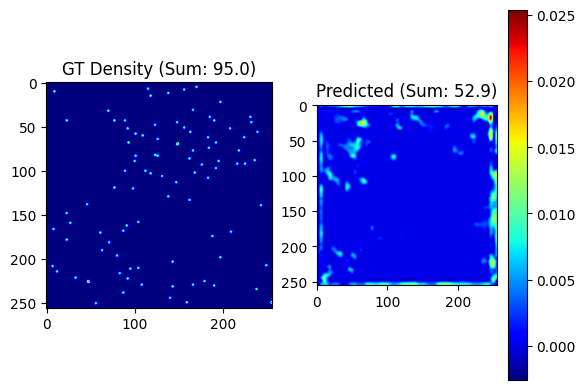

Epoch 2/30:
Train Loss: 3.924531, Val Loss: 5.077349, MAE: 65.20
Model saved with Val Loss: 5.0773
194.06044006347656

 True count: 124.0, Predicted count: 131.8


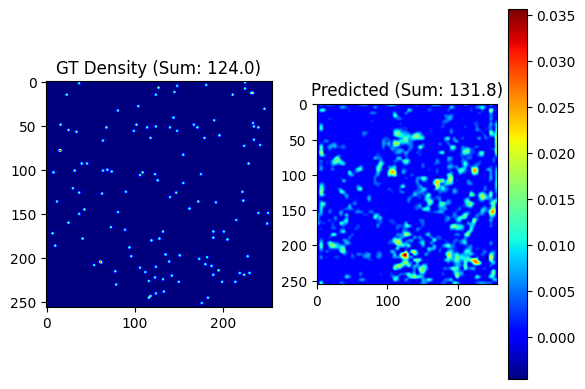

Epoch 3/30:
Train Loss: 2.398278, Val Loss: 3.028959, MAE: 35.95
Model saved with Val Loss: 3.0290
325.65478515625

 True count: 200.0, Predicted count: 167.9


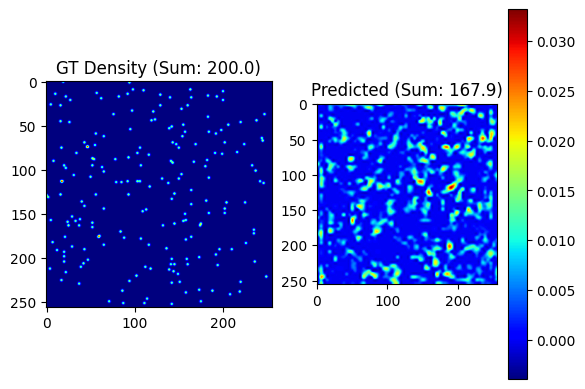

Epoch 4/30:
Train Loss: 1.581704, Val Loss: 2.180504, MAE: 34.04
Model saved with Val Loss: 2.1805
275.9556884765625

 True count: 224.0, Predicted count: 200.2


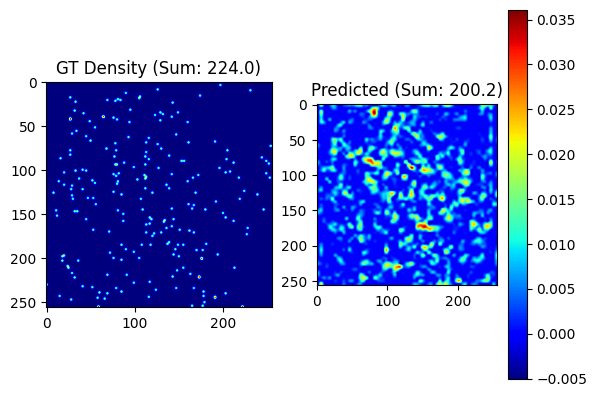

Epoch 5/30:
Train Loss: 2.169887, Val Loss: 2.006030, MAE: 31.28
Model saved with Val Loss: 2.0060
179.03292846679688

 True count: 218.0, Predicted count: 205.7


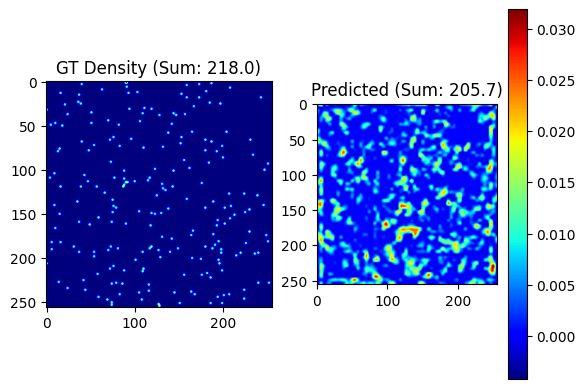

Epoch 6/30:
Train Loss: 1.898172, Val Loss: 1.009328, MAE: 26.17
Model saved with Val Loss: 1.0093
208.21897888183594

 True count: 273.0, Predicted count: 323.9


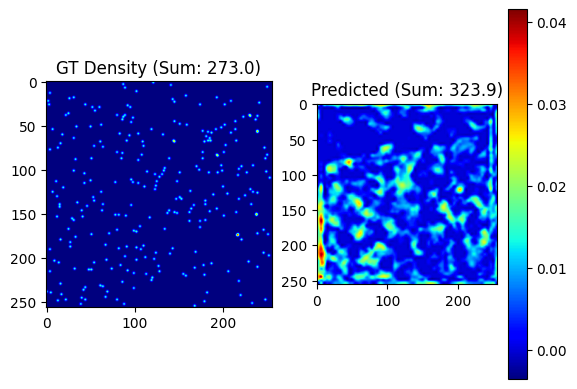

Epoch 7/30:
Train Loss: 1.137783, Val Loss: 1.367616, MAE: 26.05
543.40185546875

 True count: 248.0, Predicted count: 273.4


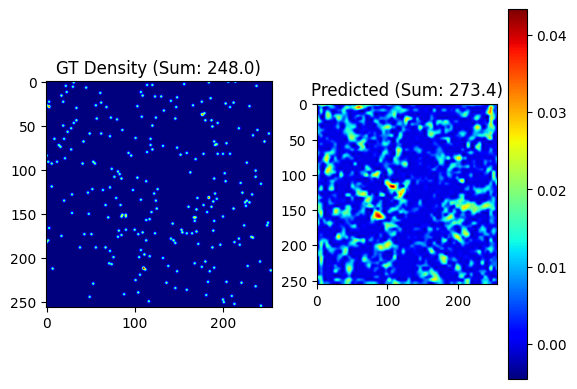

Epoch 8/30:
Train Loss: 1.116587, Val Loss: 13.932414, MAE: 69.80
141.851318359375

 True count: 84.0, Predicted count: 108.7


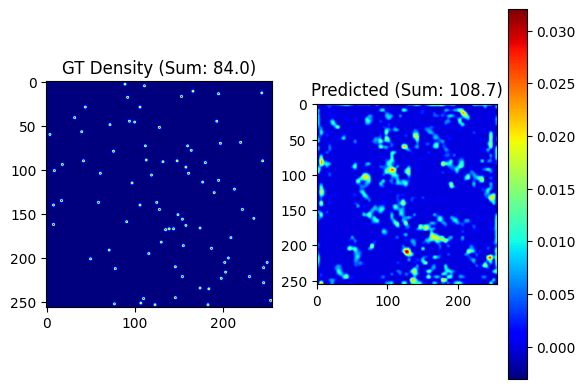

Epoch 9/30:
Train Loss: 1.364471, Val Loss: 0.503987, MAE: 18.94
Model saved with Val Loss: 0.5040
197.68255615234375

 True count: 273.0, Predicted count: 226.8


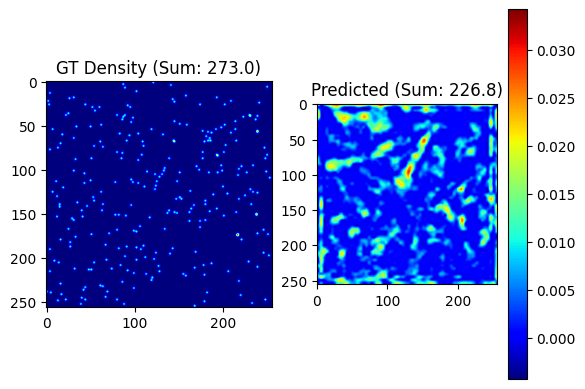

Epoch 10/30:
Train Loss: 0.828755, Val Loss: 0.859894, MAE: 25.23
271.22369384765625

 True count: 124.0, Predicted count: 97.3


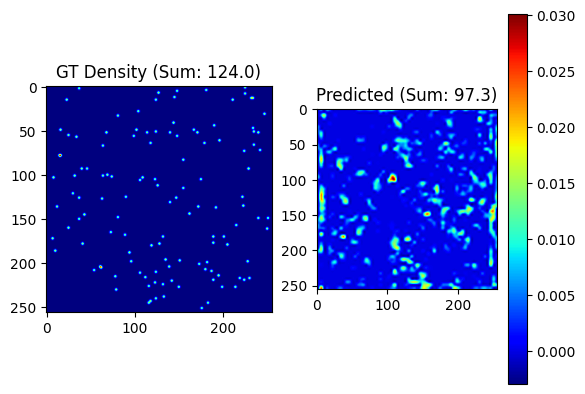

Epoch 11/30:
Train Loss: 1.500132, Val Loss: 0.883198, MAE: 24.52
146.64129638671875

 True count: 95.0, Predicted count: 118.5


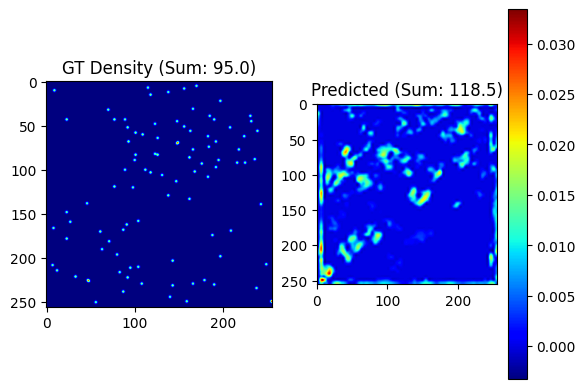

Epoch 12/30:
Train Loss: 1.304303, Val Loss: 0.274359, MAE: 13.98
Model saved with Val Loss: 0.2744
106.5042724609375

 True count: 84.0, Predicted count: 101.1


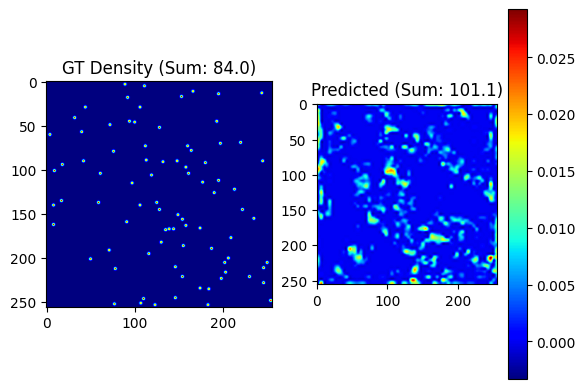

Epoch 13/30:
Train Loss: 1.163270, Val Loss: 0.167009, MAE: 10.90
Model saved with Val Loss: 0.1670
149.7509765625

 True count: 86.0, Predicted count: 81.9


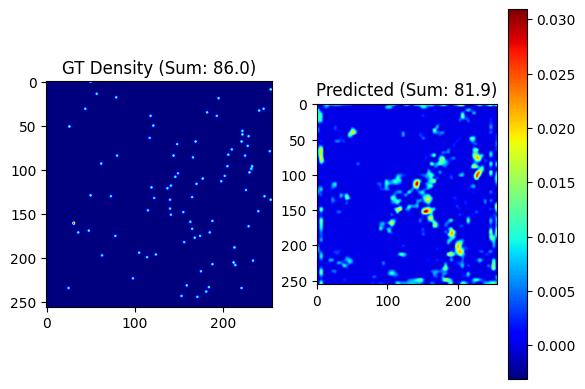

Epoch 14/30:
Train Loss: 1.050977, Val Loss: 0.589635, MAE: 20.18
270.27764892578125

 True count: 200.0, Predicted count: 185.2


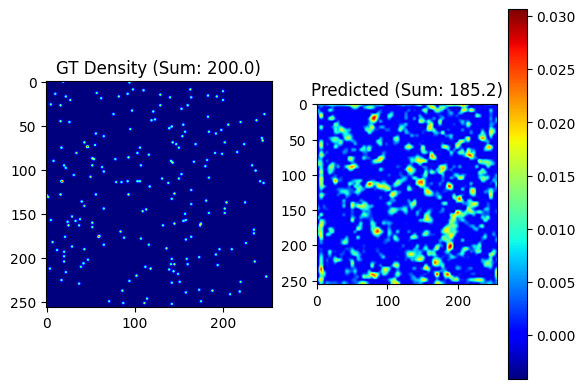

Epoch 15/30:
Train Loss: 1.219942, Val Loss: 0.903914, MAE: 26.64
225.2519989013672

 True count: 248.0, Predicted count: 192.2


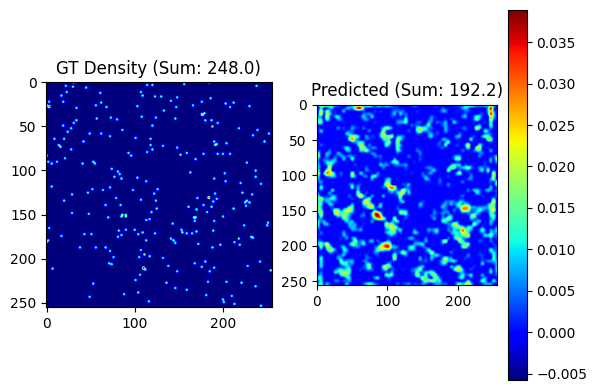

Epoch 16/30:
Train Loss: 1.584286, Val Loss: 1.243795, MAE: 30.03
120.62716674804688

 True count: 153.0, Predicted count: 133.6


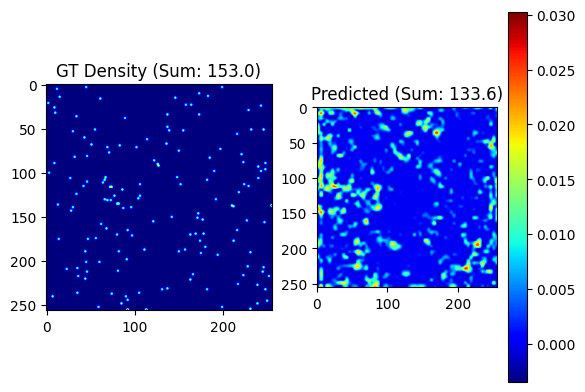

Epoch 17/30:
Train Loss: 1.075547, Val Loss: 0.292180, MAE: 14.72
142.92210388183594

 True count: 273.0, Predicted count: 285.7


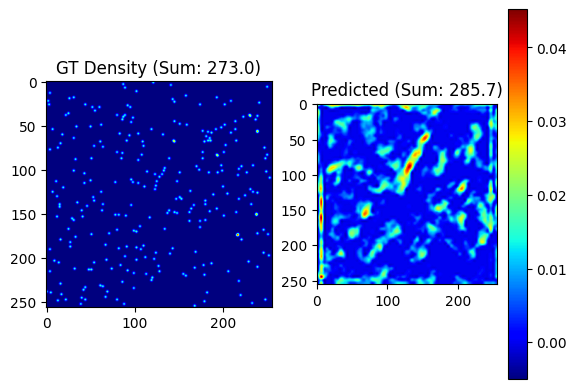

Epoch 18/30:
Train Loss: 1.071833, Val Loss: 0.364424, MAE: 16.34
61.26251220703125

 True count: 156.0, Predicted count: 160.7


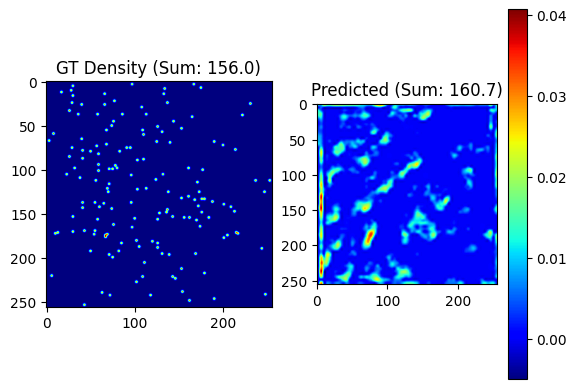

Epoch 19/30:
Train Loss: 0.871775, Val Loss: 0.204269, MAE: 11.96
106.50142669677734

 True count: 244.0, Predicted count: 234.2


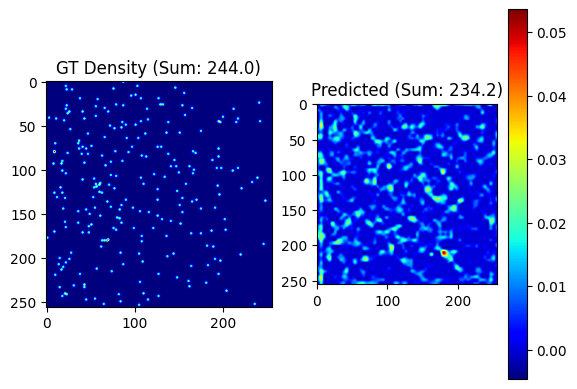

Epoch 20/30:
Train Loss: 1.014074, Val Loss: 0.247425, MAE: 12.76
138.65957641601562

 True count: 156.0, Predicted count: 184.3


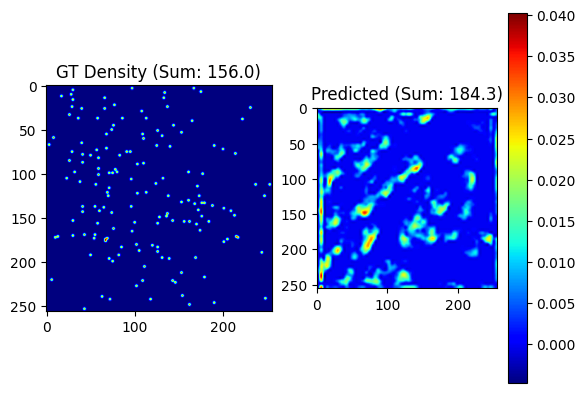

Epoch 21/30:
Train Loss: 0.686137, Val Loss: 0.476131, MAE: 19.82
64.90662384033203

 True count: 84.0, Predicted count: 81.7


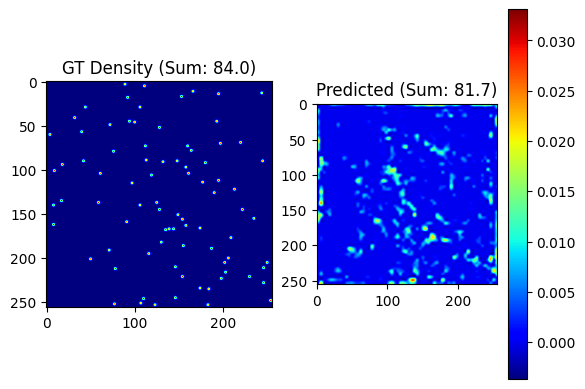

Epoch 22/30:
Train Loss: 0.815536, Val Loss: 0.198883, MAE: 11.43
137.91775512695312

 True count: 224.0, Predicted count: 248.8


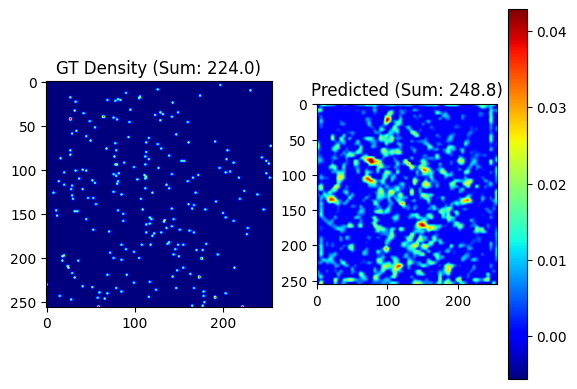

Epoch 23/30:
Train Loss: 0.792515, Val Loss: 0.803871, MAE: 19.20
200.80682373046875

 True count: 124.0, Predicted count: 136.2


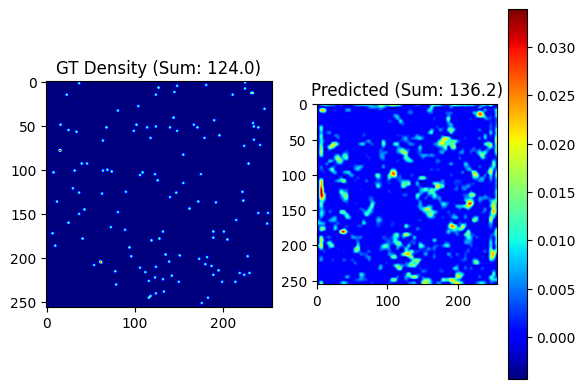

Epoch 24/30:
Train Loss: 0.858141, Val Loss: 0.898183, MAE: 28.08
106.97494506835938

 True count: 292.0, Predicted count: 265.5


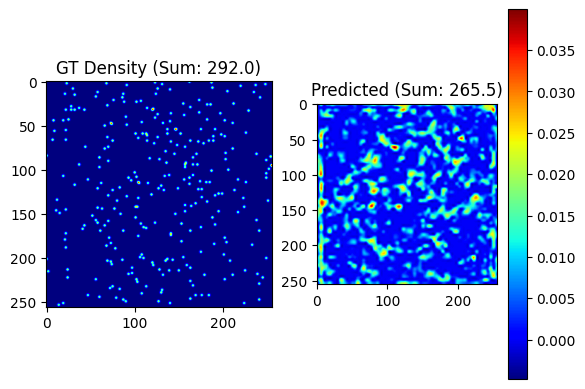

Epoch 25/30:
Train Loss: 0.699665, Val Loss: 0.446000, MAE: 17.09
39.59185791015625

 True count: 156.0, Predicted count: 152.2


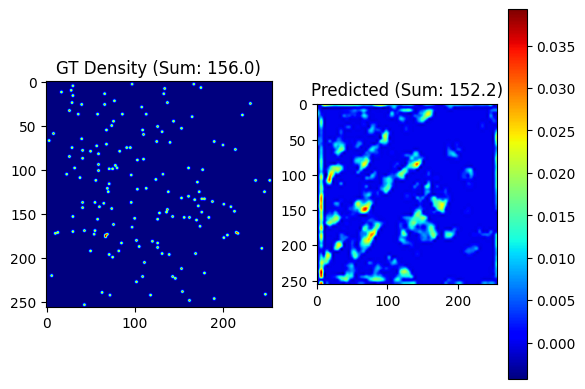

Epoch 26/30:
Train Loss: 0.653668, Val Loss: 0.252504, MAE: 10.50
118.62186431884766

 True count: 98.0, Predicted count: 108.7


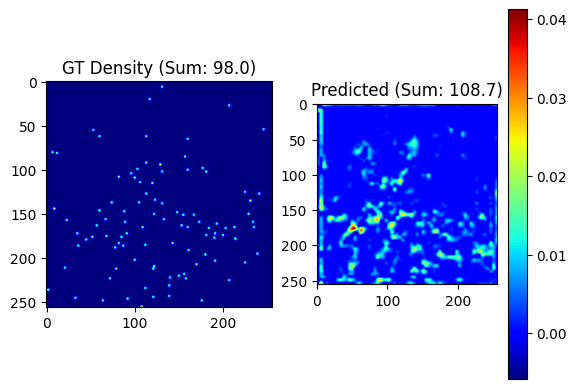

Epoch 27/30:
Train Loss: 0.698793, Val Loss: 0.617062, MAE: 16.88
155.86029052734375

 True count: 154.0, Predicted count: 168.4


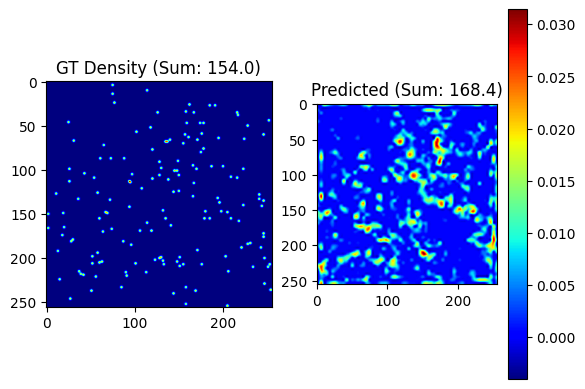

Epoch 28/30:
Train Loss: 0.471121, Val Loss: 0.367972, MAE: 16.35
194.51162719726562

 True count: 132.0, Predicted count: 148.8


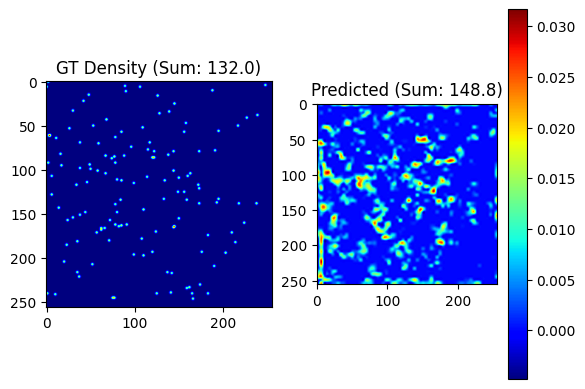

Epoch 29/30:
Train Loss: 0.609771, Val Loss: 0.518783, MAE: 19.37
79.61246490478516

 True count: 218.0, Predicted count: 215.8


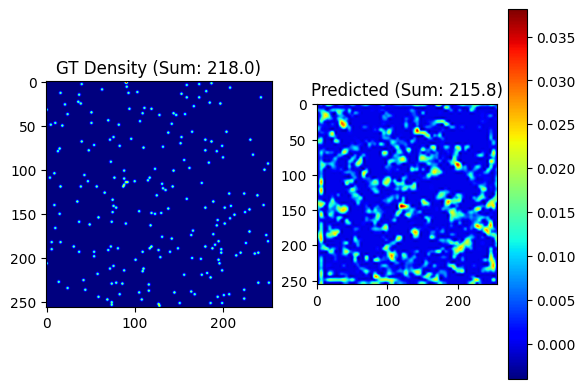

Epoch 30/30:
Train Loss: 0.917728, Val Loss: 0.328984, MAE: 13.59


In [64]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = UNetCellCounter().to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-4)
criterion = nn.MSELoss()  # L2 loss for density map regression
train_losses, val_losses = train_unet(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    optimizer=optimizer,
    criterion=mse_with_count_regularization,
    device=device,
    num_epochs=30
)

Expeiment 4: Adam, lr 1e-4, weight_decay 1e-4, sigma - 0.9, bicubic with pretrained weights resnet 34, rotation to image and desity maps (same angle) with 1/4 transformation

5927.04833984375

 True count: 154.0, Predicted count: 892.2


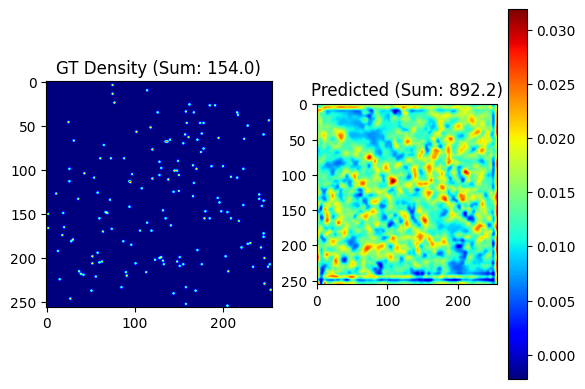

Epoch 1/35:
Train Loss: 795.591303, Val Loss: 505.063049, MAE: 715.19
Model saved with Val Loss: 505.0630
1048.1622314453125

 True count: 273.0, Predicted count: 183.6


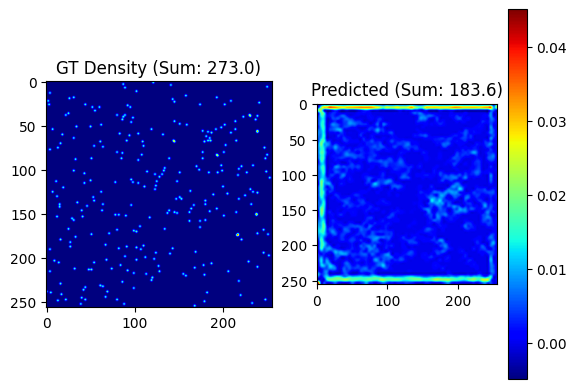

Epoch 2/35:
Train Loss: 16.188861, Val Loss: 24.443460, MAE: 141.05
Model saved with Val Loss: 24.4435
181.2527313232422

 True count: 218.0, Predicted count: 184.1


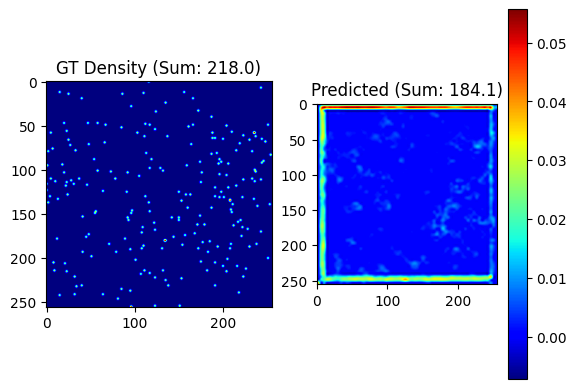

Epoch 3/35:
Train Loss: 2.664280, Val Loss: 1.137100, MAE: 26.03
Model saved with Val Loss: 1.1371
193.79795837402344

 True count: 273.0, Predicted count: 186.1


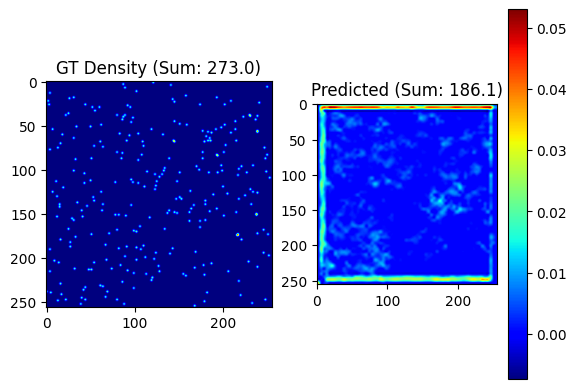

Epoch 4/35:
Train Loss: 1.962675, Val Loss: 0.861197, MAE: 23.79
Model saved with Val Loss: 0.8612
214.400390625

 True count: 292.0, Predicted count: 318.9


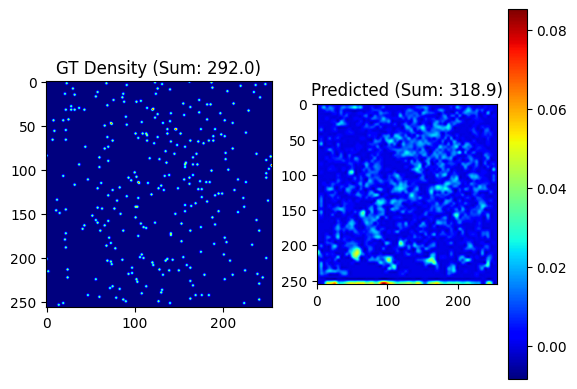

Epoch 5/35:
Train Loss: 1.221535, Val Loss: 0.680042, MAE: 22.69
Model saved with Val Loss: 0.6800
83.5704116821289

 True count: 218.0, Predicted count: 216.4


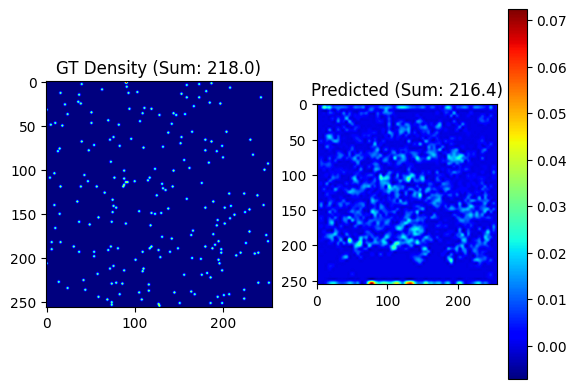

Epoch 6/35:
Train Loss: 0.992080, Val Loss: 0.462990, MAE: 17.52
Model saved with Val Loss: 0.4630
111.01217651367188

 True count: 153.0, Predicted count: 134.9


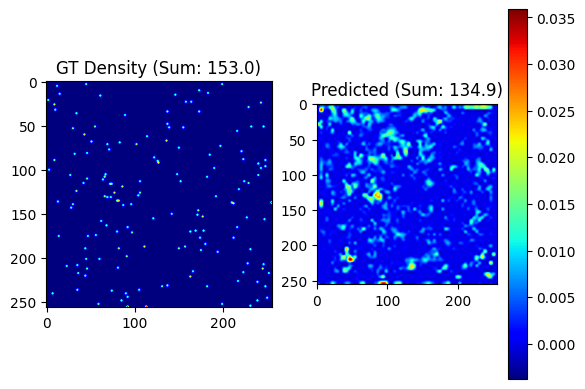

Epoch 7/35:
Train Loss: 0.952347, Val Loss: 0.262586, MAE: 13.06
Model saved with Val Loss: 0.2626
197.32701110839844

 True count: 200.0, Predicted count: 219.4


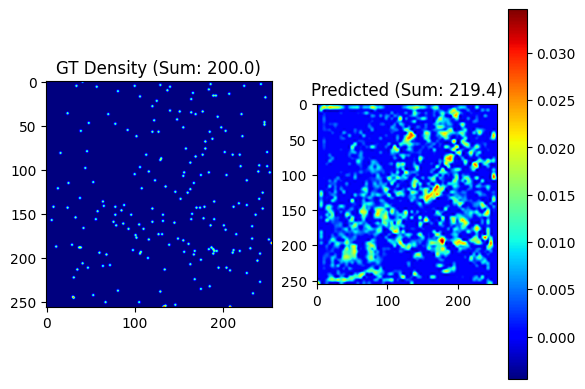

Epoch 8/35:
Train Loss: 0.702478, Val Loss: 0.730502, MAE: 19.76
77.15151977539062

 True count: 200.0, Predicted count: 208.5


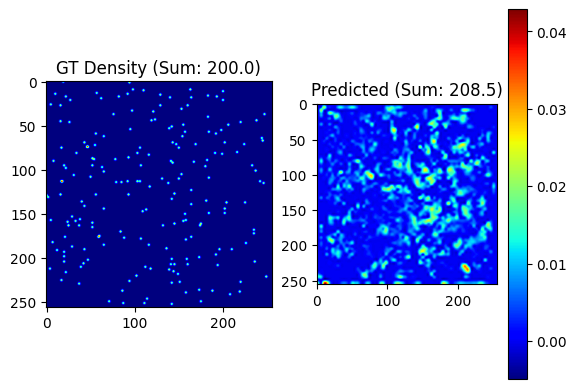

Epoch 9/35:
Train Loss: 0.651197, Val Loss: 0.333781, MAE: 13.26
156.103515625

 True count: 218.0, Predicted count: 232.2


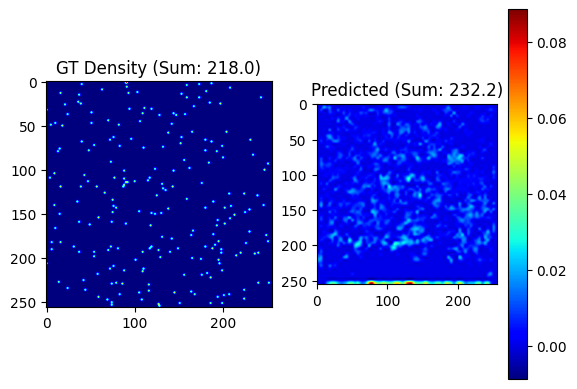

Epoch 10/35:
Train Loss: 0.777754, Val Loss: 0.338929, MAE: 14.27
70.00407409667969

 True count: 218.0, Predicted count: 227.6


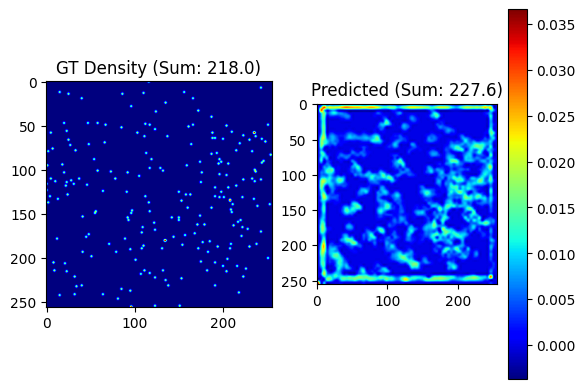

Epoch 11/35:
Train Loss: 0.490924, Val Loss: 0.292664, MAE: 13.82
79.65010833740234

 True count: 86.0, Predicted count: 79.7


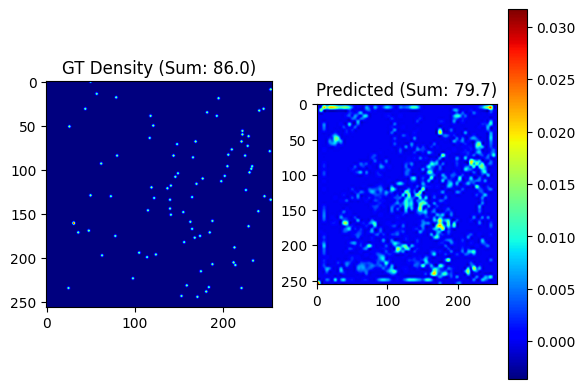

Epoch 12/35:
Train Loss: 0.479400, Val Loss: 0.200751, MAE: 12.06
Model saved with Val Loss: 0.2008
171.08505249023438

 True count: 244.0, Predicted count: 305.4


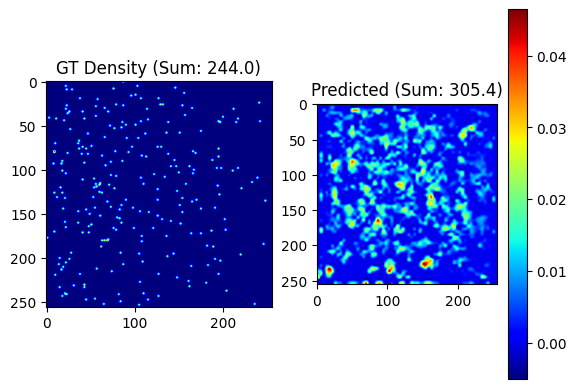

Epoch 13/35:
Train Loss: 0.518855, Val Loss: 0.565953, MAE: 15.99
144.23329162597656

 True count: 292.0, Predicted count: 324.8


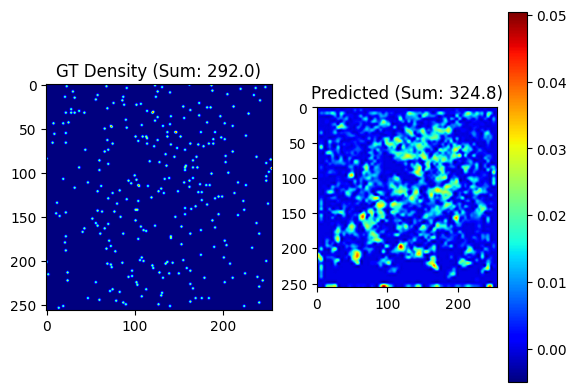

Epoch 14/35:
Train Loss: 0.562086, Val Loss: 0.388079, MAE: 14.31
116.08783721923828

 True count: 79.0, Predicted count: 115.6


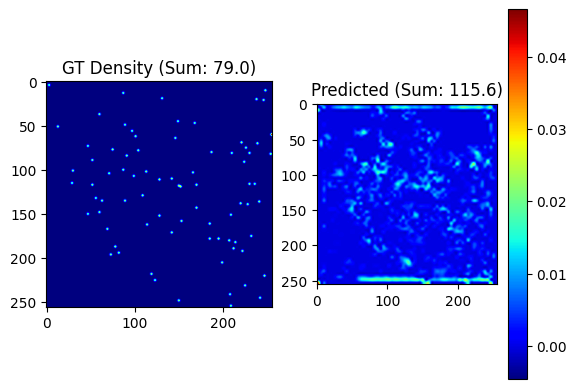

Epoch 15/35:
Train Loss: 0.515964, Val Loss: 0.252612, MAE: 12.91
108.09646606445312

 True count: 218.0, Predicted count: 210.8


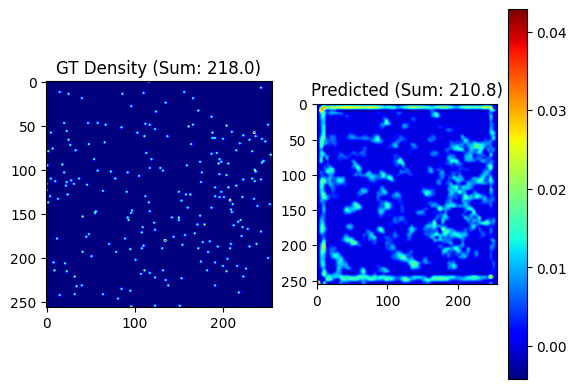

Epoch 16/35:
Train Loss: 0.541364, Val Loss: 0.202884, MAE: 10.89
67.49861145019531

 True count: 292.0, Predicted count: 289.9


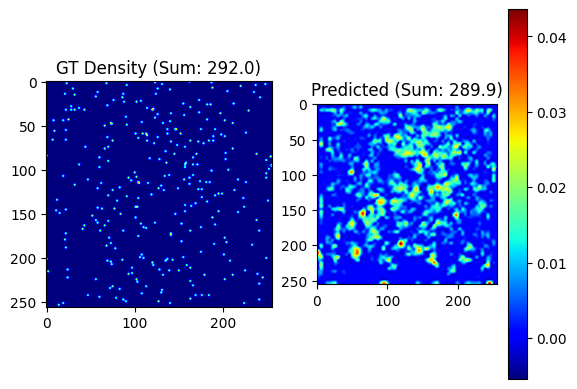

Epoch 17/35:
Train Loss: 0.429871, Val Loss: 0.132151, MAE: 9.21
Model saved with Val Loss: 0.1322
94.79849243164062

 True count: 128.0, Predicted count: 111.2


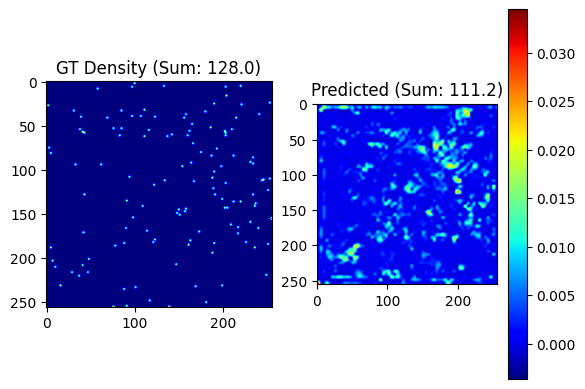

Epoch 18/35:
Train Loss: 0.430786, Val Loss: 0.160177, MAE: 10.39
83.10868072509766

 True count: 84.0, Predicted count: 81.5


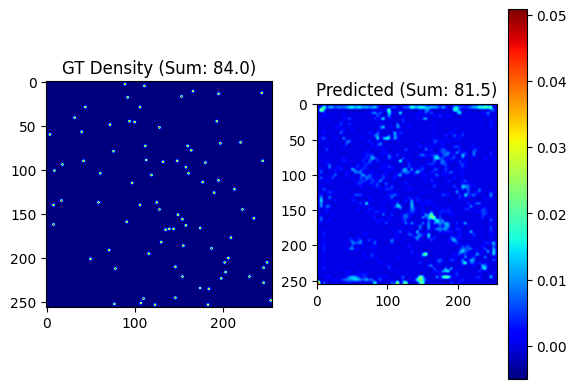

Epoch 19/35:
Train Loss: 0.340375, Val Loss: 0.202823, MAE: 11.28
146.90174865722656

 True count: 292.0, Predicted count: 329.1


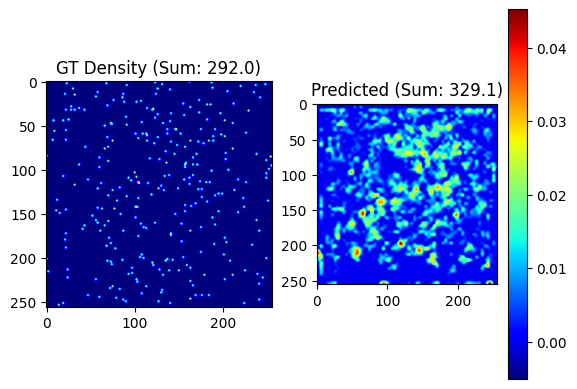

Epoch 20/35:
Train Loss: 0.477553, Val Loss: 0.653917, MAE: 19.56
134.96282958984375

 True count: 200.0, Predicted count: 185.5


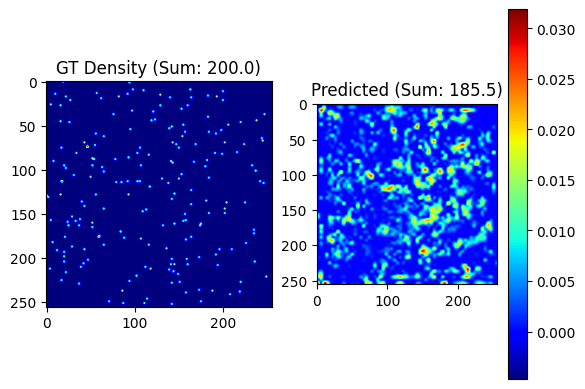

Epoch 21/35:
Train Loss: 0.368604, Val Loss: 0.310004, MAE: 15.51
71.56763458251953

 True count: 224.0, Predicted count: 224.1


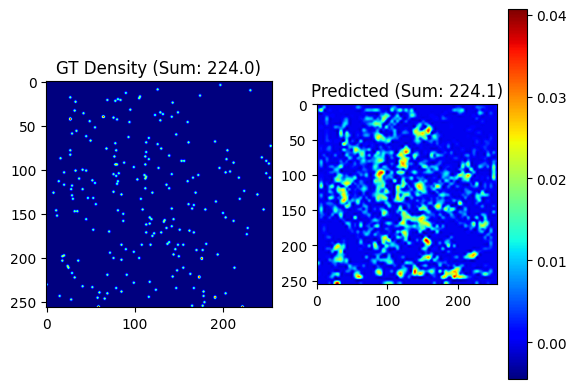

Epoch 22/35:
Train Loss: 0.273664, Val Loss: 0.235423, MAE: 10.32
89.38893127441406

 True count: 79.0, Predicted count: 98.6


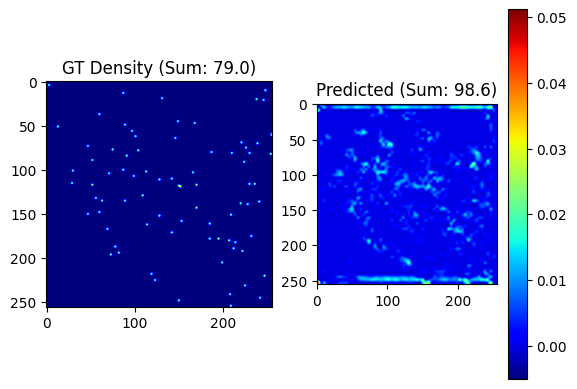

Epoch 23/35:
Train Loss: 0.430612, Val Loss: 0.220159, MAE: 12.08
30.922988891601562

 True count: 218.0, Predicted count: 221.5


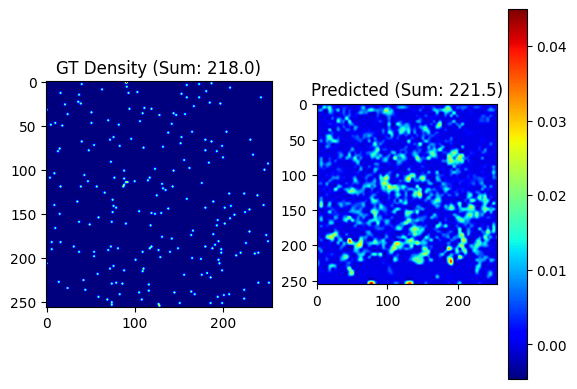

Epoch 24/35:
Train Loss: 0.313742, Val Loss: 0.131302, MAE: 8.12
Model saved with Val Loss: 0.1313
81.11813354492188

 True count: 156.0, Predicted count: 164.0


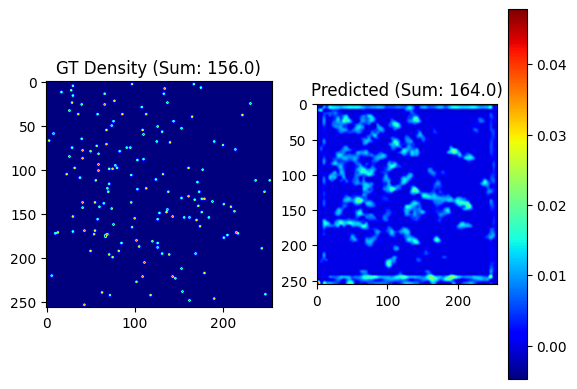

Epoch 25/35:
Train Loss: 0.234446, Val Loss: 0.093926, MAE: 8.32
Model saved with Val Loss: 0.0939
72.25193786621094

 True count: 132.0, Predicted count: 121.1


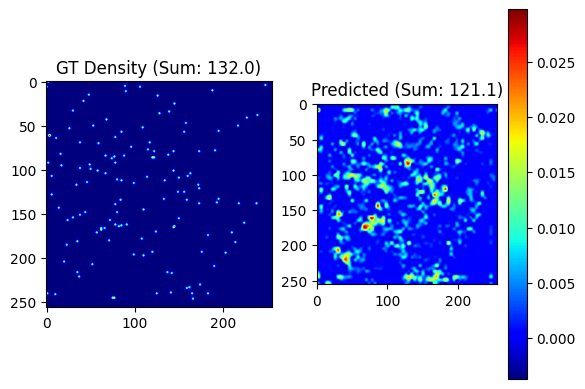

Epoch 26/35:
Train Loss: 0.306549, Val Loss: 0.141339, MAE: 10.19
88.15992736816406

 True count: 79.0, Predicted count: 105.0


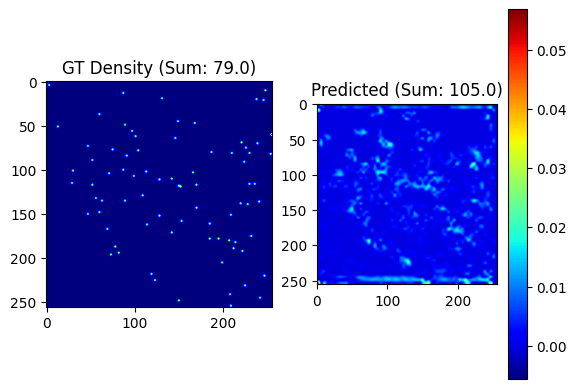

Epoch 27/35:
Train Loss: 0.456837, Val Loss: 0.206651, MAE: 12.16
161.18682861328125

 True count: 200.0, Predicted count: 183.0


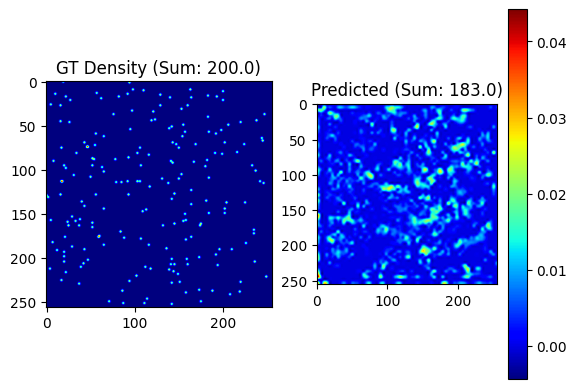

Epoch 28/35:
Train Loss: 0.458412, Val Loss: 0.295723, MAE: 14.82
62.723419189453125

 True count: 153.0, Predicted count: 148.6


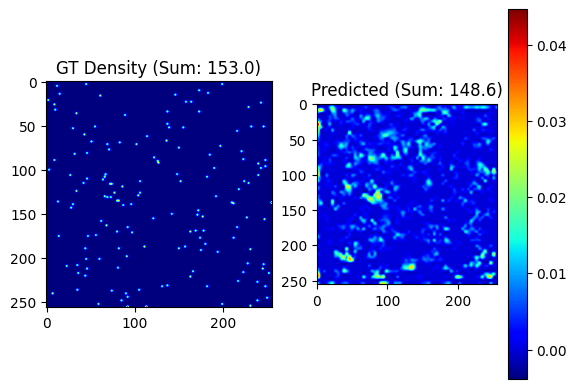

Epoch 29/35:
Train Loss: 0.233936, Val Loss: 0.126681, MAE: 7.67
75.85425567626953

 True count: 218.0, Predicted count: 210.7


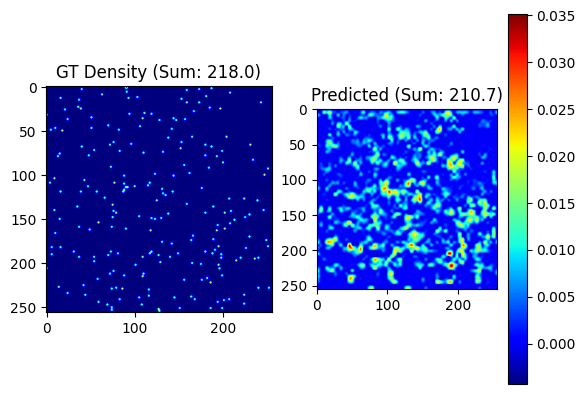

Epoch 30/35:
Train Loss: 0.377863, Val Loss: 0.148127, MAE: 10.64
91.90186309814453

 True count: 218.0, Predicted count: 219.4


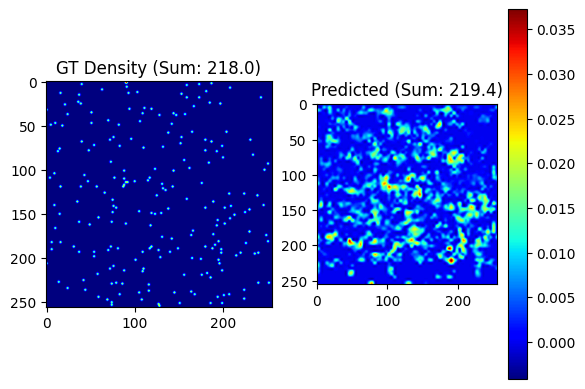

Epoch 31/35:
Train Loss: 0.271019, Val Loss: 0.144867, MAE: 9.79
70.3980941772461

 True count: 124.0, Predicted count: 129.6


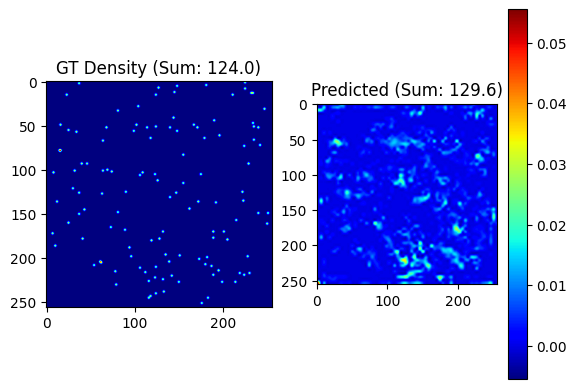

Epoch 32/35:
Train Loss: 0.305538, Val Loss: 0.210807, MAE: 10.44
124.73257446289062

 True count: 154.0, Predicted count: 130.8


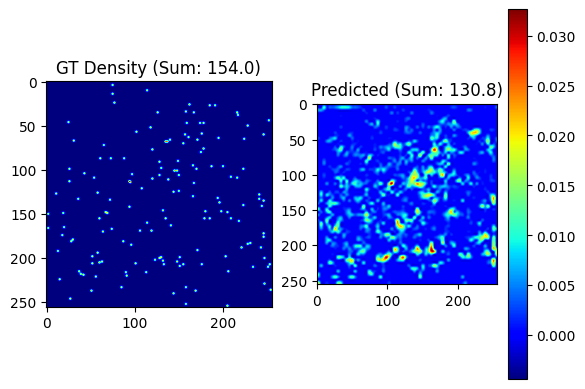

Epoch 33/35:
Train Loss: 0.236696, Val Loss: 0.264437, MAE: 14.66
101.48860931396484

 True count: 154.0, Predicted count: 126.7


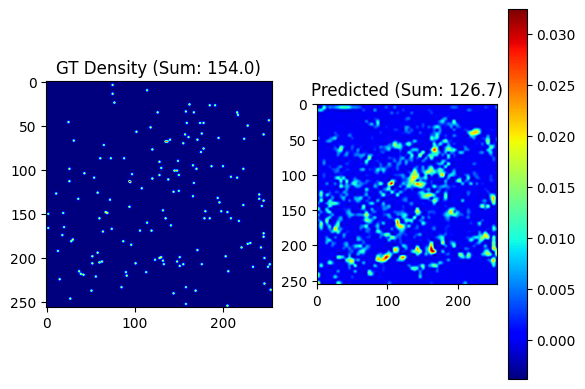

Epoch 34/35:
Train Loss: 0.408749, Val Loss: 0.369845, MAE: 16.19
67.03641510009766

 True count: 98.0, Predicted count: 98.8


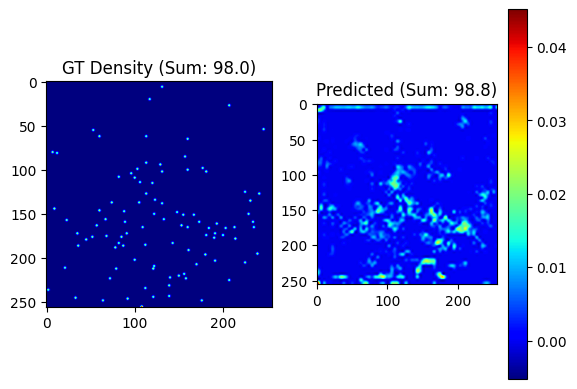

Epoch 35/35:
Train Loss: 0.282477, Val Loss: 0.151977, MAE: 10.64


In [21]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = UNetCellCounter().to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-4)
criterion = nn.MSELoss()  # L2 loss for density map regression
train_losses, val_losses = train_unet(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    optimizer=optimizer,
    criterion=mse_with_count_regularization,
    device=device,
    num_epochs=35
)

Expeiment 4: Adam, lr 1e-4, weight_decay 1e-4, sigma - 1, bicubic with pretrained weights resnet 34, rotation to image and desity maps (same angle) with 1/4 transformation

1414.5478515625

 True count: 273.0, Predicted count: 24.0


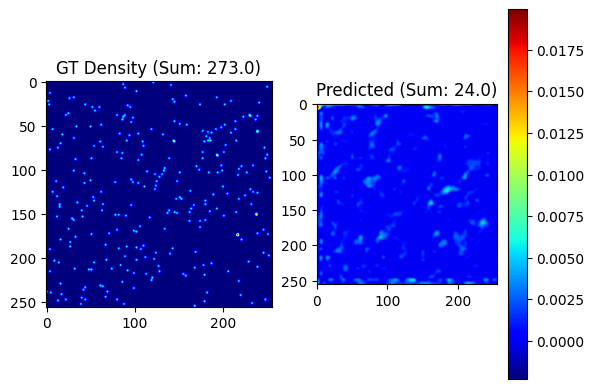

Epoch 1/30:
Train Loss: 141.201553, Val Loss: 26.313433, MAE: 156.02
Model saved with Val Loss: 26.3134
393.6385192871094

 True count: 86.0, Predicted count: 63.0


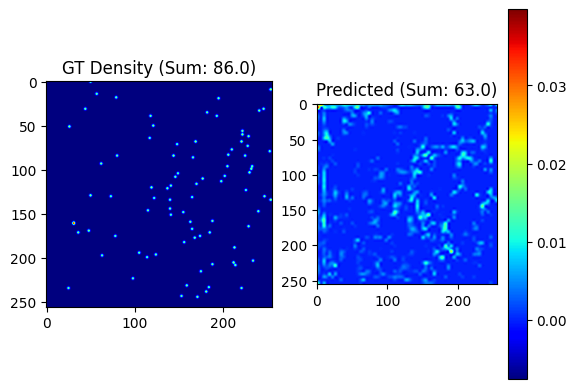

Epoch 2/30:
Train Loss: 2.932924, Val Loss: 2.202405, MAE: 43.58
Model saved with Val Loss: 2.2024
258.38946533203125

 True count: 86.0, Predicted count: 87.2


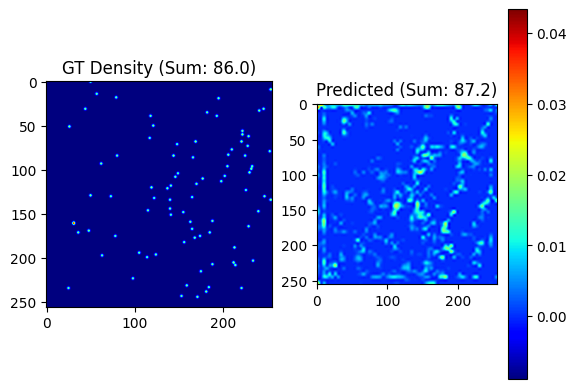

Epoch 3/30:
Train Loss: 1.421765, Val Loss: 1.394781, MAE: 29.96
Model saved with Val Loss: 1.3948
200.7299041748047

 True count: 248.0, Predicted count: 197.1


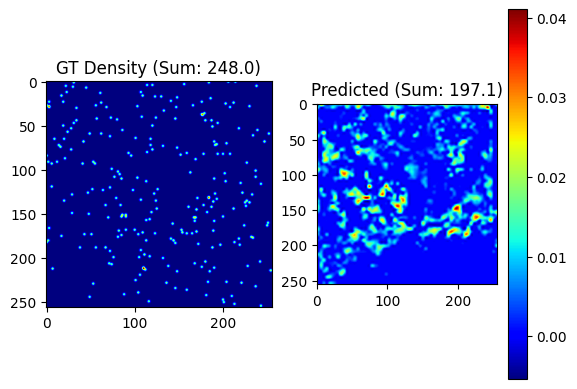

Epoch 4/30:
Train Loss: 1.154058, Val Loss: 0.773428, MAE: 23.13
Model saved with Val Loss: 0.7734
164.10638427734375

 True count: 218.0, Predicted count: 196.7


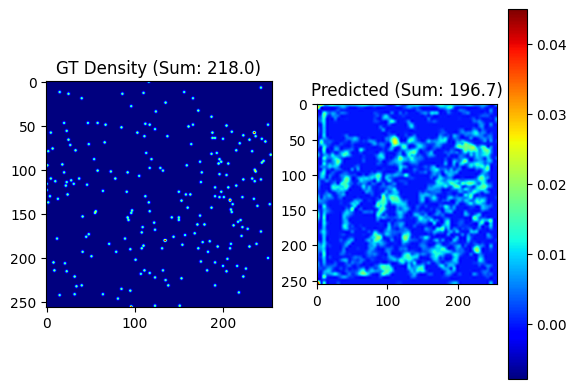

Epoch 5/30:
Train Loss: 0.857032, Val Loss: 0.441731, MAE: 17.29
Model saved with Val Loss: 0.4417
166.297607421875

 True count: 156.0, Predicted count: 195.3


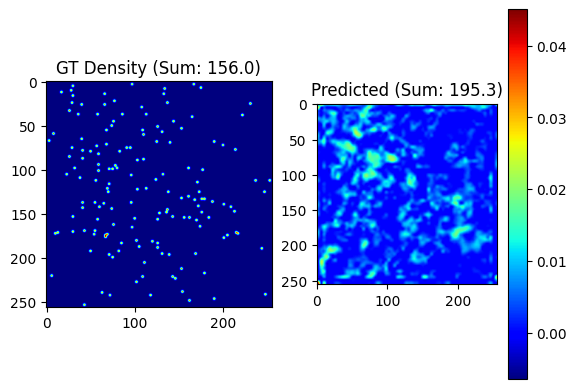

Epoch 6/30:
Train Loss: 0.727137, Val Loss: 0.429538, MAE: 17.19
Model saved with Val Loss: 0.4295
87.71735382080078

 True count: 292.0, Predicted count: 282.1


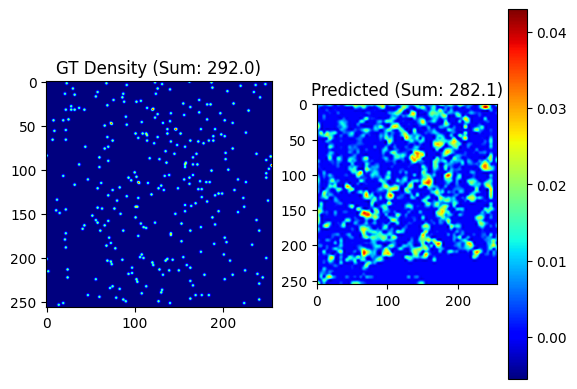

Epoch 7/30:
Train Loss: 1.041786, Val Loss: 0.290917, MAE: 12.50
Model saved with Val Loss: 0.2909
97.96914672851562

 True count: 98.0, Predicted count: 119.5


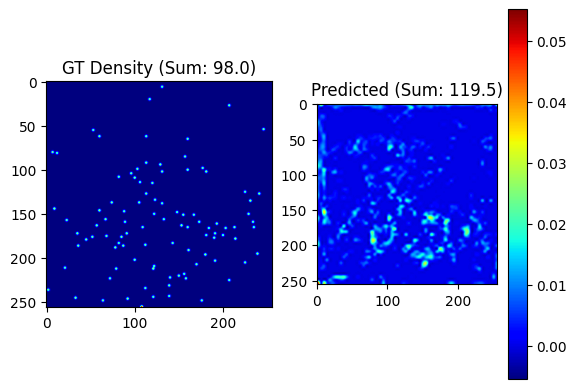

Epoch 8/30:
Train Loss: 0.798022, Val Loss: 0.162845, MAE: 10.21
Model saved with Val Loss: 0.1628
136.0264892578125

 True count: 292.0, Predicted count: 302.0


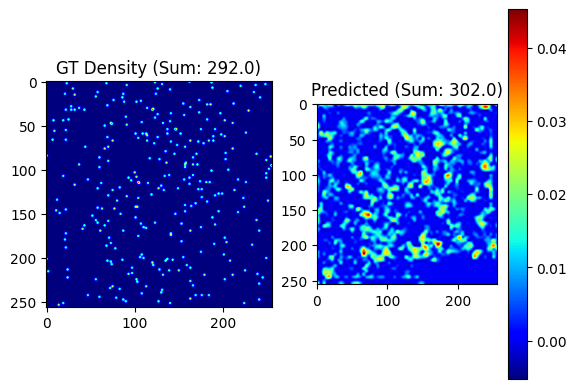

Epoch 9/30:
Train Loss: 0.914472, Val Loss: 0.506535, MAE: 20.10
148.52899169921875

 True count: 153.0, Predicted count: 145.2


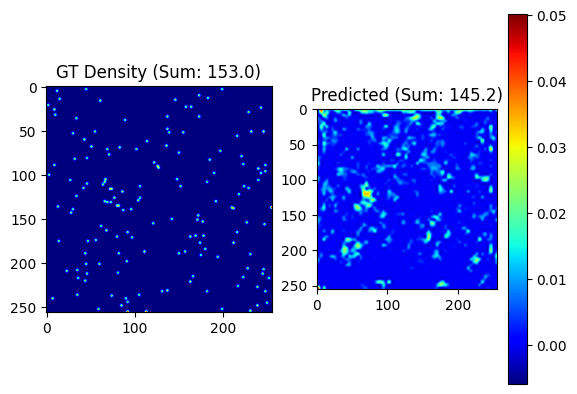

Epoch 10/30:
Train Loss: 0.473987, Val Loss: 0.550610, MAE: 19.15
131.24266052246094

 True count: 248.0, Predicted count: 248.1


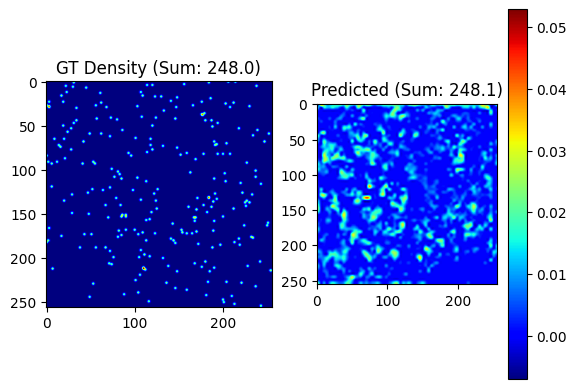

Epoch 11/30:
Train Loss: 0.956938, Val Loss: 0.312392, MAE: 12.97
101.00558471679688

 True count: 244.0, Predicted count: 239.3


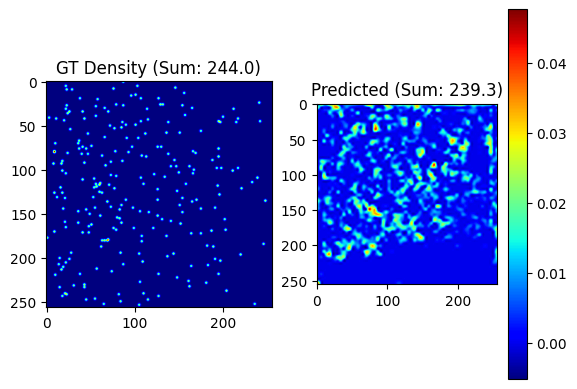

Epoch 12/30:
Train Loss: 0.832890, Val Loss: 0.349593, MAE: 14.14
114.70796966552734

 True count: 156.0, Predicted count: 180.7


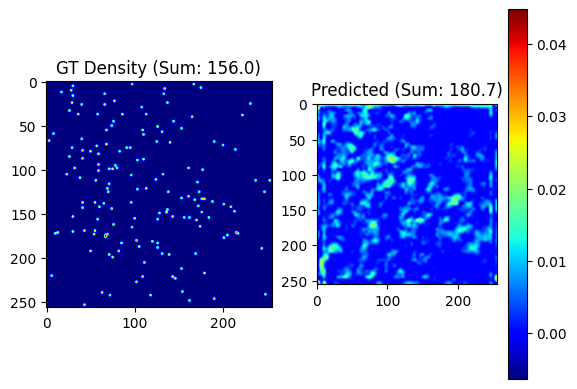

Epoch 13/30:
Train Loss: 0.646856, Val Loss: 0.218992, MAE: 11.89
138.95501708984375

 True count: 124.0, Predicted count: 102.5


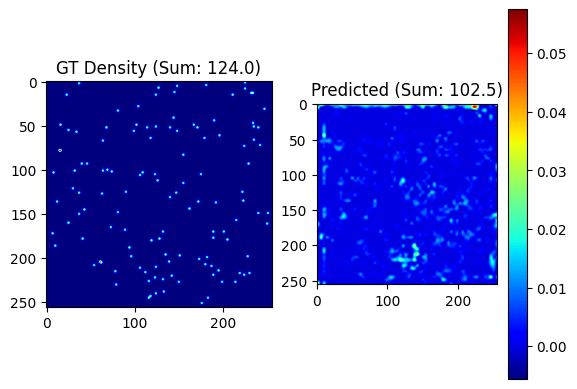

Epoch 14/30:
Train Loss: 0.566500, Val Loss: 0.452094, MAE: 17.95
148.14505004882812

 True count: 218.0, Predicted count: 212.3


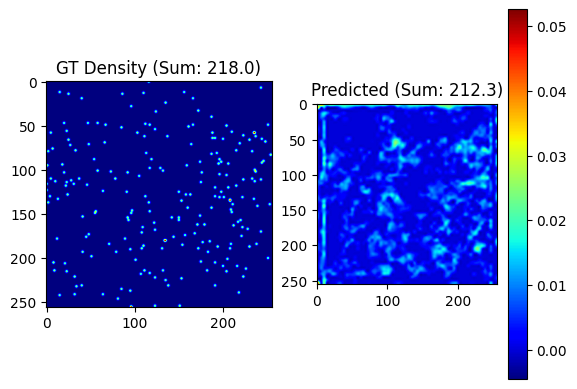

Epoch 15/30:
Train Loss: 0.538426, Val Loss: 0.287221, MAE: 14.41
99.64466094970703

 True count: 153.0, Predicted count: 135.7


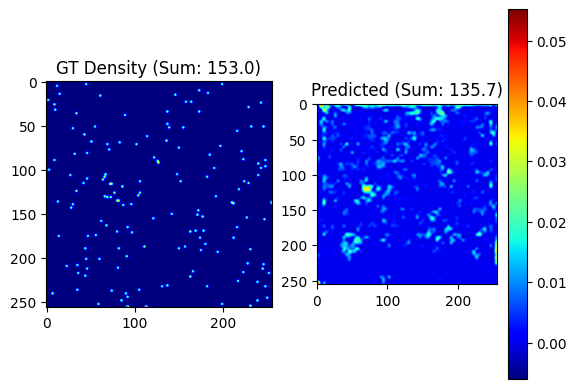

Epoch 16/30:
Train Loss: 0.493171, Val Loss: 0.309832, MAE: 12.63
210.2181396484375

 True count: 200.0, Predicted count: 191.3


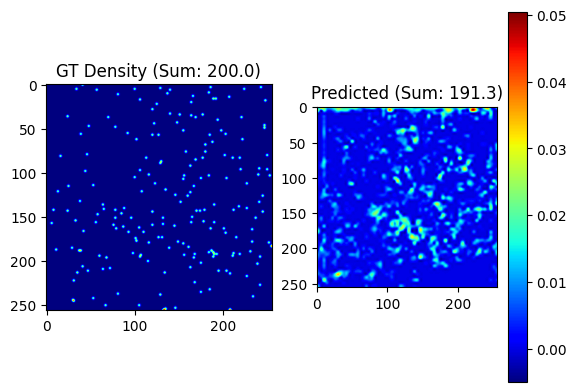

Epoch 17/30:
Train Loss: 0.470925, Val Loss: 0.693582, MAE: 23.39
93.78665161132812

 True count: 124.0, Predicted count: 105.8


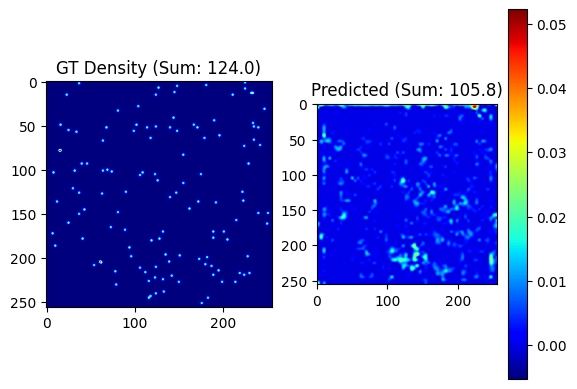

Epoch 18/30:
Train Loss: 0.457064, Val Loss: 0.342759, MAE: 12.42
135.44088745117188

 True count: 218.0, Predicted count: 193.4


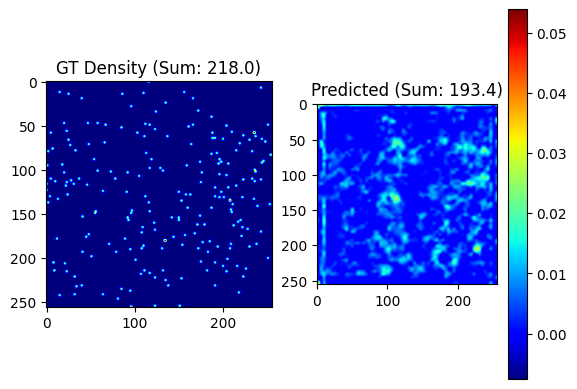

Epoch 19/30:
Train Loss: 0.336241, Val Loss: 0.252497, MAE: 13.37
158.92935180664062

 True count: 79.0, Predicted count: 76.6


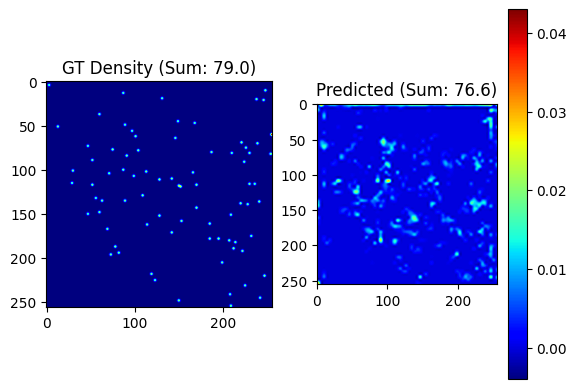

Epoch 20/30:
Train Loss: 0.383069, Val Loss: 0.781691, MAE: 22.73
117.15071105957031

 True count: 98.0, Predicted count: 120.2


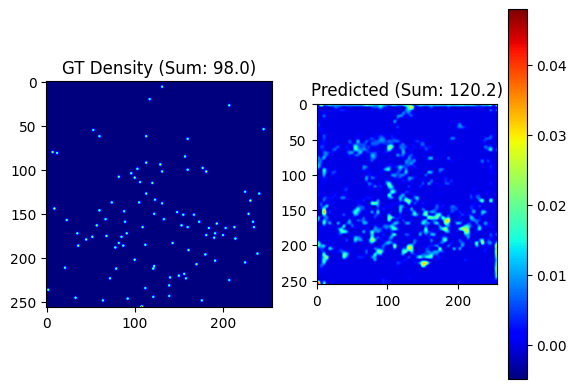

Epoch 21/30:
Train Loss: 0.482867, Val Loss: 0.282657, MAE: 13.93
109.73249053955078

 True count: 124.0, Predicted count: 118.2


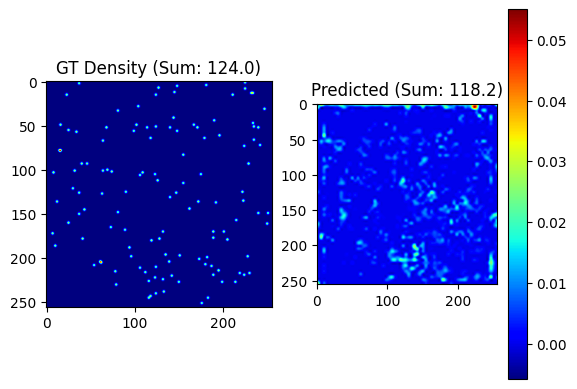

Epoch 22/30:
Train Loss: 0.367471, Val Loss: 0.194824, MAE: 10.52
300.9288024902344

 True count: 84.0, Predicted count: 114.3


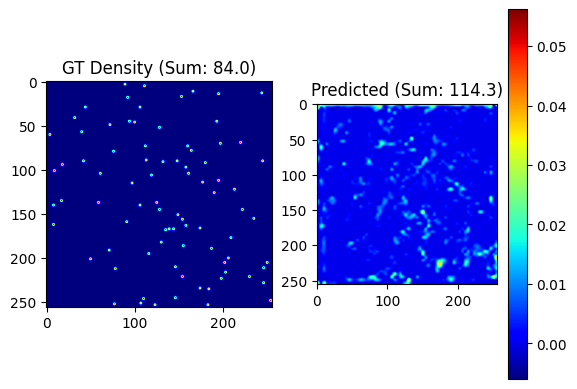

Epoch 23/30:
Train Loss: 0.418521, Val Loss: 1.565904, MAE: 36.90
120.4732666015625

 True count: 224.0, Predicted count: 212.3


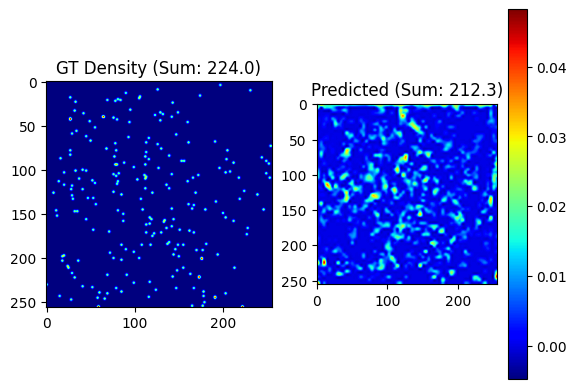

Epoch 24/30:
Train Loss: 0.445453, Val Loss: 0.337956, MAE: 13.40
159.47250366210938

 True count: 244.0, Predicted count: 255.9


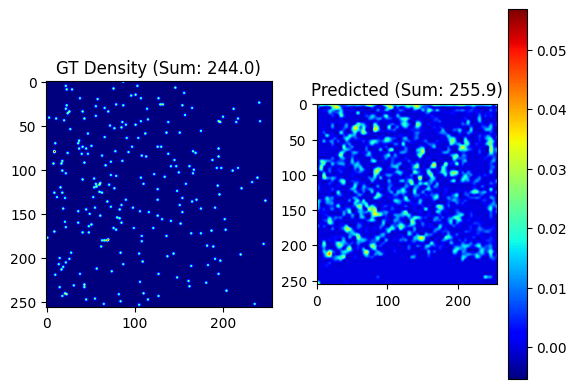

Epoch 25/30:
Train Loss: 0.750945, Val Loss: 0.405073, MAE: 14.31
104.6488265991211

 True count: 200.0, Predicted count: 215.7


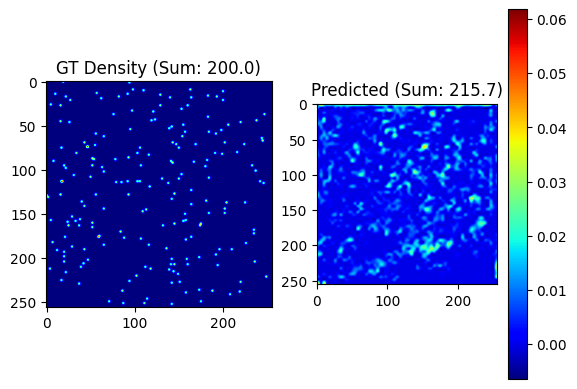

Epoch 26/30:
Train Loss: 0.371654, Val Loss: 0.383814, MAE: 16.75
141.22494506835938

 True count: 273.0, Predicted count: 239.3


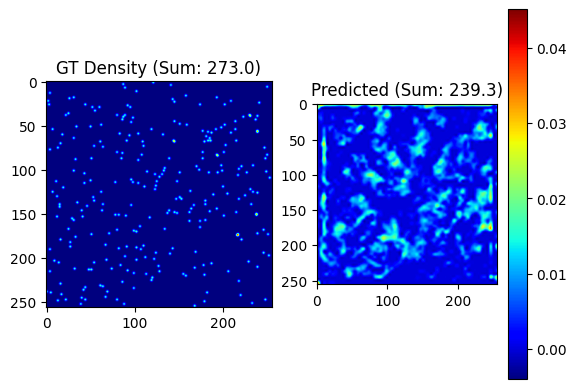

Epoch 27/30:
Train Loss: 0.543804, Val Loss: 0.386585, MAE: 17.14
71.94583129882812

 True count: 200.0, Predicted count: 225.8


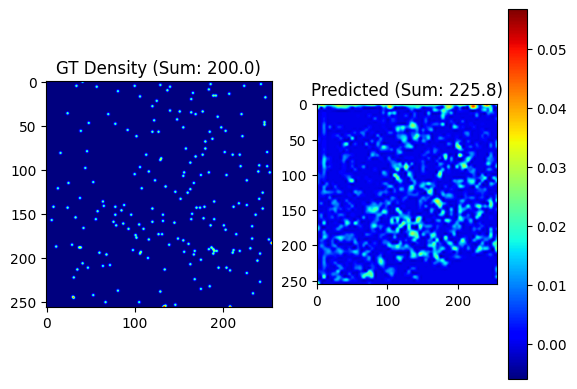

Epoch 28/30:
Train Loss: 0.275674, Val Loss: 0.190907, MAE: 10.13
117.48107147216797

 True count: 248.0, Predicted count: 236.9


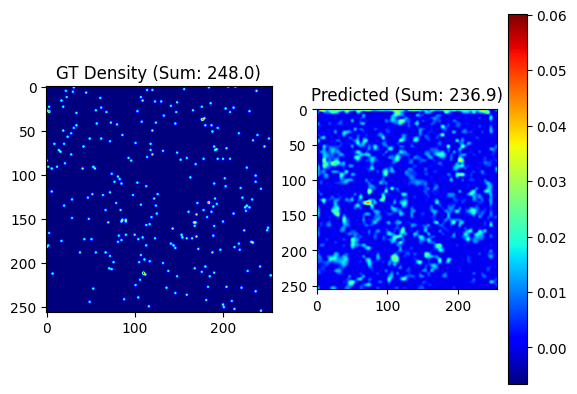

Epoch 29/30:
Train Loss: 0.357290, Val Loss: 0.264959, MAE: 11.93
99.8660659790039

 True count: 153.0, Predicted count: 135.6


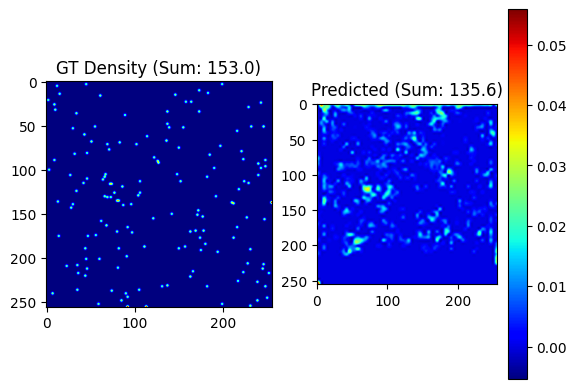

Epoch 30/30:
Train Loss: 0.333590, Val Loss: 0.303950, MAE: 14.31


In [28]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = UNetCellCounter().to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-4)
criterion = nn.MSELoss()  # L2 loss for density map regression
train_losses, val_losses = train_unet(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    optimizer=optimizer,
    criterion=mse_with_count_regularization,
    device=device,
    num_epochs=30
)

Expeiment 4: Adam, lr 1e-4, weight_decay 1e-4, sigma - 2, bicubic with pretrained weights resnet 34, rotation to image and desity maps (same angle) with 1/4 transformation

1245.025146484375

 True count: 132.0, Predicted count: 25.4


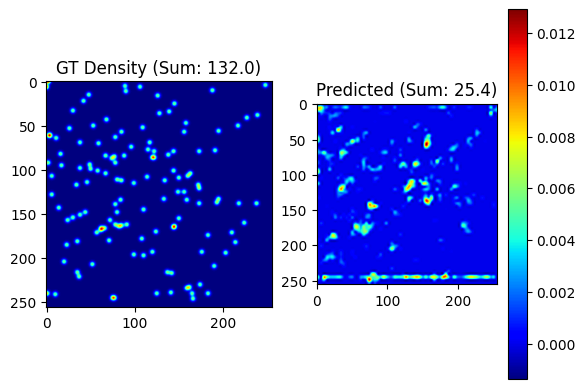

Epoch 1/35:
Train Loss: 33.546228, Val Loss: 23.222562, MAE: 147.76
Model saved with Val Loss: 23.2226
198.87158203125

 True count: 248.0, Predicted count: 293.4


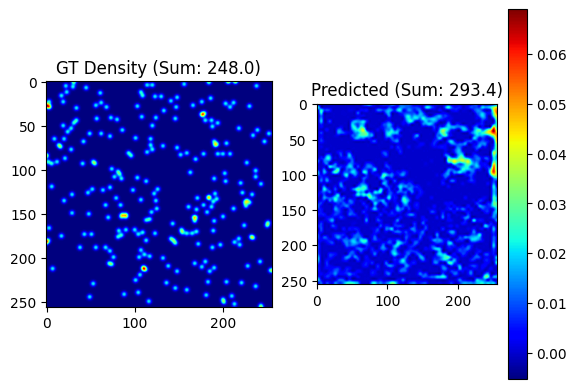

Epoch 2/35:
Train Loss: 3.008559, Val Loss: 2.575018, MAE: 32.03
Model saved with Val Loss: 2.5750
228.71914672851562

 True count: 200.0, Predicted count: 172.5


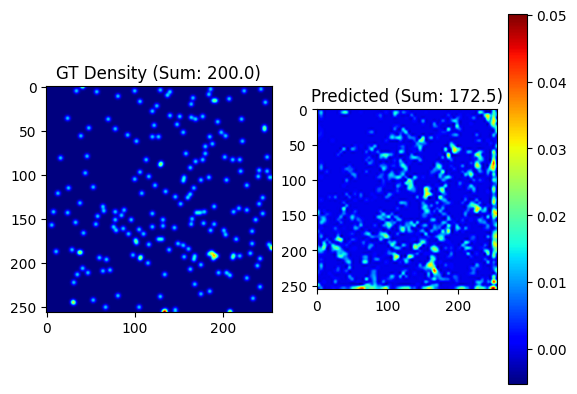

Epoch 3/35:
Train Loss: 1.378664, Val Loss: 2.029359, MAE: 30.59
Model saved with Val Loss: 2.0294
158.10939025878906

 True count: 273.0, Predicted count: 213.4


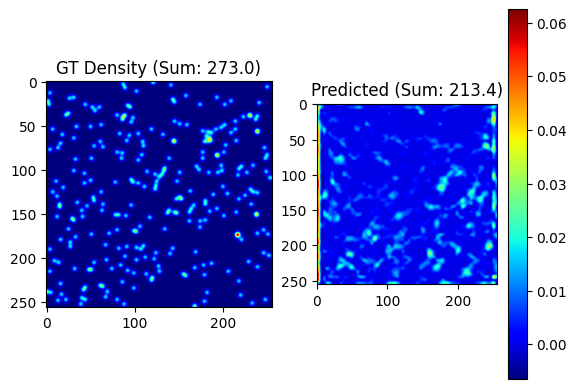

Epoch 4/35:
Train Loss: 1.619377, Val Loss: 0.983623, MAE: 24.23
Model saved with Val Loss: 0.9836
128.1803436279297

 True count: 200.0, Predicted count: 197.7


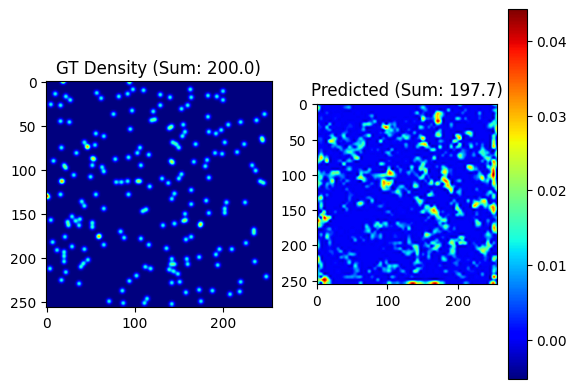

Epoch 5/35:
Train Loss: 0.887661, Val Loss: 0.891563, MAE: 22.16
Model saved with Val Loss: 0.8916
181.07962036132812

 True count: 292.0, Predicted count: 376.9


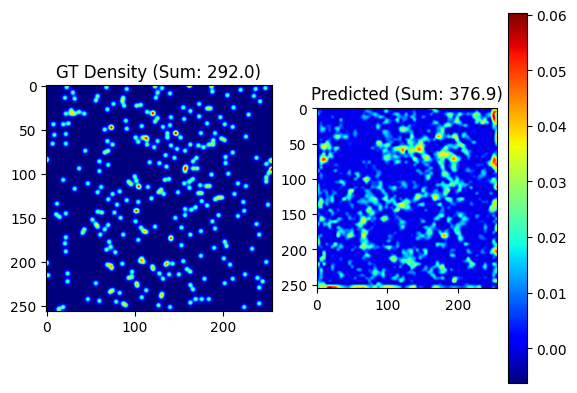

Epoch 6/35:
Train Loss: 0.854866, Val Loss: 1.182990, MAE: 26.69
171.9978485107422

 True count: 218.0, Predicted count: 201.5


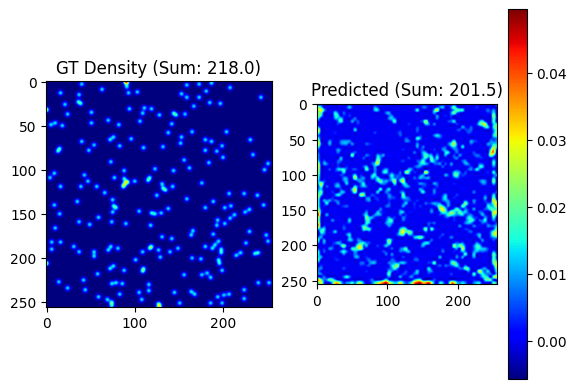

Epoch 7/35:
Train Loss: 0.878276, Val Loss: 0.864797, MAE: 21.39
Model saved with Val Loss: 0.8648
116.45610809326172

 True count: 292.0, Predicted count: 300.8


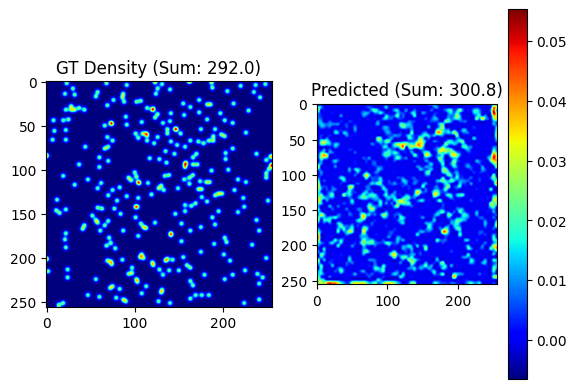

Epoch 8/35:
Train Loss: 0.922885, Val Loss: 0.551562, MAE: 19.37
Model saved with Val Loss: 0.5516
77.2804946899414

 True count: 153.0, Predicted count: 136.2


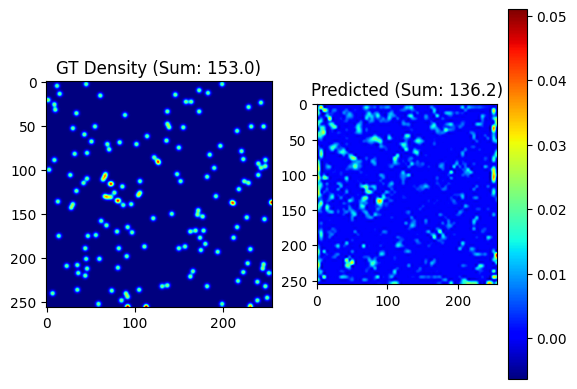

Epoch 9/35:
Train Loss: 0.554991, Val Loss: 0.457968, MAE: 16.23
Model saved with Val Loss: 0.4580
101.13219451904297

 True count: 79.0, Predicted count: 93.1


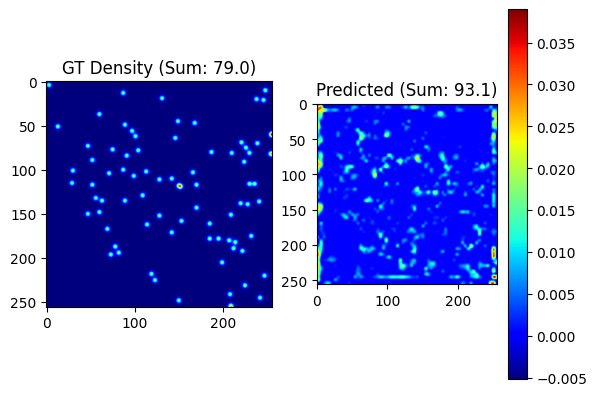

Epoch 10/35:
Train Loss: 0.540358, Val Loss: 0.232304, MAE: 12.48
Model saved with Val Loss: 0.2323
249.66700744628906

 True count: 128.0, Predicted count: 92.8


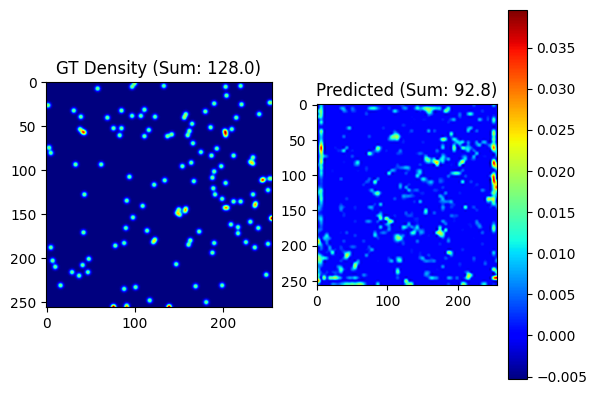

Epoch 11/35:
Train Loss: 0.674851, Val Loss: 1.742976, MAE: 34.85
276.578125

 True count: 273.0, Predicted count: 209.0


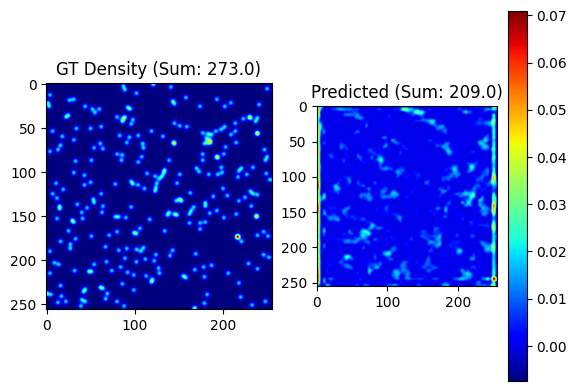

Epoch 12/35:
Train Loss: 0.990617, Val Loss: 1.278150, MAE: 29.62
142.981689453125

 True count: 200.0, Predicted count: 169.7


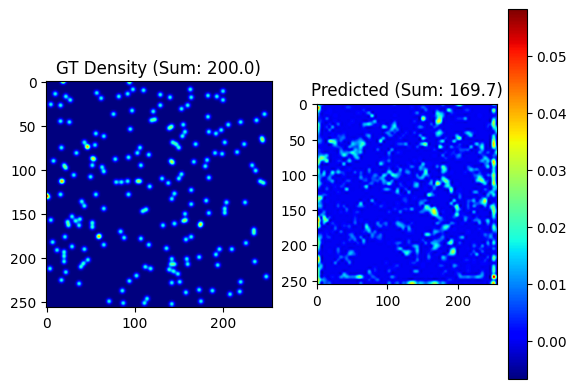

Epoch 13/35:
Train Loss: 0.873139, Val Loss: 0.931131, MAE: 26.97
136.55296325683594

 True count: 154.0, Predicted count: 144.8


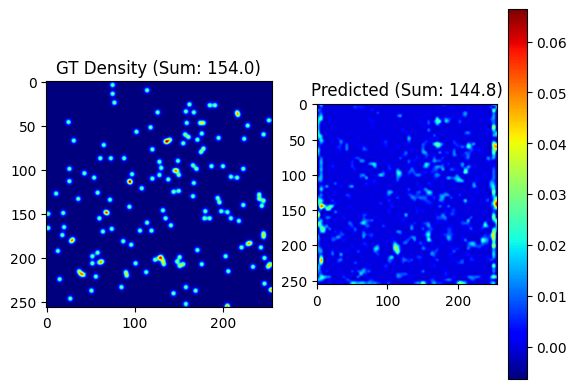

Epoch 14/35:
Train Loss: 0.713414, Val Loss: 0.813393, MAE: 22.09
64.52095794677734

 True count: 132.0, Predicted count: 131.6


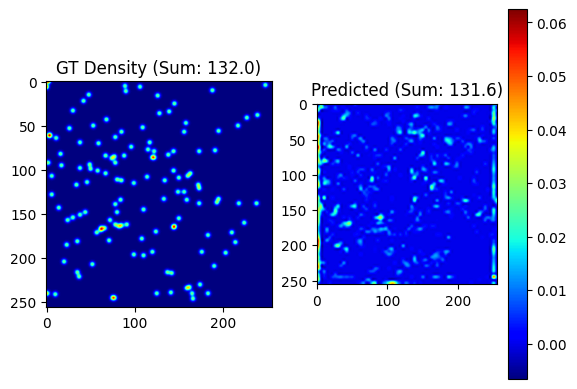

Epoch 15/35:
Train Loss: 0.490013, Val Loss: 0.170923, MAE: 10.49
Model saved with Val Loss: 0.1709
97.6354751586914

 True count: 79.0, Predicted count: 81.7


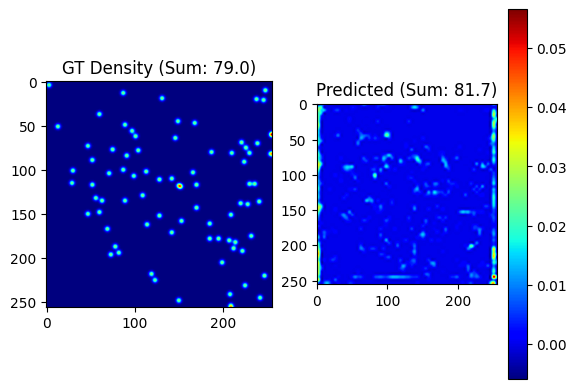

Epoch 16/35:
Train Loss: 0.532515, Val Loss: 0.359885, MAE: 15.12
163.95486450195312

 True count: 98.0, Predicted count: 114.0


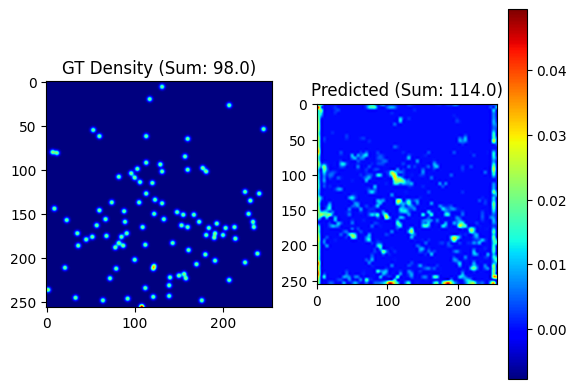

Epoch 17/35:
Train Loss: 0.633055, Val Loss: 0.644787, MAE: 19.23
77.837890625

 True count: 79.0, Predicted count: 91.2


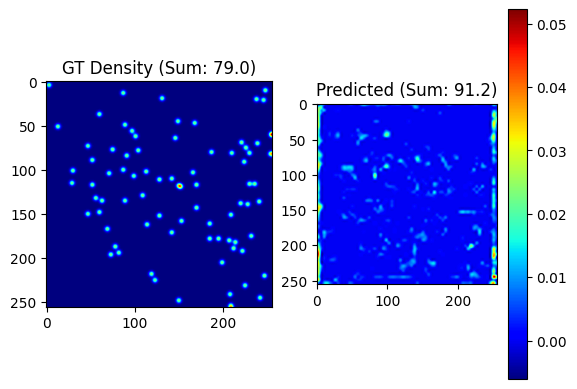

Epoch 18/35:
Train Loss: 0.367126, Val Loss: 0.211078, MAE: 11.56
109.57157135009766

 True count: 95.0, Predicted count: 120.5


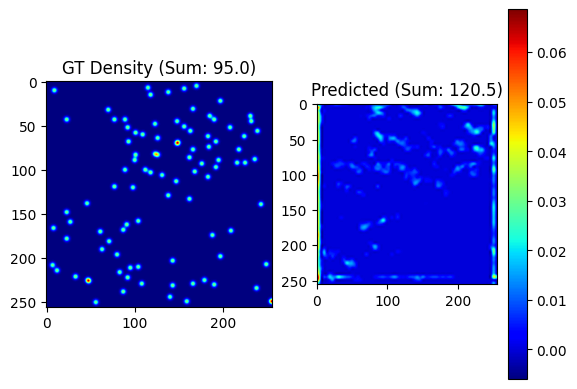

Epoch 19/35:
Train Loss: 0.377248, Val Loss: 0.226747, MAE: 12.38
67.62433624267578

 True count: 200.0, Predicted count: 218.9


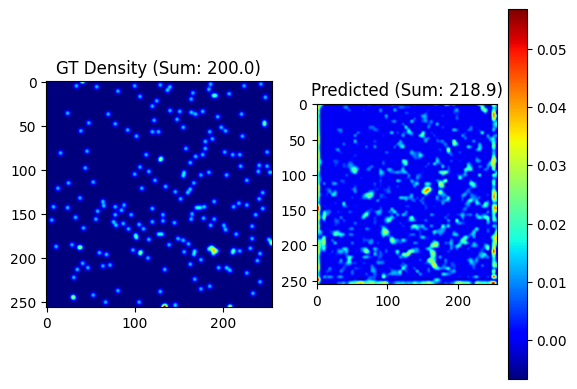

Epoch 20/35:
Train Loss: 0.358219, Val Loss: 0.128973, MAE: 9.07
Model saved with Val Loss: 0.1290
101.29267883300781

 True count: 273.0, Predicted count: 234.1


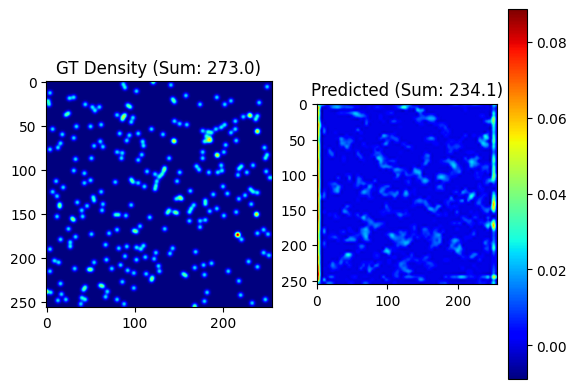

Epoch 21/35:
Train Loss: 0.328157, Val Loss: 0.426512, MAE: 16.26
82.99583435058594

 True count: 292.0, Predicted count: 282.7


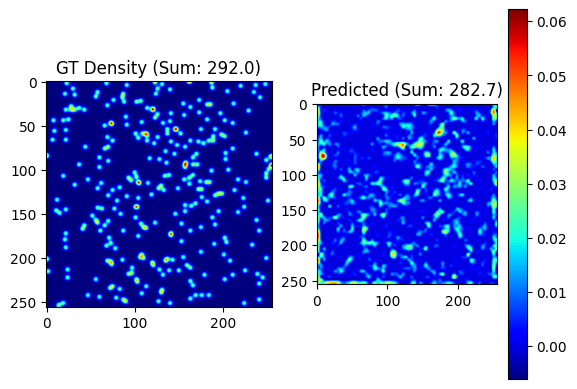

Epoch 22/35:
Train Loss: 0.505908, Val Loss: 0.231462, MAE: 13.15
88.64248657226562

 True count: 154.0, Predicted count: 176.0


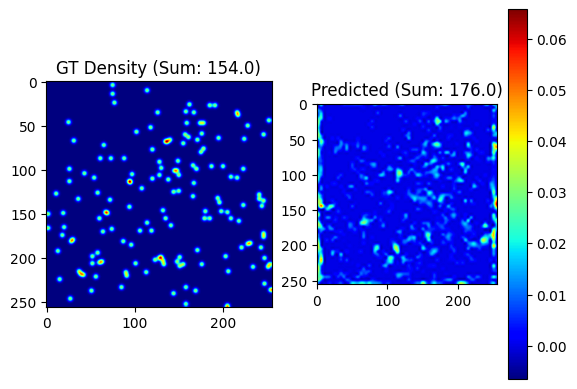

Epoch 23/35:
Train Loss: 0.394357, Val Loss: 0.182852, MAE: 10.70
171.18202209472656

 True count: 86.0, Predicted count: 87.2


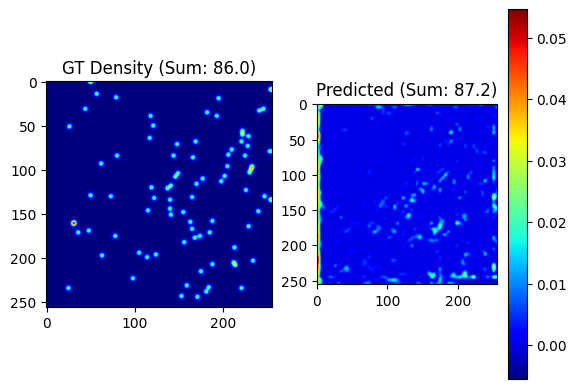

Epoch 24/35:
Train Loss: 0.411053, Val Loss: 0.644738, MAE: 17.68
94.6566390991211

 True count: 224.0, Predicted count: 229.0


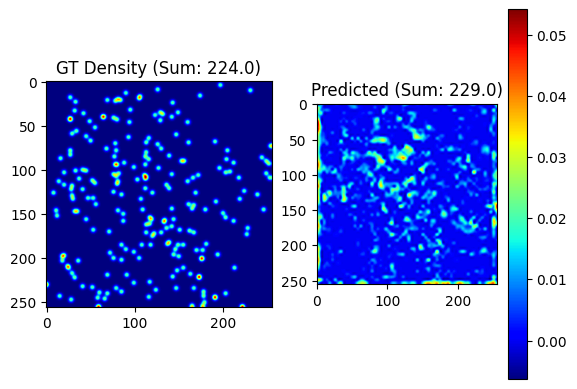

Epoch 25/35:
Train Loss: 0.365007, Val Loss: 0.378165, MAE: 14.77
82.82316589355469

 True count: 156.0, Predicted count: 192.3


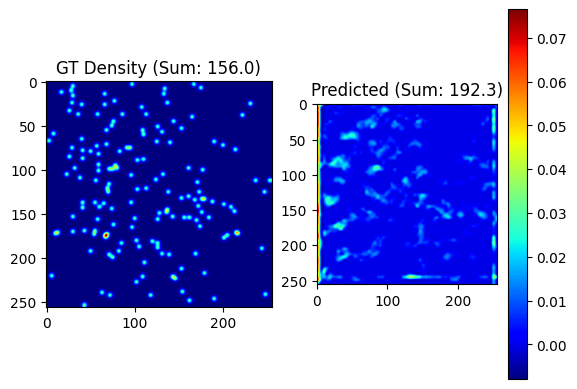

Epoch 26/35:
Train Loss: 0.302378, Val Loss: 0.183007, MAE: 10.28
147.77505493164062

 True count: 98.0, Predicted count: 122.6


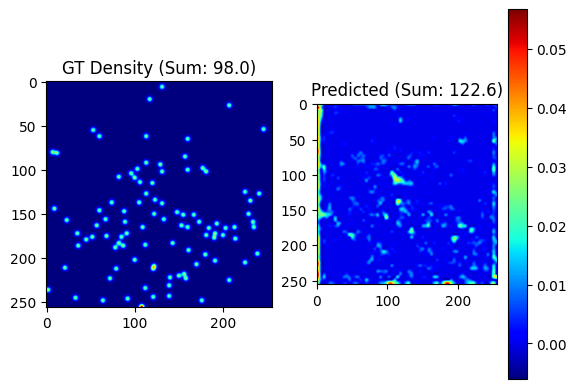

Epoch 27/35:
Train Loss: 0.338457, Val Loss: 0.397811, MAE: 16.84
170.48245239257812

 True count: 200.0, Predicted count: 185.5


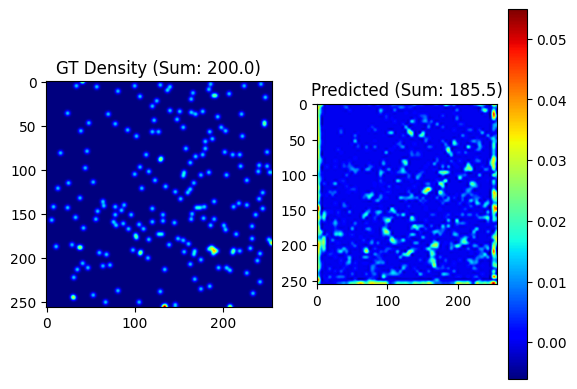

Epoch 28/35:
Train Loss: 0.398157, Val Loss: 0.647740, MAE: 20.45
155.16049194335938

 True count: 248.0, Predicted count: 210.0


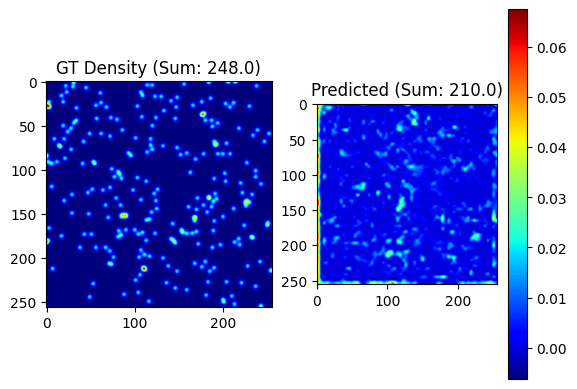

Epoch 29/35:
Train Loss: 0.345036, Val Loss: 0.443641, MAE: 16.57
151.86038208007812

 True count: 244.0, Predicted count: 265.2


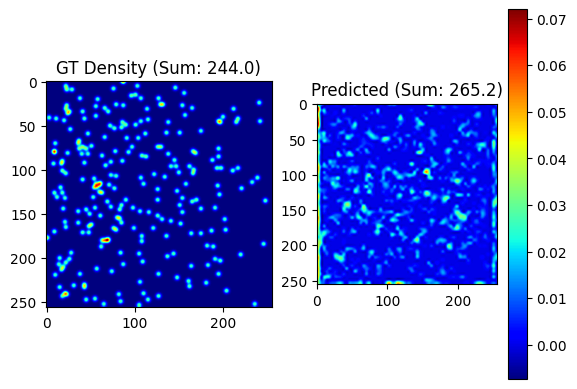

Epoch 30/35:
Train Loss: 0.291472, Val Loss: 0.358061, MAE: 13.99
99.62793731689453

 True count: 224.0, Predicted count: 198.2


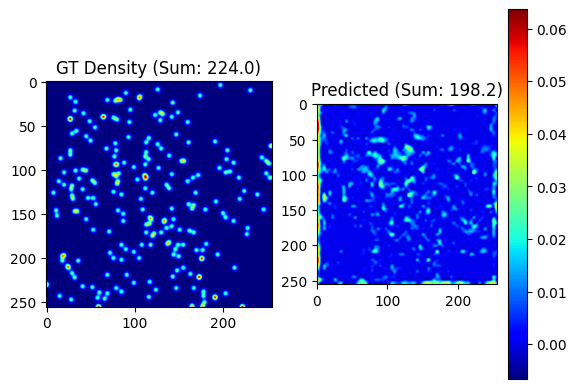

Epoch 31/35:
Train Loss: 0.328701, Val Loss: 0.169481, MAE: 10.32
94.91169738769531

 True count: 132.0, Predicted count: 137.2


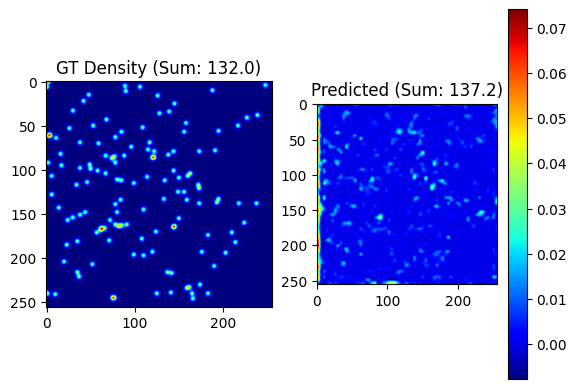

Epoch 32/35:
Train Loss: 0.278484, Val Loss: 0.264215, MAE: 12.81
42.31219482421875

 True count: 154.0, Predicted count: 162.8


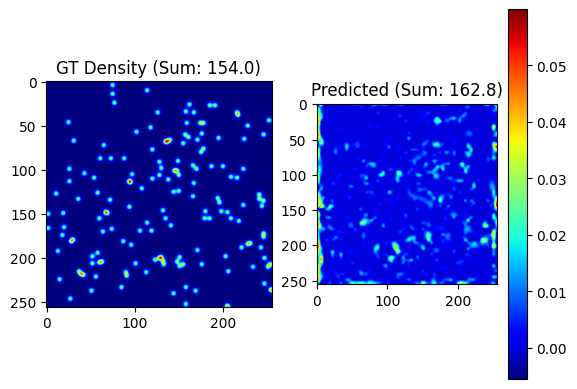

Epoch 33/35:
Train Loss: 0.228638, Val Loss: 0.117064, MAE: 8.49
Model saved with Val Loss: 0.1171
99.48546600341797

 True count: 224.0, Predicted count: 214.5


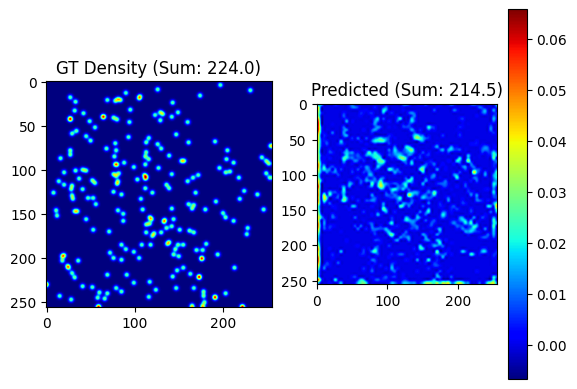

Epoch 34/35:
Train Loss: 0.227840, Val Loss: 0.237616, MAE: 10.94
50.366844177246094

 True count: 98.0, Predicted count: 114.7


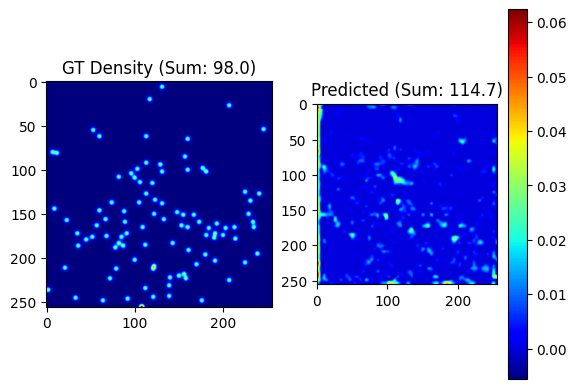

Epoch 35/35:
Train Loss: 0.208237, Val Loss: 0.147906, MAE: 9.34


In [31]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = UNetCellCounter().to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-4)
criterion = nn.MSELoss()  # L2 loss for density map regression
train_losses, val_losses = train_unet(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    optimizer=optimizer,
    criterion=mse_with_count_regularization,
    device=device,
    num_epochs=35
)

Expeiment 4: Adam, lr 1e-3, weight_decay 1e-4, sigma - 2, bicubic with pretrained weights efficientnet using smp, rotation to image and desity maps (same angle) with 1/4 transformation

In [22]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = UNetCellCounterEffNet().to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-3, weight_decay=1e-4)
criterion = nn.MSELoss()  # L2 loss for density map regression
train_losses, val_losses = train_unet(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    optimizer=optimizer,
    criterion=mse_with_count_regularization,
    device=device,
    num_epochs=50
)

Epoch 1/50:
Train Loss: 37633.935932, Val Loss: 36.127906, MAE: 170.19
Model saved with Val Loss: 36.1279
Epoch 2/50:
Train Loss: 5.612715, Val Loss: 25.758639, MAE: 148.54
Model saved with Val Loss: 25.7586
Epoch 3/50:
Train Loss: 3.887341, Val Loss: 26.685029, MAE: 143.52
Epoch 4/50:
Train Loss: 2.908048, Val Loss: 21.842751, MAE: 140.78
Model saved with Val Loss: 21.8428
Epoch 5/50:
Train Loss: 3.072861, Val Loss: 18.054666, MAE: 121.23
Model saved with Val Loss: 18.0547
Epoch 6/50:
Train Loss: 3.136640, Val Loss: 23.319837, MAE: 134.44
Epoch 7/50:
Train Loss: 2.567871, Val Loss: 32.754322, MAE: 139.22
Epoch 8/50:
Train Loss: 2.465764, Val Loss: 30.679926, MAE: 137.35
Epoch 9/50:
Train Loss: 2.432068, Val Loss: 35.274714, MAE: 139.99
Epoch 10/50:
Train Loss: 1.786111, Val Loss: 34.342458, MAE: 131.28
Epoch 11/50:
Train Loss: 2.056356, Val Loss: 31.065841, MAE: 124.77
Epoch 12/50:
Train Loss: 2.414356, Val Loss: 33.409310, MAE: 126.67
Epoch 13/50:
Train Loss: 1.998163, Val Loss: 34.5

Expeiment 4: Adam, lr 1e-3, weight_decay 5e-5, sigma - 2, bicubic with pretrained weights efficientnet using smp, rotation to image and desity maps (same angle) with 1/4 transformation

In [23]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = UNetCellCounterEffNet().to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=1e-3, weight_decay=5e-5)
criterion = nn.MSELoss()  # L2 loss for density map regression
train_losses, val_losses = train_unet(
    model=model,
    train_loader=train_loader,
    val_loader=val_loader,
    optimizer=optimizer,
    criterion=mse_with_count_regularization,
    device=device,
    num_epochs=50
)

Epoch 1/50:
Train Loss: 22131.912719, Val Loss: 31.244338, MAE: 169.91
Model saved with Val Loss: 31.2443
Epoch 2/50:
Train Loss: 34.682108, Val Loss: 32.335437, MAE: 170.30
Epoch 3/50:
Train Loss: 34.391331, Val Loss: 30.548059, MAE: 170.30
Model saved with Val Loss: 30.5481
Epoch 4/50:
Train Loss: 34.929797, Val Loss: 31.531986, MAE: 170.30
Epoch 5/50:
Train Loss: 34.902666, Val Loss: 33.334155, MAE: 170.29
Epoch 6/50:
Train Loss: 34.624311, Val Loss: 33.981914, MAE: 170.27
Epoch 7/50:
Train Loss: 34.448658, Val Loss: 36.970256, MAE: 170.24
Epoch 8/50:
Train Loss: 34.668853, Val Loss: 30.646336, MAE: 170.23
Epoch 9/50:
Train Loss: 34.563914, Val Loss: 31.480733, MAE: 170.17
Epoch 10/50:
Train Loss: 34.205385, Val Loss: 33.049306, MAE: 170.07
Epoch 11/50:
Train Loss: 34.515156, Val Loss: 32.234886, MAE: 170.00
Epoch 12/50:
Train Loss: 34.974133, Val Loss: 33.806769, MAE: 169.93
Epoch 13/50:
Train Loss: 34.814563, Val Loss: 32.284564, MAE: 169.88
Epoch 14/50:
Train Loss: 34.434450, Val